In [21]:
import osmnx as ox
ox.config(use_cache=True, log_console=True)

import pickle # Using this option to make sure we can open pickled dataframes back
pickle.HIGHEST_PROTOCOL = 4

import pandas as pd
import geopandas as gpd
import fiona 

import os

In [22]:
gpd.__version__,pd.__version__

('0.9.0', '1.1.5')

In [23]:
def saveGraph(G,name):
    with open('data/'+name+'.pkl', 'wb') as output: 
        pickle.dump(G, output, pickle.HIGHEST_PROTOCOL)

# Arrondissement

/home/kelu/.local/lib/python3.6/site-packages/geopandas/geodataframe.py:577: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


[ 2.32559016 48.8466125   2.41643101 48.90216191]



<AxesSubplot:>

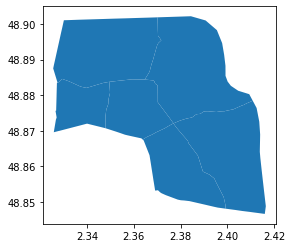

In [24]:
districts = "data/data_original/arrondissements.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
gdf = gpd.read_file(districts, driver='KML')
targets = [str(750000000 + x) for x in [9,18,19,20,10,11]]
df = gdf[gdf.Name.isin(targets)]
saveGraph(df,"district")
zoi = df.geometry.unary_union
saveGraph(zoi,"zoi")
[west, south, east, north] = df.total_bounds
print( df.total_bounds )
print()
df.plot()

In [25]:
df.total_bounds

array([ 2.32559016, 48.8466125 ,  2.41643101, 48.90216191])

Data loaded. Displaying routes


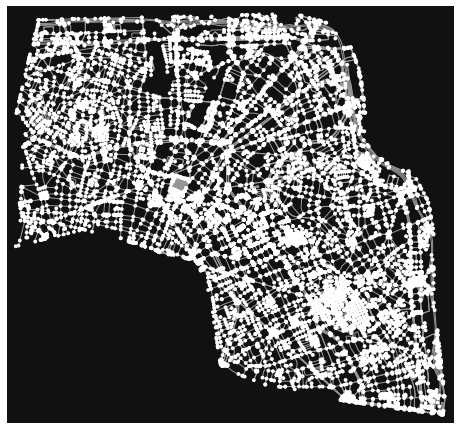

In [26]:
# create network from that bounding box
if not os.path.isfile('./data/G2.pkl'):
    print("Creating the cache")
    G2 = ox.graph_from_polygon(zoi, network_type='all')
    #G2 = ox.graph_from_bbox(north, south, east, west, network_type='all')
    G2 = ox.project_graph(G2)
    saveGraph(G2,"G2")
else:
    with open('./data/G2.pkl', 'rb') as input:
        G2 = pickle.load(input)
print("Data loaded. Displaying routes")
fig, ax = ox.plot_graph(G2)



In [27]:
with open('./data/G2_consolides.pkl', 'rb') as input:
    G3 = pickle.load(input)

/home/kelu/.local/lib/python3.6/site-packages/osmnx/simplification.py:423: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  return gpd.GeoSeries(list(merged), crs=G.graph["crs"])
/home/kelu/.local/lib/python3.6/site-packages/osmnx/simplification.py:423: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  return gpd.GeoSeries(list(merged), crs=G.graph["crs"])


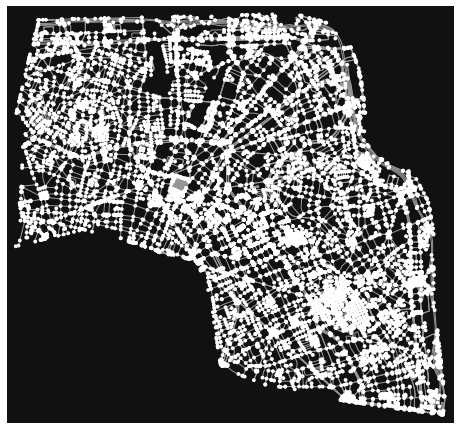

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [28]:
# Let's give it a clean
G3 = ox.consolidate_intersections(G2, tolerance=0.00001, rebuild_graph=True, dead_ends=True)
saveGraph(G3,"G2_consolides")
ox.plot_graph(G3)

# Buildings

In [29]:
districts = "data/data_original/volumesbatisparis.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
BATS = gpd.read_file(districts, driver='KML')
BATS

/home/kelu/.local/lib/python3.6/site-packages/geopandas/geodataframe.py:577: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


,Name,Description,geometry
0,V,,"POLYGON ((2.31924 48.84689, 2.31916 48.84685, ..."
1,V,,"POLYGON ((2.32076 48.84714, 2.32073 48.84713, ..."
2,V,,"POLYGON ((2.32002 48.84668, 2.32001 48.84668, ..."
3,V,,"POLYGON ((2.32144 48.84603, 2.32143 48.84603, ..."
4,V,,"POLYGON ((2.32273 48.84684, 2.32270 48.84683, ..."
...,...,...,...
359876,U,,"POLYGON ((2.33855 48.89765, 2.33844 48.89764, ..."
359877,V,,"POLYGON ((2.33755 48.89813, 2.33750 48.89811, ..."
359878,U,,"POLYGON ((2.33716 48.89762, 2.33710 48.89762, ..."
359879,V,,"POLYGON ((2.33864 48.89757, 2.33859 48.89756, ..."


In [31]:
BoI = BATS[BATS.within(zoi)]
BoI

,Name,Description,geometry
91,U,,"POLYGON ((2.34423 48.87400, 2.34422 48.87392, ..."
92,V,,"POLYGON ((2.34313 48.87392, 2.34309 48.87392, ..."
93,V,,"POLYGON ((2.34197 48.87401, 2.34193 48.87391, ..."
94,V,,"POLYGON ((2.34165 48.87382, 2.34164 48.87378, ..."
95,V,,"POLYGON ((2.34641 48.87261, 2.34641 48.87258, ..."
...,...,...,...
359876,U,,"POLYGON ((2.33855 48.89765, 2.33844 48.89764, ..."
359877,V,,"POLYGON ((2.33755 48.89813, 2.33750 48.89811, ..."
359878,U,,"POLYGON ((2.33716 48.89762, 2.33710 48.89762, ..."
359879,V,,"POLYGON ((2.33864 48.89757, 2.33859 48.89756, ..."


<AxesSubplot:>

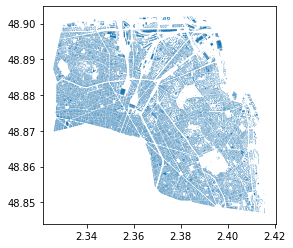

In [32]:
BoI.plot()

In [33]:
saveGraph(BoI,"BoI")

# Preparing trees

In [34]:
districts = "data/data_original/les-arbres.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
trees = gpd.read_file(districts, driver='KML')
trees

/home/kelu/.local/lib/python3.6/site-packages/geopandas/geodataframe.py:577: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


,Name,Description,geometry
0,225931,,POINT (2.38535 48.85479)
1,242671,,POINT (2.29816 48.87849)
2,111359,,POINT (2.27806 48.87171)
3,111930,,POINT (2.33741 48.82256)
4,111954,,POINT (2.33954 48.82188)
...,...,...,...
204169,194532,,POINT (2.27124 48.86923)
204170,283152,,POINT (2.40649 48.83425)
204171,284752,,POINT (2.35223 48.90066)
204172,214396,,POINT (2.27946 48.83657)


,Name,Description,geometry
0,225931,,POINT (2.38535 48.85479)
8,189151,,POINT (2.38236 48.88821)
10,198975,,POINT (2.39381 48.85653)
12,286074,,POINT (2.36124 48.88315)
14,2016864,,POINT (2.33071 48.89291)
...,...,...,...
204163,138188,,POINT (2.37582 48.89908)
204166,228638,,POINT (2.39391 48.88729)
204167,122144,,POINT (2.39145 48.85208)
204171,284752,,POINT (2.35223 48.90066)


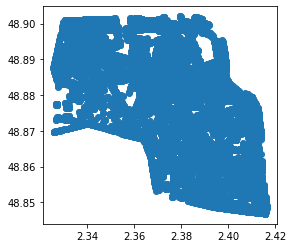

In [35]:
ToI = trees[trees.within(zoi)]
ToI.plot()
ToI

In [36]:
saveGraph(ToI,"ToI")

# Lights

In [37]:
districts = "data/data_original/eclairage-public.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
lights = gpd.read_file(districts, driver='KML')
lights

/home/kelu/.local/lib/python3.6/site-packages/geopandas/geodataframe.py:577: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


,Name,Description,geometry
0,O05746,,POINT (2.28438 48.84903)
1,O05746,,POINT (2.28438 48.84903)
2,O05746,,POINT (2.28438 48.84903)
3,O05746,,POINT (2.28438 48.84903)
4,O05746,,POINT (2.28438 48.84903)
...,...,...,...
229116,35827,,POINT (2.29083 48.84070)
229117,35873,,POINT (2.40906 48.85478)
229118,35886,,POINT (2.30210 48.83438)
229119,35888,,POINT (2.30181 48.83425)


,Name,Description,geometry
18,O01757,,POINT (2.34195 48.89922)
56,E14763,,POINT (2.38696 48.88904)
57,E14777,,POINT (2.36652 48.88650)
58,E14778,,POINT (2.36663 48.88663)
59,E14779,,POINT (2.36674 48.88684)
...,...,...,...
229109,72752,,POINT (2.39220 48.87201)
229110,72780,,POINT (2.38648 48.87393)
229111,72788,,POINT (2.38940 48.87367)
229112,72789,,POINT (2.38881 48.87372)


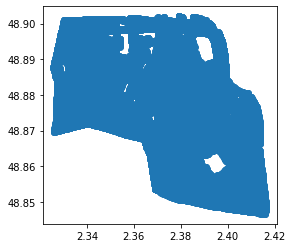

In [38]:
LoI = lights[lights.within(zoi)]
LoI.plot()
saveGraph(LoI,"LoI")
LoI

# Fountains?

In [39]:
districts = "data/data_original/fontaines-a-boire.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
fountains = gpd.read_file(districts, driver='KML')
fountains

/home/kelu/.local/lib/python3.6/site-packages/geopandas/geodataframe.py:577: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


,Name,Description,geometry
0,450019293,,POINT (2.36965 48.84688)
1,450019302,,POINT (2.34755 48.85583)
2,450080718,,POINT (2.30527 48.82813)
3,450080348,,POINT (2.31116 48.86941)
4,450073011,,POINT (2.37416 48.88628)
...,...,...,...
1213,450019282,,POINT (2.33725 48.87952)
1214,450070363,,POINT (2.32477 48.88054)
1215,450019312,,POINT (2.26469 48.84807)
1216,450019298,,POINT (2.35954 48.85545)


,Name,Description,geometry
4,450073011,,POINT (2.37416 48.88628)
7,450080634,,POINT (2.37846 48.89794)
14,450072515,,POINT (2.33108 48.89950)
15,450019160,,POINT (2.37163 48.85847)
17,450072596,,POINT (2.41213 48.87061)
...,...,...,...
1205,450080638,,POINT (2.39814 48.86965)
1206,450080771,,POINT (2.36530 48.89629)
1212,450019328,,POINT (2.36085 48.87120)
1213,450019282,,POINT (2.33725 48.87952)


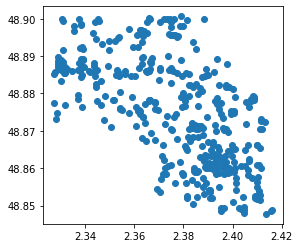

In [40]:
FoI = fountains[fountains.within(zoi)]
FoI.plot()
saveGraph(FoI,"FoI")
FoI

# Espaces verts

,identifiant,nsq_espace_,nom,type,p_vegetatio,proportion_,adresse,arrondissem,statut_ouve,ouvert_24h,...,horaires_pe,horaires_lu,horaires_ma,horaires_me,horaires_je,horaires_ve,horaires_sa,horaires_di,id_dicom,geometry
4,ID733,664.0,MAIL MARCEL ACHARD,Promenades ouvertes,0.382438,38.243819,6 PL MARCEL ACHARD,75019,None,Non,...,None,None,None,None,None,None,None,None,None,"POLYGON ((2.37652 48.87383, 2.37659 48.87373, ..."
5,ID773,111.0,SQUARE D'ANVERS,Promenades ouvertes,0.109216,10.921619,3 PL ANVERS,75009,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 21:30,08:00 - 21:30,08:00 - 21:30,08:00 - 21:30,08:00 - 21:30,09:00 - 21:30,09:00 - 21:30,2468,"POLYGON ((2.34443 48.88269, 2.34447 48.88261, ..."
10,ID863,NaN,Parc de Belleville,Promenades ouvertes,0.355557,35.555681,45 RUE COURONNES,75020,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,07:00 - 21:30,07:00 - 21:30,07:00 - 21:30,07:00 - 21:30,07:00 - 21:30,08:00 - 21:30,08:00 - 21:30,1777,"MULTIPOLYGON (((2.38379 48.87288, 2.38389 48.8..."
29,ID1269,541.0,JARDIN SAINT-VINCENT,Promenades ouvertes,0.791040,79.103990,17 RUE SAINT VINCENT,75018,None,Non,...,None,None,None,None,None,None,None,None,1784,"POLYGON ((2.34154 48.88836, 2.34151 48.88828, ..."
30,ID1270,532.0,SQUARE CLAUDE CHARPENTIER,Promenades ouvertes,0.601020,60.102049,14 RUE MONT CENIS,75018,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,09:00 - 20:30,09:00 - 20:30,2674,"POLYGON ((2.34176 48.88771, 2.34189 48.88768, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
902,ID1000,537.0,SQUARE SUZANNE BUISSON,Promenades ouvertes,0.090037,9.003728,7 B RUE GIRARDON,75018,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,09:00 - 20:30,09:00 - 20:30,2688,"POLYGON ((2.33736 48.88845, 2.33732 48.88838, ..."
914,ID1265,526.0,SQUARE PAUL ROBIN,Promenades ouvertes,0.477651,47.765088,10 PL HEBERT,75018,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,08:00 - 20:30,09:00 - 20:30,09:00 - 20:30,2678,"POLYGON ((2.36369 48.89374, 2.36359 48.89340, ..."
915,ID1325,540.0,JARDIN DE LA RUE GINETTE NEVEU,Promenades ouvertes,0.229031,22.903063,21 RUE GINETTE NEVEU,75018,Ouvert,Non,...,Du 01/05/2021 au 31/08/2021,08:00 - 20:00,08:00 - 20:00,08:00 - 20:00,08:00 - 20:00,08:00 - 20:00,09:00 - 20:00,09:00 - 20:00,2654,"POLYGON ((2.34543 48.90044, 2.34547 48.89957, ..."
918,ID1396,783.0,Square Louis LUMIERE (Centre Handisports),Promenades ouvertes,0.507708,50.770826,42 RUE LOUIS LUMIERE,75020,None,Non,...,None,None,None,None,None,None,None,None,None,"POLYGON ((2.41170 48.85967, 2.41155 48.85966, ..."


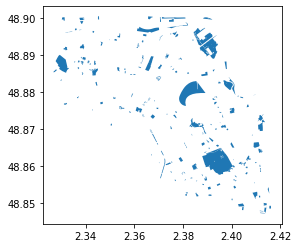

In [41]:
districts = "data/data_original/ilots-de-fraicheur-espaces-verts-frais.zip" 
Bon = gpd.read_file(districts)

FAoI = Bon[Bon.within(zoi)]
FAoI.plot()
saveGraph(FAoI,"FAoI")
FAoI


In [42]:
#districts = "data/data_original/deconfinement-rues-amenagees-pour-pietons.kml"
#gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
#RuesPietonnes = gpd.read_file(districts, driver='KML')
#RPoI = RuesPietonnes[RuesPietonnes.within(zoi)]
#RPoI.plot()
#saveGraph(RPoI,"FoI")
#RPoI

# Green spaces

/home/kelu/.local/lib/python3.6/site-packages/geopandas/geodataframe.py:577: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


,Name,Description,geometry
9,653,,"POLYGON ((2.39954 48.88257, 2.39952 48.88257, ..."
10,669,,"POLYGON ((2.37615 48.88628, 2.37613 48.88630, ..."
13,531,,"POLYGON ((2.33834 48.89835, 2.33838 48.89835, ..."
15,532,,"POLYGON ((2.34167 48.88757, 2.34166 48.88756, ..."
16,773,,"POLYGON ((2.41136 48.85141, 2.41150 48.85142, ..."
...,...,...,...
2151,12046,,"POLYGON ((2.38104 48.85613, 2.38108 48.85614, ..."
2152,12047,,"MULTIPOLYGON (((2.38767 48.85766, 2.38780 48.8..."
2153,12053,,"POLYGON ((2.37455 48.86050, 2.37454 48.86051, ..."
2156,12121,,"POLYGON ((2.36562 48.90043, 2.36562 48.90042, ..."


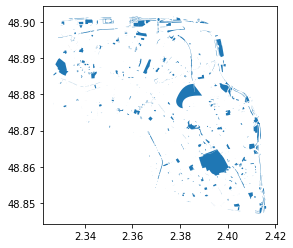

In [43]:
districts = "data/data_original/espaces_verts.kml"
gpd.io.file.fiona.drvsupport.supported_drivers['KML'] = 'rw'
EspacesVerts = gpd.read_file(districts, driver='KML')
EVoI = EspacesVerts[EspacesVerts.within(zoi)]
EVoI.plot()
saveGraph(EVoI,"EVoI")
EVoI

# Going for a full map

In [44]:
with open('./data/G2_consolides.pkl', 'rb') as input:
    G = pickle.load(input)
with open('./data/BoI.pkl', 'rb') as input:
    BoI = pickle.load(input) 
gdNodes,gdStreet = ox.utils_graph.graph_to_gdfs(G) 
gdNodes = gdNodes.reset_index().to_crs("EPSG:4326")
gdStreet = gdStreet.to_crs("EPSG:4326")


In [45]:
gdStreet

osmid                   name  \
u     v     key                                                             
0     1     0                            315818975    Rue Henri Duvernois   
      2     0                             31093720      Rue Louis Lumière   
      3     0                             85735969      Rue Louis Lumière   
      4     0               [266463585, 611974677]        Rue Louis Ganne   
1     0     0                            315818975    Rue Henri Duvernois   
...                                            ...                    ...   
11810 946   0     [69244433, 958991700, 958991701]        Impasse Sandrié   
11812 3503  0               [748636365, 168143655]  Rue Hélène Jakubowicz   
      4089  0                            961265783                    NaN   
11813 5092  0    [961264816, 961264817, 961264814]                    NaN   
11814 11267 0                            963951053   Place de la Bastille   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11810 946   0          pedestrian      NaN   False   88.401   
11812 3503  0         residential       30    True  140.798   
      4089  0             footway      NaN   False  115.209   
11813 5092  0    [steps, footway]      NaN   False   29.778   
11814 11267 0             footway      NaN   False   22.767   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11810 946   0    LINESTRING (2.32935 48.87175, 2.33007 48.87167...   
11812 3503  0    LINESTRING (2.39807 48.86955, 2.39825 48.86941...   
      4089  0    LINESTRING (2.39807 48.86955, 2.39850 48.86985...   
11813 5092  0    LINESTRING (2.39157 48.87100, 2.39156 48.87103...   
11814 11267 0    LINESTRING (2.36944 48.85320, 2.36933 48.85328...   

                 u_original  v_original lanes junction width tunnel access  \
u     v     key                                                              
0     1     0        125730   268675130   NaN      NaN   NaN    NaN    NaN   
      2     0        125730  2841627108     2      NaN   NaN    NaN    NaN   
      3     0        125730   244455548     2      NaN   NaN    NaN    NaN   
      4     0        125730  1089076050     2      NaN   NaN    NaN    NaN   
1     0     0     268675130      125730   NaN      NaN   NaN    NaN    NaN   
...                     ...         ...   ...      ...   ...    ...    ...   
11810 946   0    8873639223  8873639228   NaN      NaN   NaN    NaN    NaN   
11812 3503  0    8892125615   247352376   NaN      NaN   NaN    NaN    NaN   
      4089  0    8892125615  8892125608   NaN      NaN   NaN    NaN    NaN   
11813 5092  0    8892142688  8892142678   NaN      NaN   NaN    NaN    NaN   
11814 11267 0    8916466365  8916466367   NaN      NaN   NaN    NaN    NaN   

                bridge service  ref  
u     v     key                      
0     1     0      NaN     NaN  NaN  
      2     0      NaN     NaN  NaN  
      3     0      NaN     NaN  NaN  
      4     0      NaN     NaN  NaN  
1     0     0      NaN     NaN  NaN  
...                ...     ... 

In [47]:
print("There are",len(gdStreet),"streets mapped.")

There are 26653 streets mapped.


<AxesSubplot:>

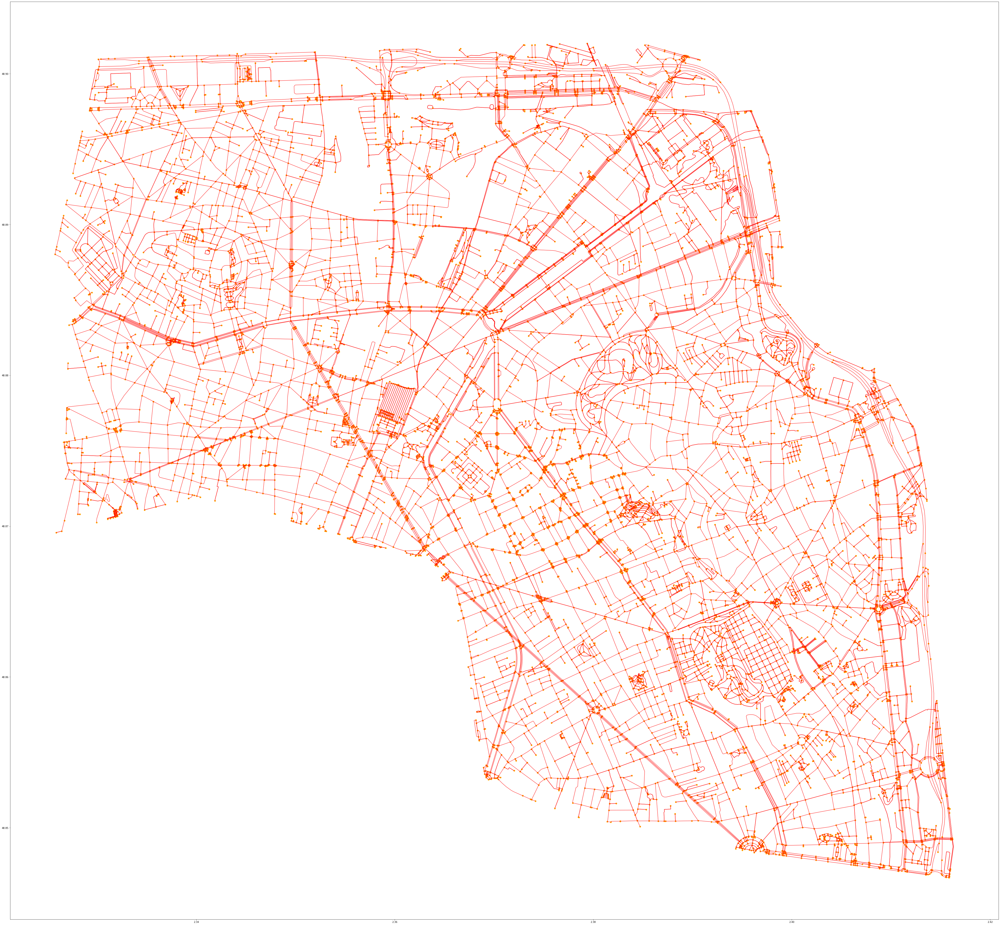

In [48]:
# Note  gdStreets[0] are nodes, gdStreets[1] are edges
ax = gdStreet.plot(figsize=(75, 75), alpha=0.8, edgecolor='r')
gdNodes.plot(ax=ax, alpha=1, markersize=35, color = "orange")

In [49]:
gdNodes.head()

,osmid,osmid_original,y,x,street_count,lon,lat,highway,ref,geometry
0,0,125730,5.412452e+06,456781.900993,4,2.410732,48.863523,NaN,NaN,POINT (2.41073 48.86352)
1,1,268675130,5.412447e+06,456789.384246,5,2.410834,48.863483,NaN,NaN,POINT (2.41083 48.86348)
2,2,2841627108,5.412574e+06,456744.278141,4,2.410206,48.864623,crossing,NaN,POINT (2.41021 48.86462)
3,3,244455548,5.412347e+06,456794.553236,4,2.410915,48.862578,NaN,NaN,POINT (2.41092 48.86258)
4,4,1089076050,5.412436e+06,456658.320573,4,2.409049,48.863371,NaN,NaN,POINT (2.40905 48.86337)


<AxesSubplot:>

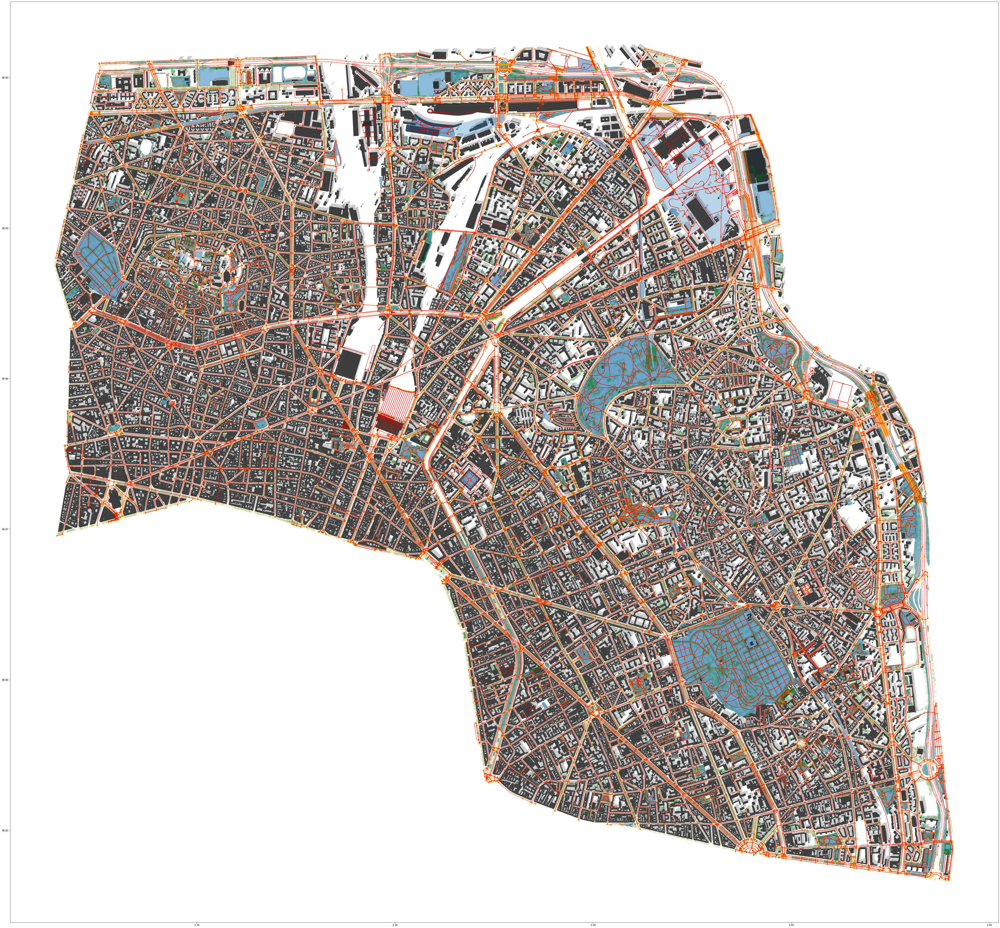

In [87]:
import pickle5 as pickle 
ax = EVoI.plot(figsize=(75, 75), alpha=0.5, edgecolor='k')
gdStreet.plot(ax=ax, alpha=0.8, edgecolor='r')
gdNodes.plot(ax=ax, alpha=1, markersize=35, color = "orange")
with open('./data/BoI_shaded_simple.pkl', 'rb') as input:
    # this requires the "BoI_shaded_simple" file generated later on
    BoIS = pickle.load(input) 
BoIS.plot(ax=ax, alpha=0.4, color='grey')
BoI.plot(ax=ax, alpha=0.7, color='black')
FoI.plot(ax=ax, alpha=0.99)
FAoI.plot(ax=ax, alpha=0.3)
ToI.plot(ax=ax, alpha=0.06,markersize =90,color="green")
LoI.plot(ax=ax, alpha=0.06,markersize =90,color="orange")

<AxesSubplot:>

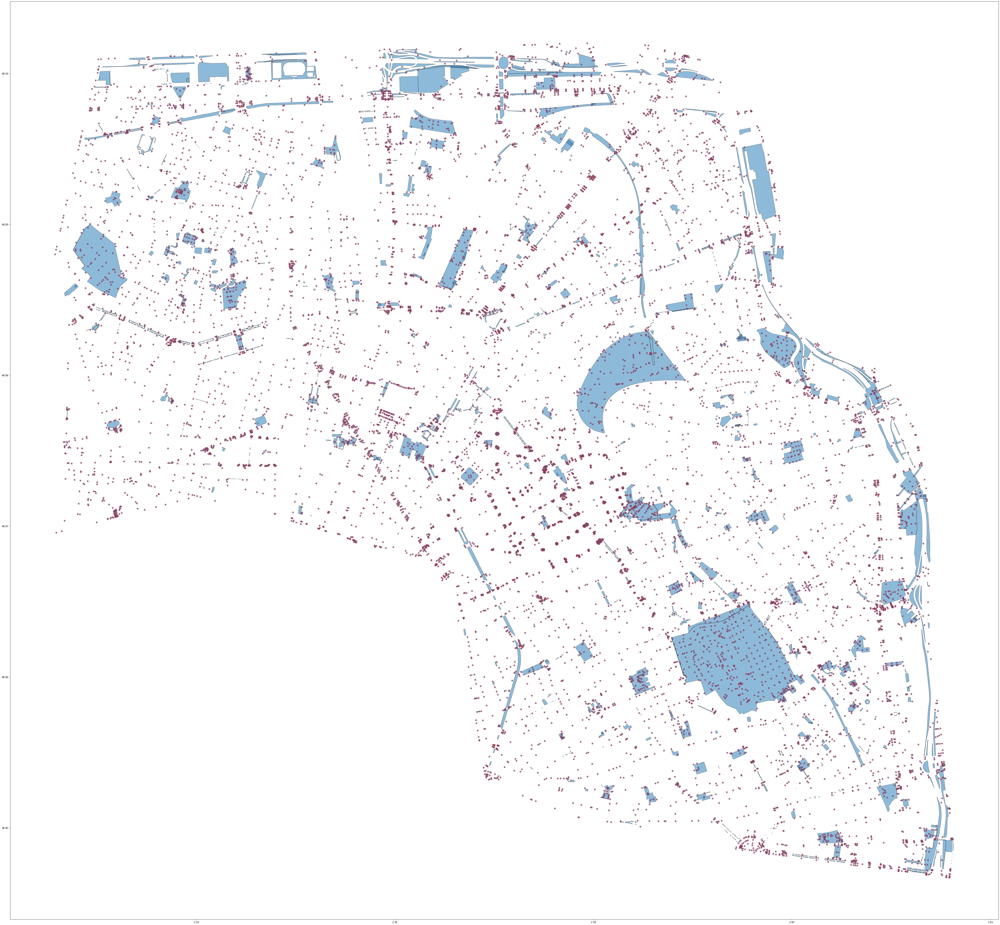

In [88]:
ax = EVoI.plot(figsize=(75, 75), alpha=0.5, edgecolor='k')
gdNodes.plot(ax=ax, alpha=0.8, edgecolor='r')

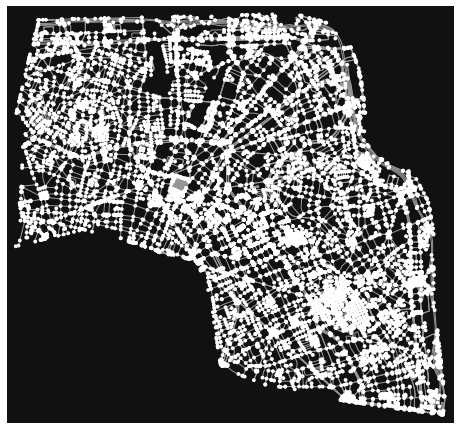

<Figure size 432x288 with 0 Axes>

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [89]:
fig, ax = ox.plot_graph(G)
ox.plot.plot_footprints(EVoI, ax=ax, figsize=(15, 15))#, color='orange', alpha=None, bgcolor='#111111', bbox=None, save=False, show=True, close=False, filepath=None, dpi=600)

# Let's see what our buildings look like

## We don't need all individual blocks, let's keep only the overall footprint

#### Reference mapping

<AxesSubplot:>

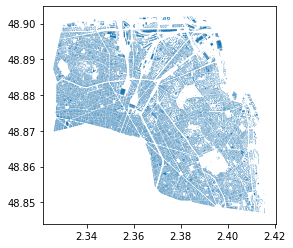

In [90]:
with open('./data/BoI.pkl', 'rb') as input:
    BoI = pickle.load(input) 
    
BoI.plot()

#### Let's merge these

In [91]:
pickle.HIGHEST_PROTOCOL = 5
combined_polygons = BoI.dissolve().explode()
pickle.HIGHEST_PROTOCOL = 4

<AxesSubplot:>

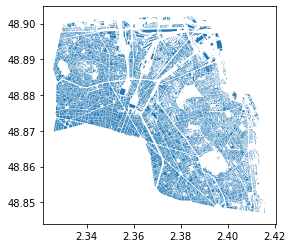

In [92]:
combined_polygons.plot()

# We can keep around 3% of the initial shapes!

In [93]:
len(combined_polygons)/len(BoI)*100

3.5327328136816645

<AxesSubplot:>

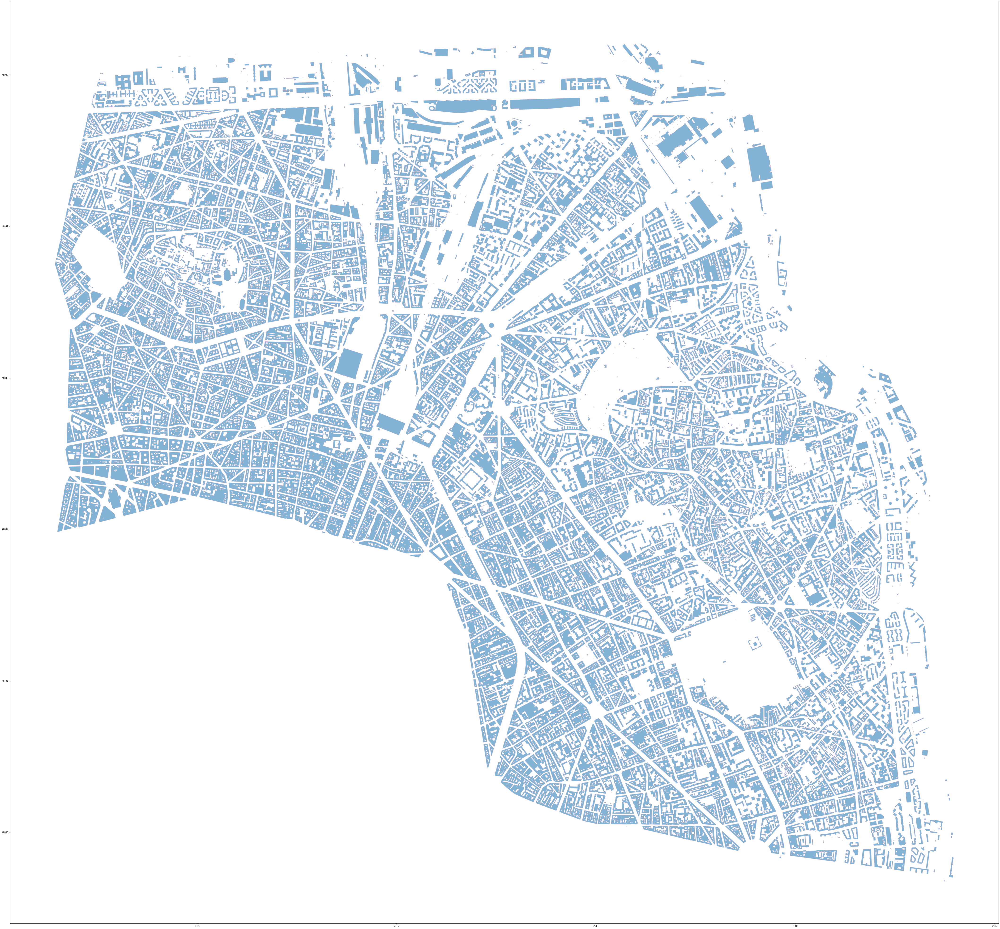

In [94]:
ax = BoI.plot(figsize=(75, 75), alpha=0.1)
combined_polygons.plot(ax=ax, alpha=0.5, edgecolor='pink')

In [95]:
saveGraph(combined_polygons,"BoI_simple")

In [96]:
gdStreet

osmid                   name  \
u     v     key                                                             
0     1     0                            315818975    Rue Henri Duvernois   
      2     0                             31093720      Rue Louis Lumière   
      3     0                             85735969      Rue Louis Lumière   
      4     0               [266463585, 611974677]        Rue Louis Ganne   
1     0     0                            315818975    Rue Henri Duvernois   
...                                            ...                    ...   
11810 946   0     [69244433, 958991700, 958991701]        Impasse Sandrié   
11812 3503  0               [748636365, 168143655]  Rue Hélène Jakubowicz   
      4089  0                            961265783                    NaN   
11813 5092  0    [961264816, 961264817, 961264814]                    NaN   
11814 11267 0                            963951053   Place de la Bastille   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11810 946   0          pedestrian      NaN   False   88.401   
11812 3503  0         residential       30    True  140.798   
      4089  0             footway      NaN   False  115.209   
11813 5092  0    [steps, footway]      NaN   False   29.778   
11814 11267 0             footway      NaN   False   22.767   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11810 946   0    LINESTRING (2.32935 48.87175, 2.33007 48.87167...   
11812 3503  0    LINESTRING (2.39807 48.86955, 2.39825 48.86941...   
      4089  0    LINESTRING (2.39807 48.86955, 2.39850 48.86985...   
11813 5092  0    LINESTRING (2.39157 48.87100, 2.39156 48.87103...   
11814 11267 0    LINESTRING (2.36944 48.85320, 2.36933 48.85328...   

                 u_original  v_original lanes  ... tunnel access bridge  \
u     v     key                                ...                        
0     1     0        125730   268675130   NaN  ...    NaN    NaN    NaN   
      2     0        125730  2841627108     2  ...    NaN    NaN    NaN   
      3     0        125730   244455548     2  ...    NaN    NaN    NaN   
      4     0        125730  1089076050     2  ...    NaN    NaN    NaN   
1     0     0     268675130      125730   NaN  ...    NaN    NaN    NaN   
...                     ...         ...   ...  ...    ...    ...    ...   
11810 946   0    8873639223  8873639228   NaN  ...    NaN    NaN    NaN   
11812 3503  0    8892125615   247352376   NaN  ...    NaN    NaN    NaN   
      4089  0    8892125615  8892125608   NaN  ...    NaN    NaN    NaN   
11813 5092  0    8892142688  8892142678   NaN  ...    NaN    NaN    NaN   
11814 11267 0    8916466365  8916466367   NaN  ...    NaN    NaN    NaN   

                service  ref trees lights  fountains  greenspaces  freshplaces  
u     v     key                                                                 
0     1     0       NaN  NaN     6     23          1            3            1  
      2     0       NaN  NaN    34     48          3            3            0  
      3     

# Polygons

In [97]:
from shapely.geometry.polygon import Polygon
from shapely.geometry.multipolygon import MultiPolygon
# gdNodes,gdStreet
listStrees = gdStreet.reset_index()
RUE =listStrees[(listStrees.u == 209133647) & (listStrees.v == 209138149)]
RUE

,u,v,key,osmid,name,highway,maxspeed,oneway,length,geometry,...,tunnel,access,bridge,service,ref,trees,lights,fountains,greenspaces,freshplaces


In [98]:
for row in gdStreet:
    print(row)

osmid
name
highway
maxspeed
oneway
length
geometry
u_original
v_original
lanes
junction
width
tunnel
access
bridge
service
ref
trees
lights
fountains
greenspaces
freshplaces


In [99]:
STREETS = gdStreet
STREETS["trees"] = -1
STREETS["lights"] = -1
STREETS["fountains"] = -1
STREETS["greenspaces"] = -1
STREETS["freshplaces"] = -1
STREETS.head()

osmid                 name      highway maxspeed  \
u v key                                                                      
0 1 0                 315818975  Rue Henri Duvernois  residential       30   
  2 0                  31093720    Rue Louis Lumière  residential       30   
  3 0                  85735969    Rue Louis Lumière  residential       30   
  4 0    [266463585, 611974677]      Rue Louis Ganne  residential       30   
1 0 0                 315818975  Rue Henri Duvernois  residential       30   

         oneway   length                                           geometry  \
u v key                                                                       
0 1 0     False    8.707    LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
  2 0     False  128.700  LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
  3 0     False  105.925  LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
  4 0     False  124.290  LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1 0 0     False    8.707    LINESTRING (2.41083 48.86348, 2.41073 48.86352)   

         u_original  v_original lanes  ... tunnel access bridge service  ref  \
u v key                                ...                                     
0 1 0        125730   268675130   NaN  ...    NaN    NaN    NaN     NaN  NaN   
  2 0        125730  2841627108     2  ...    NaN    NaN    NaN     NaN  NaN   
  3 0        125730   244455548     2  ...    NaN    NaN    NaN     NaN  NaN   
  4 0        125730  1089076050     2  ...    NaN    NaN    NaN     NaN  NaN   
1 0 0     268675130      125730   NaN  ...    NaN    NaN    NaN     NaN  NaN   

        trees lights  fountains  greenspaces  freshplaces  
u v key                                                    
0 1 0      -1     -1         -1           -1           -1  
  2 0      -1     -1         -1           -1           -1  
  3 0      -1     -1         -1           -1           -1  
  4 0      -1     -1         -1           -1           -1  
1 0 0      -1     -1         -1           -1           -1  

[5 rows x 22 columns]

In [100]:
len(STREETS[STREETS.freshplaces >= 0])

0

In [101]:
for index,row in STREETS.iterrows():
    if row["freshplaces"]<0:
        # Trees
        POLY = Polygon(row.geometry.buffer(0.0005))
        cTrees = len(ToI[ToI.within(POLY)])
        STREETS.loc[index,"trees"] = cTrees
        # Lighting
        cLights = len(LoI[LoI.within(POLY)])
        STREETS.loc[index,"lights"] = cLights
        POLY = Polygon(row.geometry.buffer(0.002))
        # Fontaines
        cFountains = len(FoI[FoI.within(POLY)])
        STREETS.loc[index,"fountains"] = cFountains
        # Espaces verts
        cEV = len(EVoI[EVoI.overlaps(POLY)])
        STREETS.loc[index,"greenspaces"] = cEV
        cFresh = len(FAoI[FAoI.overlaps(POLY)])
        STREETS.loc[index,"freshplaces"] = cFresh
        print(index,": ",cTrees,"trees -- ",cTrees,cLights,cFountains,cEV,cFresh)

(0, 1, 0) :  6 trees --  6 23 1 3 1
(0, 2, 0) :  34 trees --  34 48 3 3 0
(0, 3, 0) :  25 trees --  25 40 3 4 2
(0, 4, 0) :  12 trees --  12 66 1 3 2
(1, 0, 0) :  6 trees --  6 23 1 3 1
(1, 4678, 0) :  14 trees --  14 31 0 5 1
(1, 4023, 0) :  25 trees --  25 40 1 4 2
(1, 4679, 0) :  34 trees --  34 51 3 4 1
(1, 4680, 0) :  51 trees --  51 73 3 6 1
(2, 473, 0) :  33 trees --  33 24 3 4 1
(2, 4679, 0) :  33 trees --  33 26 3 4 1
(2, 9284, 0) :  32 trees --  32 25 3 4 1
(2, 0, 0) :  34 trees --  34 48 3 3 0
(3, 4023, 0) :  21 trees --  21 19 2 3 2
(3, 4020, 0) :  70 trees --  70 41 3 3 2
(3, 4024, 0) :  43 trees --  43 67 2 3 2
(3, 0, 0) :  25 trees --  25 40 3 4 2
(4, 6869, 0) :  15 trees --  15 65 0 3 2
(4, 6870, 0) :  9 trees --  9 58 0 2 2
(4, 6871, 0) :  8 trees --  8 46 0 2 2
(4, 0, 0) :  12 trees --  12 66 1 3 2
(5, 6, 0) :  2 trees --  2 22 2 1 0
(5, 7, 0) :  5 trees --  5 16 1 3 1
(5, 8, 0) :  14 trees --  14 31 2 3 1
(6, 1141, 0) :  6 trees --  6 26 1 2 1
(6, 1142, 0) :  2 trees

(78, 2212, 0) :  23 trees --  23 42 0 0 0
(79, 80, 0) :  20 trees --  20 35 4 4 2
(79, 81, 0) :  16 trees --  16 35 6 4 2
(80, 9843, 0) :  12 trees --  12 28 3 3 2
(80, 450, 0) :  16 trees --  16 28 3 4 2
(81, 4778, 0) :  5 trees --  5 6 5 5 2
(81, 4780, 0) :  3 trees --  3 8 5 5 2
(82, 83, 0) :  49 trees --  49 32 6 2 2
(82, 84, 0) :  144 trees --  144 63 4 3 2
(83, 11148, 0) :  30 trees --  30 26 7 1 1
(83, 82, 0) :  49 trees --  49 32 6 2 2
(84, 82, 0) :  144 trees --  144 63 4 3 2
(84, 2133, 0) :  98 trees --  98 53 2 1 2
(84, 2131, 0) :  52 trees --  52 43 1 2 1
(84, 648, 0) :  52 trees --  52 42 0 3 1
(85, 86, 0) :  16 trees --  16 14 6 3 1
(86, 2283, 0) :  31 trees --  31 12 9 2 1
(86, 2282, 0) :  3 trees --  3 15 5 2 1
(87, 88, 0) :  27 trees --  27 17 5 2 1
(87, 89, 0) :  68 trees --  68 11 6 3 2
(88, 4481, 0) :  13 trees --  13 12 5 2 1
(89, 653, 0) :  72 trees --  72 21 7 2 1
(89, 10941, 0) :  35 trees --  35 11 6 3 2
(90, 91, 0) :  1 trees --  1 46 3 3 3
(90, 92, 0) :  104 

(161, 156, 0) :  24 trees --  24 26 3 1 0
(161, 7098, 0) :  25 trees --  25 24 3 1 0
(162, 163, 0) :  11 trees --  11 15 2 1 0
(163, 7687, 0) :  15 trees --  15 20 3 1 0
(163, 162, 0) :  11 trees --  11 15 2 1 0
(163, 161, 0) :  23 trees --  23 22 3 1 0
(164, 165, 0) :  27 trees --  27 17 3 6 3
(164, 166, 0) :  27 trees --  27 17 3 6 3
(164, 167, 0) :  31 trees --  31 17 3 6 3
(164, 168, 0) :  27 trees --  27 17 3 5 2
(164, 169, 0) :  57 trees --  57 21 3 6 2
(165, 7522, 0) :  27 trees --  27 15 3 6 3
(165, 7902, 0) :  26 trees --  26 15 3 6 3
(165, 167, 0) :  31 trees --  31 17 3 6 3
(166, 164, 0) :  27 trees --  27 17 3 6 3
(166, 7902, 0) :  24 trees --  24 15 3 5 3
(166, 2763, 0) :  32 trees --  32 19 4 6 3
(166, 168, 0) :  27 trees --  27 17 3 5 2
(167, 9534, 0) :  58 trees --  58 21 3 5 2
(167, 165, 0) :  31 trees --  31 17 3 6 3
(167, 164, 0) :  31 trees --  31 17 3 6 3
(168, 10833, 0) :  28 trees --  28 16 3 5 2
(168, 3041, 0) :  35 trees --  35 27 3 5 2
(168, 166, 0) :  27 tree

(241, 3981, 0) :  18 trees --  18 18 8 2 2
(242, 243, 0) :  16 trees --  16 74 2 2 1
(243, 1197, 0) :  21 trees --  21 72 2 2 1
(243, 1198, 0) :  20 trees --  20 72 2 2 1
(244, 245, 0) :  14 trees --  14 58 2 1 1
(244, 246, 0) :  14 trees --  14 65 2 1 1
(244, 247, 0) :  13 trees --  13 68 2 1 1
(245, 244, 0) :  14 trees --  14 58 2 1 1
(245, 3536, 0) :  17 trees --  17 63 1 1 1
(245, 8478, 0) :  16 trees --  16 65 2 1 1
(245, 5755, 0) :  15 trees --  15 57 1 1 1
(246, 8478, 0) :  10 trees --  10 55 2 1 1
(246, 9336, 0) :  9 trees --  9 66 2 1 1
(246, 9335, 0) :  19 trees --  19 84 2 1 1
(247, 3537, 0) :  10 trees --  10 62 2 1 1
(247, 244, 0) :  13 trees --  13 68 2 1 1
(248, 249, 0) :  11 trees --  11 69 4 4 1
(248, 250, 0) :  11 trees --  11 81 4 3 0
(248, 251, 0) :  15 trees --  15 80 4 2 0
(249, 5267, 0) :  11 trees --  11 51 4 4 1
(249, 5345, 0) :  12 trees --  12 71 4 4 1
(249, 7497, 0) :  11 trees --  11 55 4 3 1
(250, 7496, 0) :  11 trees --  11 78 4 2 0
(250, 6901, 0) :  12 t

(314, 315, 0) :  36 trees --  36 24 0 0 0
(314, 316, 0) :  67 trees --  67 30 0 4 2
(315, 314, 0) :  36 trees --  36 24 0 0 0
(315, 5749, 0) :  59 trees --  59 40 0 0 0
(316, 9427, 0) :  38 trees --  38 15 0 4 2
(316, 314, 0) :  67 trees --  67 30 0 4 2
(316, 661, 0) :  37 trees --  37 24 0 4 2
(317, 318, 0) :  19 trees --  19 44 0 0 0
(317, 319, 0) :  18 trees --  18 43 0 0 0
(318, 5765, 0) :  19 trees --  19 44 0 0 0
(318, 5764, 0) :  26 trees --  26 44 0 0 0
(318, 5766, 0) :  22 trees --  22 44 0 0 0
(319, 5769, 0) :  20 trees --  20 46 0 0 0
(319, 2967, 0) :  23 trees --  23 48 0 0 0
(320, 321, 0) :  17 trees --  17 23 0 4 1
(320, 322, 0) :  19 trees --  19 19 0 3 0
(320, 323, 0) :  19 trees --  19 35 1 2 0
(320, 324, 0) :  30 trees --  30 24 0 3 0
(321, 3965, 0) :  9 trees --  9 24 2 3 1
(321, 320, 0) :  17 trees --  17 23 0 4 1
(321, 3966, 0) :  9 trees --  9 22 0 3 1
(322, 5528, 0) :  17 trees --  17 23 0 4 1
(322, 4471, 0) :  16 trees --  16 17 0 3 0
(322, 320, 0) :  19 trees -

(397, 5570, 0) :  76 trees --  76 41 2 1 0
(397, 2959, 0) :  31 trees --  31 23 2 1 0
(398, 418, 0) :  49 trees --  49 24 0 1 1
(398, 132, 0) :  70 trees --  70 42 1 1 1
(399, 400, 0) :  43 trees --  43 22 1 1 1
(399, 401, 0) :  102 trees --  102 58 2 2 2
(400, 396, 0) :  47 trees --  47 29 1 1 0
(400, 5995, 0) :  104 trees --  104 54 2 1 1
(401, 5995, 0) :  61 trees --  61 33 2 2 1
(401, 10425, 0) :  68 trees --  68 43 2 2 1
(401, 10426, 0) :  61 trees --  61 35 2 2 1
(402, 403, 0) :  39 trees --  39 21 0 1 1
(402, 404, 0) :  98 trees --  98 42 1 2 2
(403, 8397, 0) :  25 trees --  25 25 0 1 1
(403, 8400, 0) :  27 trees --  27 19 0 1 1
(403, 8401, 0) :  27 trees --  27 19 0 1 1
(404, 2963, 0) :  48 trees --  48 18 1 2 2
(404, 399, 0) :  89 trees --  89 44 1 1 1
(404, 417, 0) :  60 trees --  60 42 1 2 2
(405, 406, 0) :  41 trees --  41 26 1 2 1
(405, 402, 0) :  75 trees --  75 46 1 1 1
(405, 407, 0) :  53 trees --  53 39 1 2 1
(406, 405, 0) :  41 trees --  41 26 1 2 1
(406, 5573, 0) :  

(477, 475, 0) :  97 trees --  97 68 5 1 1
(477, 1355, 0) :  21 trees --  21 32 3 2 1
(477, 1356, 0) :  73 trees --  73 57 3 1 1
(477, 1357, 0) :  59 trees --  59 37 3 1 1
(478, 492, 0) :  6 trees --  6 23 2 1 1
(478, 475, 0) :  39 trees --  39 46 4 1 1
(479, 3872, 0) :  42 trees --  42 19 3 1 1
(479, 3873, 0) :  61 trees --  61 21 5 1 1
(479, 475, 0) :  46 trees --  46 31 4 1 1
(479, 3874, 0) :  81 trees --  81 29 4 1 1
(480, 478, 0) :  34 trees --  34 32 3 1 1
(481, 482, 0) :  42 trees --  42 17 1 1 1
(481, 483, 0) :  63 trees --  63 25 1 1 1
(481, 476, 0) :  101 trees --  101 53 3 1 1
(482, 481, 0) :  42 trees --  42 17 1 1 1
(483, 484, 0) :  76 trees --  76 38 2 1 1
(483, 481, 0) :  63 trees --  63 25 1 1 1
(483, 3871, 0) :  82 trees --  82 22 1 1 1
(484, 485, 0) :  35 trees --  35 24 2 1 1
(484, 486, 0) :  34 trees --  34 40 2 1 1
(484, 483, 0) :  76 trees --  76 38 2 1 1
(485, 484, 0) :  35 trees --  35 24 2 1 1
(485, 487, 0) :  38 trees --  38 32 1 2 1
(485, 488, 0) :  98 trees -

(564, 566, 0) :  57 trees --  57 50 1 0 0
(564, 562, 0) :  41 trees --  41 24 1 1 0
(564, 567, 0) :  39 trees --  39 28 1 1 0
(565, 580, 0) :  39 trees --  39 59 2 1 0
(565, 1083, 0) :  33 trees --  33 35 2 1 1
(565, 1084, 0) :  30 trees --  30 38 3 1 1
(566, 564, 0) :  57 trees --  57 50 1 0 0
(566, 9371, 0) :  18 trees --  18 36 1 1 1
(566, 570, 0) :  21 trees --  21 39 1 1 1
(567, 580, 0) :  46 trees --  46 43 1 1 0
(567, 1087, 0) :  32 trees --  32 22 1 1 0
(567, 564, 0) :  39 trees --  39 28 1 1 0
(568, 569, 0) :  25 trees --  25 36 2 0 0
(568, 560, 0) :  12 trees --  12 34 2 2 1
(569, 566, 0) :  18 trees --  18 24 1 0 0
(570, 571, 0) :  22 trees --  22 44 0 1 1
(570, 572, 0) :  12 trees --  12 24 0 1 1
(571, 7501, 0) :  5 trees --  5 24 0 3 1
(571, 572, 0) :  15 trees --  15 39 0 2 1
(572, 614, 0) :  11 trees --  11 24 0 3 0
(572, 570, 0) :  12 trees --  12 24 0 1 1
(572, 615, 0) :  8 trees --  8 16 0 2 0
(573, 570, 0) :  9 trees --  9 29 0 1 1
(573, 574, 0) :  12 trees --  12 35

(653, 3241, 0) :  27 trees --  27 18 4 1 1
(653, 652, 0) :  31 trees --  31 51 5 2 1
(654, 10022, 0) :  0 trees --  0 3 4 3 2
(654, 87, 0) :  23 trees --  23 13 5 3 2
(655, 656, 0) :  18 trees --  18 24 1 1 1
(655, 657, 0) :  33 trees --  33 31 1 0 0
(656, 3239, 0) :  45 trees --  45 34 1 1 1
(656, 699, 0) :  19 trees --  19 25 1 1 1
(657, 5543, 0) :  88 trees --  88 17 1 0 0
(657, 5544, 0) :  32 trees --  32 33 1 2 1
(658, 643, 0) :  18 trees --  18 34 0 4 1
(658, 7906, 0) :  2 trees --  2 26 1 2 0
(659, 651, 0) :  37 trees --  37 31 1 1 1
(659, 5545, 0) :  42 trees --  42 9 1 0 0
(660, 7908, 0) :  32 trees --  32 7 1 0 0
(660, 5546, 0) :  64 trees --  64 10 1 0 0
(661, 662, 0) :  15 trees --  15 20 0 3 1
(661, 663, 0) :  67 trees --  67 62 0 2 1
(661, 316, 0) :  37 trees --  37 24 0 4 2
(661, 664, 0) :  30 trees --  30 32 0 3 1
(662, 661, 0) :  15 trees --  15 20 0 3 1
(662, 692, 0) :  14 trees --  14 20 0 3 1
(663, 602, 0) :  45 trees --  45 33 0 4 0
(663, 312, 0) :  38 trees --  38

(740, 4792, 0) :  1 trees --  1 18 3 2 1
(740, 737, 0) :  1 trees --  1 42 3 0 0
(741, 742, 0) :  17 trees --  17 28 0 1 0
(741, 743, 0) :  22 trees --  22 34 0 1 0
(742, 894, 0) :  9 trees --  9 37 0 1 0
(742, 744, 0) :  9 trees --  9 30 0 1 0
(743, 1085, 0) :  28 trees --  28 38 0 1 0
(743, 589, 0) :  22 trees --  22 26 1 1 0
(743, 303, 0) :  28 trees --  28 30 0 1 0
(744, 710, 0) :  14 trees --  14 34 0 1 0
(744, 742, 0) :  9 trees --  9 30 0 1 0
(745, 550, 0) :  32 trees --  32 54 2 3 2
(745, 582, 0) :  19 trees --  19 24 1 0 0
(746, 747, 0) :  16 trees --  16 40 2 1 0
(747, 750, 0) :  12 trees --  12 45 3 1 1
(747, 748, 0) :  0 trees --  0 19 2 1 1
(748, 749, 0) :  0 trees --  0 18 1 1 1
(749, 769, 0) :  0 trees --  0 9 0 2 1
(749, 9737, 0) :  0 trees --  0 4 0 1 0
(750, 5337, 0) :  40 trees --  40 29 2 1 1
(750, 3267, 0) :  23 trees --  23 47 2 2 2
(751, 752, 0) :  17 trees --  17 30 3 2 0
(751, 154, 0) :  24 trees --  24 23 2 0 0
(752, 753, 0) :  33 trees --  33 26 3 2 0
(753, 7

(828, 829, 0) :  26 trees --  26 36 0 2 0
(828, 830, 0) :  37 trees --  37 47 0 1 0
(829, 3305, 0) :  32 trees --  32 43 0 2 0
(829, 11352, 0) :  23 trees --  23 40 0 1 0
(830, 3305, 0) :  33 trees --  33 41 0 1 0
(830, 3306, 0) :  68 trees --  68 62 0 2 1
(830, 3307, 0) :  41 trees --  41 45 0 1 0
(831, 196, 0) :  18 trees --  18 22 0 0 0
(831, 4185, 0) :  13 trees --  13 19 0 0 0
(832, 883, 0) :  14 trees --  14 21 0 0 0
(832, 196, 0) :  17 trees --  17 24 0 0 0
(833, 834, 0) :  4 trees --  4 25 1 0 0
(833, 835, 0) :  2 trees --  2 34 1 0 0
(834, 1812, 0) :  5 trees --  5 23 0 2 0
(834, 1791, 0) :  6 trees --  6 26 0 2 0
(835, 1781, 0) :  2 trees --  2 21 1 0 0
(836, 837, 0) :  20 trees --  20 24 0 0 0
(836, 838, 0) :  27 trees --  27 28 0 0 0
(837, 3702, 0) :  26 trees --  26 33 0 0 0
(837, 8352, 0) :  21 trees --  21 24 0 0 0
(837, 10780, 0) :  39 trees --  39 49 0 0 0
(838, 3702, 0) :  16 trees --  16 20 0 0 0
(838, 3703, 0) :  17 trees --  17 35 0 0 0
(838, 3704, 0) :  20 trees -

(924, 3919, 1) :  25 trees --  25 16 2 4 1
(924, 922, 0) :  33 trees --  33 38 1 7 2
(924, 7061, 0) :  21 trees --  21 16 1 4 1
(925, 1279, 0) :  12 trees --  12 63 4 1 1
(925, 922, 0) :  59 trees --  59 76 5 5 2
(926, 927, 0) :  14 trees --  14 38 1 8 1
(926, 928, 0) :  6 trees --  6 30 3 5 1
(927, 912, 0) :  12 trees --  12 19 0 5 0
(927, 915, 0) :  22 trees --  22 36 1 6 0
(928, 1292, 0) :  23 trees --  23 55 4 4 0
(929, 930, 0) :  45 trees --  45 12 2 4 1
(929, 926, 0) :  41 trees --  41 31 2 5 1
(930, 4864, 0) :  48 trees --  48 13 2 4 1
(930, 9395, 0) :  134 trees --  134 90 3 2 0
(931, 932, 0) :  16 trees --  16 30 3 1 0
(931, 933, 0) :  18 trees --  18 26 3 1 0
(932, 1278, 0) :  20 trees --  20 26 3 1 0
(932, 935, 0) :  38 trees --  38 58 3 1 0
(933, 8266, 0) :  25 trees --  25 23 2 2 0
(933, 8264, 0) :  23 trees --  23 21 3 3 1
(934, 935, 0) :  20 trees --  20 28 2 2 1
(934, 931, 0) :  19 trees --  19 43 3 1 0
(934, 936, 0) :  54 trees --  54 74 4 4 2
(935, 934, 0) :  20 trees

(1020, 5875, 0) :  70 trees --  70 24 5 3 2
(1021, 1022, 0) :  0 trees --  0 30 2 1 0
(1022, 2243, 0) :  33 trees --  33 72 3 1 0
(1023, 990, 0) :  0 trees --  0 14 2 2 1
(1024, 1025, 0) :  0 trees --  0 14 0 3 1
(1024, 993, 0) :  9 trees --  9 21 0 3 2
(1025, 994, 0) :  9 trees --  9 16 2 3 3
(1026, 1028, 0) :  43 trees --  43 24 1 0 0
(1026, 999, 0) :  18 trees --  18 20 1 0 0
(1027, 1031, 0) :  23 trees --  23 31 1 4 2
(1028, 997, 0) :  31 trees --  31 18 1 0 0
(1028, 1034, 0) :  39 trees --  39 24 1 1 0
(1029, 1030, 0) :  29 trees --  29 36 1 2 1
(1029, 1031, 0) :  36 trees --  36 32 1 4 2
(1029, 1032, 0) :  50 trees --  50 49 1 4 2
(1030, 1036, 0) :  23 trees --  23 24 1 1 0
(1030, 1037, 0) :  35 trees --  35 32 1 1 0
(1031, 2977, 0) :  50 trees --  50 57 3 3 2
(1031, 2976, 0) :  44 trees --  44 36 1 4 2
(1031, 1029, 0) :  36 trees --  36 32 1 4 2
(1032, 1004, 0) :  53 trees --  53 50 1 0 0
(1032, 1037, 0) :  65 trees --  65 51 1 0 0
(1032, 1029, 0) :  50 trees --  50 49 1 4 2
(10

(1102, 11272, 0) :  5 trees --  5 92 2 5 2
(1102, 4609, 0) :  5 trees --  5 98 3 5 2
(1103, 1151, 0) :  13 trees --  13 20 3 0 0
(1103, 1152, 0) :  28 trees --  28 32 3 0 0
(1104, 1105, 0) :  8 trees --  8 25 2 1 1
(1104, 1106, 0) :  42 trees --  42 32 2 1 1
(1105, 1107, 0) :  10 trees --  10 21 2 1 1
(1105, 817, 0) :  14 trees --  14 39 3 1 1
(1106, 6247, 0) :  37 trees --  37 11 0 1 0
(1106, 10878, 0) :  37 trees --  37 11 0 1 0
(1106, 10879, 0) :  37 trees --  37 9 0 1 0
(1107, 4486, 0) :  27 trees --  27 28 2 1 1
(1107, 4482, 0) :  10 trees --  10 19 1 2 1
(1108, 1109, 0) :  11 trees --  11 32 1 0 0
(1109, 1112, 0) :  11 trees --  11 32 1 0 0
(1109, 1110, 0) :  36 trees --  36 60 2 0 0
(1110, 1111, 0) :  17 trees --  17 15 1 0 0
(1111, 5092, 0) :  19 trees --  19 19 1 1 1
(1111, 3165, 0) :  34 trees --  34 26 1 0 0
(1112, 1113, 0) :  10 trees --  10 31 1 0 0
(1112, 1114, 0) :  35 trees --  35 52 1 0 0
(1113, 4184, 0) :  10 trees --  10 33 1 0 0
(1114, 1365, 0) :  26 trees --  26 24

(1182, 4198, 0) :  25 trees --  25 16 0 4 0
(1183, 1184, 0) :  5 trees --  5 32 6 3 2
(1183, 1185, 0) :  5 trees --  5 27 6 2 2
(1183, 1186, 0) :  10 trees --  10 31 6 3 2
(1184, 6884, 0) :  7 trees --  7 31 6 3 2
(1184, 238, 0) :  2 trees --  2 34 8 2 2
(1185, 1183, 0) :  5 trees --  5 27 6 2 2
(1185, 1187, 0) :  14 trees --  14 46 6 4 2
(1185, 1188, 0) :  3 trees --  3 31 7 3 2
(1186, 6884, 0) :  8 trees --  8 29 6 3 2
(1186, 6881, 0) :  19 trees --  19 40 5 3 2
(1186, 1183, 0) :  10 trees --  10 31 6 3 2
(1187, 4005, 0) :  12 trees --  12 21 2 5 2
(1187, 11348, 0) :  11 trees --  11 21 2 5 2
(1187, 4009, 0) :  10 trees --  10 22 2 5 2
(1188, 6879, 0) :  1 trees --  1 33 8 3 2
(1188, 1185, 0) :  3 trees --  3 31 7 3 2
(1188, 4158, 0) :  3 trees --  3 49 9 2 1
(1189, 1190, 0) :  0 trees --  0 37 0 6 0
(1189, 1191, 0) :  4 trees --  4 50 0 5 0
(1190, 6823, 0) :  0 trees --  0 39 0 6 0
(1191, 1192, 0) :  13 trees --  13 59 0 6 1
(1192, 1193, 0) :  24 trees --  24 33 1 4 1
(1192, 4671, 0

(1267, 1268, 0) :  18 trees --  18 24 1 3 0
(1268, 1946, 0) :  24 trees --  24 31 1 2 0
(1268, 1944, 0) :  29 trees --  29 24 1 1 0
(1269, 1270, 0) :  19 trees --  19 31 3 2 1
(1269, 1271, 0) :  15 trees --  15 19 2 2 0
(1270, 1274, 0) :  14 trees --  14 19 3 3 2
(1270, 1269, 0) :  19 trees --  19 31 3 2 1
(1270, 10386, 0) :  25 trees --  25 39 3 1 0
(1271, 4377, 0) :  11 trees --  11 14 2 1 0
(1272, 935, 0) :  20 trees --  20 33 3 2 1
(1272, 934, 0) :  19 trees --  19 36 3 3 2
(1273, 902, 0) :  58 trees --  58 59 3 3 1
(1273, 935, 0) :  23 trees --  23 28 2 2 1
(1273, 3772, 0) :  54 trees --  54 59 3 3 1
(1273, 3767, 0) :  23 trees --  23 34 3 2 1
(1273, 3773, 0) :  24 trees --  24 36 3 2 1
(1274, 1270, 0) :  14 trees --  14 19 3 3 2
(1274, 1275, 0) :  25 trees --  25 38 3 1 0
(1274, 1276, 0) :  24 trees --  24 34 2 3 2
(1275, 3762, 0) :  13 trees --  13 19 2 4 0
(1275, 3763, 0) :  11 trees --  11 19 2 3 0
(1275, 1274, 0) :  25 trees --  25 38 3 1 0
(1276, 3774, 0) :  18 trees --  18 

(1342, 1336, 0) :  32 trees --  32 37 0 1 1
(1342, 1343, 0) :  58 trees --  58 49 1 1 1
(1342, 1344, 0) :  15 trees --  15 33 0 1 1
(1343, 2520, 0) :  29 trees --  29 29 1 1 1
(1343, 1342, 0) :  58 trees --  58 49 1 1 1
(1343, 489, 0) :  63 trees --  63 42 3 2 1
(1343, 2523, 0) :  52 trees --  52 27 1 1 1
(1344, 3450, 0) :  0 trees --  0 19 0 1 1
(1344, 3451, 0) :  0 trees --  0 21 0 1 1
(1344, 1342, 0) :  15 trees --  15 33 0 1 1
(1345, 1331, 0) :  48 trees --  48 59 1 1 1
(1345, 1311, 0) :  18 trees --  18 41 1 1 1
(1345, 9598, 0) :  26 trees --  26 36 1 1 1
(1346, 925, 0) :  26 trees --  26 46 3 2 1
(1346, 1347, 0) :  35 trees --  35 31 3 1 1
(1346, 1348, 0) :  26 trees --  26 55 3 1 1
(1347, 3921, 0) :  36 trees --  36 27 4 2 1
(1347, 1346, 0) :  35 trees --  35 31 3 1 1
(1348, 1949, 0) :  17 trees --  17 39 3 2 1
(1348, 1951, 0) :  37 trees --  37 51 4 2 1
(1348, 1346, 0) :  26 trees --  26 55 3 1 1
(1348, 1952, 0) :  17 trees --  17 31 3 2 1
(1349, 1350, 0) :  37 trees --  37 28 

(1412, 7184, 0) :  3 trees --  3 184 8 10 2
(1413, 1414, 0) :  16 trees --  16 28 8 4 0
(1413, 1415, 0) :  16 trees --  16 29 9 4 0
(1414, 5148, 0) :  12 trees --  12 18 7 4 0
(1414, 5145, 0) :  32 trees --  32 32 7 4 0
(1415, 1416, 0) :  12 trees --  12 30 9 8 0
(1415, 1417, 0) :  10 trees --  10 40 9 5 0
(1416, 6496, 0) :  16 trees --  16 41 9 9 0
(1416, 6495, 0) :  110 trees --  110 40 9 10 0
(1417, 1418, 0) :  17 trees --  17 105 9 8 0
(1418, 7119, 0) :  21 trees --  21 148 9 8 0
(1418, 5955, 0) :  21 trees --  21 337 9 10 0
(1419, 1420, 0) :  13 trees --  13 18 1 5 0
(1419, 1421, 0) :  19 trees --  19 33 6 4 0
(1420, 1419, 0) :  13 trees --  13 18 1 5 0
(1420, 4105, 0) :  14 trees --  14 23 1 5 0
(1420, 4101, 0) :  14 trees --  14 21 1 5 0
(1421, 1413, 0) :  17 trees --  17 30 8 4 0
(1422, 1423, 0) :  94 trees --  94 31 9 7 0
(1422, 1424, 0) :  64 trees --  64 27 9 7 0
(1423, 5139, 0) :  96 trees --  96 31 9 7 0
(1423, 3596, 0) :  154 trees --  154 126 9 2 0
(1424, 4662, 0) :  66 

(1495, 1496, 0) :  24 trees --  24 28 0 2 1
(1495, 1498, 0) :  26 trees --  26 32 0 2 1
(1496, 1497, 0) :  23 trees --  23 37 1 2 1
(1496, 1498, 0) :  24 trees --  24 33 0 2 1
(1497, 1493, 0) :  17 trees --  17 33 1 2 2
(1497, 5752, 0) :  15 trees --  15 37 1 2 2
(1498, 1480, 0) :  22 trees --  22 33 0 2 2
(1498, 5752, 0) :  31 trees --  31 52 0 2 2
(1499, 1503, 0) :  14 trees --  14 29 0 0 0
(1499, 8408, 0) :  37 trees --  37 119 1 0 0
(1500, 1501, 0) :  10 trees --  10 9 0 1 1
(1500, 1502, 0) :  15 trees --  15 23 0 1 1
(1501, 8387, 0) :  10 trees --  10 10 0 1 1
(1501, 8388, 0) :  10 trees --  10 9 0 1 1
(1502, 5754, 0) :  16 trees --  16 34 1 0 0
(1502, 5753, 0) :  17 trees --  17 41 0 0 0
(1503, 138, 0) :  34 trees --  34 104 1 0 0
(1503, 1482, 0) :  25 trees --  25 57 0 0 0
(1504, 1505, 0) :  0 trees --  0 21 1 0 0
(1504, 1506, 0) :  0 trees --  0 20 1 0 0
(1505, 8282, 0) :  0 trees --  0 25 1 0 0
(1505, 8283, 0) :  0 trees --  0 21 1 0 0
(1505, 6085, 0) :  12 trees --  12 59 1 0

(1566, 8872, 0) :  6 trees --  6 20 1 0 0
(1567, 1568, 0) :  38 trees --  38 29 2 4 3
(1567, 1569, 0) :  34 trees --  34 28 2 3 3
(1568, 7710, 0) :  36 trees --  36 26 2 4 3
(1568, 10779, 0) :  35 trees --  35 27 2 4 3
(1569, 6202, 0) :  35 trees --  35 27 3 3 3
(1569, 6203, 0) :  39 trees --  39 28 2 4 3
(1570, 1571, 0) :  0 trees --  0 15 2 1 1
(1571, 3091, 0) :  0 trees --  0 15 2 1 1
(1571, 11093, 0) :  0 trees --  0 15 2 1 1
(1571, 11094, 0) :  0 trees --  0 13 2 1 1
(1572, 1573, 0) :  29 trees --  29 18 2 1 0
(1573, 6788, 0) :  41 trees --  41 14 2 1 0
(1573, 6789, 0) :  33 trees --  33 26 2 1 0
(1574, 1575, 0) :  6 trees --  6 16 0 0 0
(1575, 4256, 0) :  6 trees --  6 18 0 0 0
(1575, 4257, 0) :  8 trees --  8 18 0 0 0
(1576, 1577, 0) :  9 trees --  9 15 2 0 0
(1576, 1578, 0) :  11 trees --  11 16 2 0 0
(1577, 8879, 0) :  7 trees --  7 15 2 0 0
(1577, 8880, 0) :  8 trees --  8 13 2 0 0
(1577, 1046, 0) :  7 trees --  7 25 3 0 0
(1578, 4796, 0) :  22 trees --  22 23 2 0 0
(1578, 40

(1651, 1653, 0) :  9 trees --  9 35 2 1 0
(1652, 7160, 0) :  0 trees --  0 24 2 3 0
(1652, 1651, 0) :  0 trees --  0 22 2 2 0
(1653, 3257, 0) :  11 trees --  11 17 2 1 0
(1653, 1740, 0) :  15 trees --  15 26 2 1 0
(1654, 1655, 0) :  0 trees --  0 23 1 2 2
(1654, 1656, 0) :  0 trees --  0 19 1 2 2
(1654, 1657, 0) :  0 trees --  0 20 1 3 2
(1654, 1658, 0) :  0 trees --  0 25 2 4 2
(1655, 8335, 0) :  0 trees --  0 35 2 0 0
(1655, 6703, 0) :  0 trees --  0 20 1 2 1
(1655, 8338, 0) :  0 trees --  0 20 1 2 2
(1656, 6450, 0) :  0 trees --  0 46 0 3 1
(1656, 6457, 0) :  0 trees --  0 18 1 3 2
(1656, 6456, 0) :  0 trees --  0 19 0 4 2
(1657, 1654, 0) :  0 trees --  0 20 1 3 2
(1657, 7161, 0) :  0 trees --  0 30 1 2 1
(1658, 6702, 0) :  0 trees --  0 36 2 2 0
(1658, 8339, 0) :  0 trees --  0 19 2 2 1
(1658, 8340, 0) :  0 trees --  0 17 2 3 1
(1659, 1660, 0) :  1 trees --  1 26 0 1 1
(1660, 3132, 0) :  1 trees --  1 21 0 0 0
(1660, 6998, 0) :  1 trees --  1 18 0 0 0
(1660, 8322, 0) :  1 trees -- 

(1741, 3257, 0) :  16 trees --  16 26 2 1 0
(1742, 1616, 0) :  0 trees --  0 12 1 1 0
(1742, 8362, 0) :  0 trees --  0 14 1 1 0
(1742, 1617, 0) :  0 trees --  0 12 1 1 0
(1743, 1688, 0) :  5 trees --  5 45 1 1 0
(1744, 1612, 0) :  0 trees --  0 28 1 1 1
(1745, 1746, 0) :  9 trees --  9 24 1 1 1
(1745, 1747, 0) :  18 trees --  18 37 1 2 1
(1746, 2091, 0) :  11 trees --  11 30 1 0 0
(1746, 1763, 0) :  7 trees --  7 32 1 0 0
(1747, 1762, 0) :  12 trees --  12 24 1 0 0
(1747, 1763, 0) :  12 trees --  12 38 1 1 0
(1748, 1745, 0) :  21 trees --  21 28 0 1 0
(1748, 1749, 0) :  10 trees --  10 26 0 1 0
(1749, 1765, 0) :  0 trees --  0 17 0 1 0
(1749, 1764, 0) :  13 trees --  13 45 1 0 0
(1750, 1751, 0) :  12 trees --  12 48 2 4 1
(1750, 1752, 0) :  15 trees --  15 23 2 3 0
(1751, 1748, 0) :  10 trees --  10 33 1 4 1
(1751, 6706, 0) :  0 trees --  0 22 1 3 2
(1752, 1755, 0) :  33 trees --  33 25 2 1 0
(1752, 1753, 0) :  14 trees --  14 15 2 1 0
(1753, 1754, 0) :  11 trees --  11 21 2 1 0
(1753,

(1835, 1838, 0) :  17 trees --  17 27 0 2 0
(1836, 1841, 0) :  22 trees --  22 25 0 2 0
(1836, 1840, 0) :  45 trees --  45 60 0 3 1
(1837, 449, 0) :  36 trees --  36 28 0 3 0
(1837, 4307, 0) :  12 trees --  12 21 0 2 0
(1837, 1835, 0) :  20 trees --  20 32 0 2 0
(1838, 2047, 0) :  17 trees --  17 54 1 2 0
(1838, 1835, 0) :  17 trees --  17 27 0 2 0
(1839, 1840, 0) :  12 trees --  12 22 0 3 1
(1839, 1841, 0) :  45 trees --  45 63 0 3 1
(1840, 1839, 0) :  12 trees --  12 22 0 3 1
(1840, 2071, 0) :  46 trees --  46 61 2 2 0
(1841, 1836, 0) :  22 trees --  22 25 0 2 0
(1841, 2085, 0) :  23 trees --  23 29 0 2 0
(1841, 1835, 0) :  23 trees --  23 32 0 2 0
(1842, 1843, 0) :  27 trees --  27 28 2 2 0
(1842, 1844, 0) :  29 trees --  29 34 2 2 0
(1842, 1845, 0) :  30 trees --  30 32 2 2 0
(1843, 7407, 0) :  23 trees --  23 25 2 2 0
(1843, 358, 0) :  35 trees --  35 44 3 3 0
(1843, 7928, 0) :  24 trees --  24 28 2 2 0
(1844, 2071, 0) :  30 trees --  30 26 2 2 0
(1844, 1842, 0) :  29 trees --  29

(1914, 6566, 0) :  26 trees --  26 47 2 3 2
(1914, 1910, 0) :  30 trees --  30 53 2 4 2
(1914, 6567, 0) :  53 trees --  53 90 3 5 3
(1915, 1916, 0) :  37 trees --  37 56 2 2 1
(1916, 6580, 0) :  33 trees --  33 46 2 2 1
(1916, 6549, 0) :  124 trees --  124 169 3 3 2
(1917, 1918, 0) :  23 trees --  23 37 2 2 1
(1917, 1919, 0) :  29 trees --  29 41 2 2 1
(1917, 1920, 0) :  24 trees --  24 37 2 2 1
(1918, 1941, 0) :  48 trees --  48 77 2 5 3
(1918, 3320, 0) :  29 trees --  29 46 3 2 1
(1918, 1919, 0) :  27 trees --  27 39 2 3 1
(1919, 6573, 0) :  27 trees --  27 33 2 3 1
(1919, 6574, 0) :  59 trees --  59 87 2 2 1
(1919, 1918, 0) :  27 trees --  27 39 2 3 1
(1920, 1917, 0) :  24 trees --  24 37 2 2 1
(1920, 11351, 0) :  28 trees --  28 46 2 3 2
(1920, 6573, 0) :  32 trees --  32 39 2 3 2
(1921, 1922, 0) :  24 trees --  24 44 0 1 0
(1921, 1923, 0) :  21 trees --  21 41 0 2 1
(1922, 6559, 0) :  19 trees --  19 36 0 1 0
(1922, 6561, 0) :  22 trees --  22 53 0 1 0
(1923, 4447, 0) :  8 trees -

(1986, 493, 0) :  18 trees --  18 35 1 1 1
(1987, 8668, 0) :  0 trees --  0 14 0 2 1
(1987, 11776, 0) :  0 trees --  0 14 0 2 1
(1987, 1355, 0) :  0 trees --  0 15 1 2 1
(1988, 1993, 0) :  15 trees --  15 39 0 1 1
(1988, 1596, 0) :  18 trees --  18 26 0 2 1
(1989, 1990, 0) :  3 trees --  3 12 1 1 1
(1989, 1991, 0) :  3 trees --  3 12 1 1 1
(1989, 1992, 0) :  5 trees --  5 12 1 1 1
(1990, 1989, 0) :  3 trees --  3 12 1 1 1
(1990, 10526, 0) :  24 trees --  24 24 2 2 2
(1991, 7812, 0) :  9 trees --  9 20 1 1 1
(1991, 10519, 0) :  3 trees --  3 12 1 1 1
(1991, 10520, 0) :  4 trees --  4 12 1 1 1
(1992, 5474, 0) :  6 trees --  6 12 1 1 1
(1992, 5475, 0) :  6 trees --  6 19 1 2 1
(1993, 1994, 0) :  0 trees --  0 18 0 2 1
(1993, 1995, 0) :  0 trees --  0 18 0 2 1
(1993, 1985, 0) :  0 trees --  0 20 0 2 1
(1994, 1993, 0) :  0 trees --  0 18 0 2 1
(1995, 1993, 0) :  0 trees --  0 18 0 2 1
(1996, 1997, 0) :  0 trees --  0 11 2 2 1
(1996, 1998, 0) :  0 trees --  0 9 2 4 1
(1997, 6383, 0) :  13 tr

(2075, 2076, 0) :  6 trees --  6 23 0 1 0
(2076, 6983, 0) :  2 trees --  2 17 0 2 0
(2076, 2098, 0) :  2 trees --  2 21 0 2 0
(2077, 2075, 0) :  15 trees --  15 27 0 1 0
(2077, 1838, 0) :  23 trees --  23 33 0 2 0
(2078, 2079, 0) :  0 trees --  0 16 0 2 0
(2079, 2124, 0) :  6 trees --  6 18 0 1 0
(2080, 2081, 0) :  0 trees --  0 18 1 1 0
(2081, 6982, 0) :  3 trees --  3 21 1 1 0
(2081, 6981, 0) :  2 trees --  2 21 1 1 0
(2081, 2093, 0) :  0 trees --  0 23 1 0 0
(2082, 2083, 0) :  23 trees --  23 15 0 3 1
(2082, 2084, 0) :  20 trees --  20 17 0 3 1
(2083, 7953, 0) :  19 trees --  19 13 0 3 1
(2083, 7945, 0) :  59 trees --  59 38 2 3 1
(2084, 2088, 0) :  11 trees --  11 19 0 3 1
(2084, 2087, 0) :  17 trees --  17 25 0 3 1
(2085, 2090, 0) :  31 trees --  31 35 0 2 0
(2085, 2086, 0) :  14 trees --  14 21 0 2 0
(2086, 2087, 0) :  13 trees --  13 26 0 2 0
(2086, 2088, 0) :  15 trees --  15 39 0 3 1
(2087, 2089, 0) :  23 trees --  23 19 0 2 0
(2088, 1839, 0) :  12 trees --  12 25 0 3 1
(2089,

(2170, 2168, 0) :  5 trees --  5 35 4 1 0
(2170, 1060, 0) :  6 trees --  6 35 4 0 0
(2171, 2154, 0) :  19 trees --  19 45 7 1 2
(2171, 2155, 0) :  19 trees --  19 40 7 2 2
(2172, 2173, 0) :  44 trees --  44 38 2 2 2
(2172, 2163, 0) :  6 trees --  6 48 2 2 1
(2172, 2174, 0) :  63 trees --  63 38 3 1 1
(2173, 2172, 0) :  44 trees --  44 38 2 2 2
(2173, 2175, 0) :  68 trees --  68 47 2 2 1
(2173, 2176, 0) :  78 trees --  78 40 4 2 2
(2173, 2177, 0) :  53 trees --  53 79 3 6 5
(2174, 2176, 0) :  88 trees --  88 28 4 1 1
(2174, 5881, 0) :  60 trees --  60 26 3 3 1
(2174, 2172, 0) :  63 trees --  63 38 3 1 1
(2175, 5909, 0) :  63 trees --  63 41 2 2 1
(2175, 2173, 0) :  68 trees --  68 47 2 2 1
(2176, 2173, 0) :  78 trees --  78 40 4 2 2
(2176, 5908, 0) :  98 trees --  98 43 4 3 3
(2176, 2174, 0) :  88 trees --  88 28 4 1 1
(2177, 2158, 0) :  0 trees --  0 44 3 6 5
(2177, 2173, 0) :  53 trees --  53 79 3 6 5
(2178, 2179, 0) :  46 trees --  46 26 3 4 3
(2179, 5880, 0) :  56 trees --  56 28 3 

(2261, 1080, 0) :  37 trees --  37 28 1 0 0
(2261, 1078, 0) :  64 trees --  64 53 1 0 0
(2262, 7937, 0) :  20 trees --  20 32 1 1 0
(2262, 7961, 0) :  18 trees --  18 30 1 0 0
(2262, 7938, 0) :  24 trees --  24 35 1 1 0
(2263, 2260, 0) :  6 trees --  6 36 1 1 1
(2263, 2264, 0) :  0 trees --  0 18 1 1 1
(2264, 6123, 0) :  39 trees --  39 36 1 0 0
(2264, 2373, 0) :  4 trees --  4 21 1 0 0
(2264, 2372, 0) :  6 trees --  6 31 4 1 1
(2265, 2266, 0) :  3 trees --  3 30 3 2 1
(2265, 2263, 0) :  0 trees --  0 14 1 1 1
(2266, 2226, 0) :  3 trees --  3 18 2 2 1
(2267, 2259, 0) :  6 trees --  6 14 0 0 0
(2267, 2268, 0) :  6 trees --  6 22 0 0 0
(2267, 2269, 0) :  6 trees --  6 18 0 0 0
(2268, 2270, 0) :  2 trees --  2 13 0 0 0
(2269, 2266, 0) :  8 trees --  8 32 2 2 1
(2269, 2265, 0) :  4 trees --  4 25 1 1 1
(2270, 2271, 0) :  3 trees --  3 18 0 0 0
(2271, 2272, 0) :  33 trees --  33 36 1 0 0
(2271, 738, 0) :  24 trees --  24 30 1 0 0
(2271, 2273, 0) :  34 trees --  34 34 0 0 0
(2272, 1075, 0) :

(2348, 2350, 0) :  3 trees --  3 24 0 0 0
(2349, 2352, 0) :  10 trees --  10 33 0 1 1
(2350, 2348, 0) :  3 trees --  3 24 0 0 0
(2350, 3442, 0) :  10 trees --  10 41 0 0 0
(2351, 2375, 0) :  17 trees --  17 23 2 1 0
(2351, 7566, 0) :  26 trees --  26 48 4 1 0
(2352, 2267, 0) :  16 trees --  16 39 0 1 1
(2352, 2361, 0) :  10 trees --  10 29 0 1 1
(2352, 2359, 0) :  4 trees --  4 27 1 1 1
(2353, 2354, 0) :  41 trees --  41 40 0 0 0
(2353, 2273, 0) :  62 trees --  62 60 0 1 0
(2354, 9013, 0) :  5 trees --  5 22 0 0 0
(2354, 10278, 0) :  3 trees --  3 12 0 0 0
(2355, 2353, 0) :  39 trees --  39 36 0 1 0
(2355, 2274, 0) :  71 trees --  71 57 0 0 0
(2355, 2345, 0) :  55 trees --  55 49 0 0 0
(2356, 2225, 0) :  36 trees --  36 36 2 1 0
(2356, 2357, 0) :  104 trees --  104 41 4 0 0
(2356, 2358, 0) :  49 trees --  49 42 3 3 0
(2357, 7264, 0) :  105 trees --  105 33 4 1 0
(2357, 2356, 0) :  104 trees --  104 41 4 0 0
(2357, 7263, 0) :  118 trees --  118 33 4 0 0
(2358, 2370, 0) :  19 trees --  1

(2431, 1365, 0) :  18 trees --  18 23 1 0 0
(2431, 2436, 0) :  17 trees --  17 25 2 0 0
(2432, 11771, 0) :  10 trees --  10 5 0 1 1
(2432, 8198, 0) :  35 trees --  35 17 2 2 2
(2433, 2434, 0) :  4 trees --  4 21 4 2 2
(2433, 1368, 0) :  4 trees --  4 27 6 3 3
(2433, 1369, 0) :  10 trees --  10 29 4 3 3
(2434, 6501, 0) :  20 trees --  20 32 4 3 2
(2434, 6502, 0) :  3 trees --  3 21 4 1 1
(2435, 1370, 0) :  30 trees --  30 48 2 1 1
(2435, 2423, 0) :  41 trees --  41 31 1 4 3
(2436, 2435, 0) :  9 trees --  9 21 1 0 0
(2437, 1363, 0) :  41 trees --  41 39 1 0 0
(2437, 1365, 0) :  50 trees --  50 53 1 0 0
(2438, 2395, 0) :  4 trees --  4 10 2 3 1
(2439, 2440, 0) :  52 trees --  52 37 2 4 2
(2439, 2441, 0) :  34 trees --  34 35 2 4 2
(2439, 2442, 0) :  80 trees --  80 50 3 3 1
(2440, 2400, 0) :  17 trees --  17 16 0 1 1
(2440, 9541, 0) :  19 trees --  19 15 0 1 1
(2441, 2480, 0) :  0 trees --  0 21 0 2 1
(2441, 2483, 0) :  4 trees --  4 24 1 1 1
(2442, 2443, 0) :  73 trees --  73 44 3 5 2
(2

(2510, 7811, 0) :  8 trees --  8 12 0 1 0
(2510, 7735, 0) :  14 trees --  14 20 0 1 0
(2511, 2512, 0) :  0 trees --  0 14 1 1 1
(2511, 2513, 0) :  4 trees --  4 31 1 2 2
(2512, 11058, 0) :  0 trees --  0 12 1 1 1
(2512, 11059, 0) :  0 trees --  0 12 1 1 1
(2512, 1988, 0) :  23 trees --  23 41 1 2 2
(2513, 2514, 0) :  3 trees --  3 16 0 1 1
(2513, 2509, 0) :  22 trees --  22 30 0 1 1
(2514, 1985, 0) :  2 trees --  2 18 0 2 1
(2514, 10937, 0) :  2 trees --  2 15 0 2 1
(2514, 10938, 0) :  2 trees --  2 15 0 2 1
(2515, 1593, 0) :  5 trees --  5 15 0 2 1
(2516, 2486, 0) :  5 trees --  5 23 1 1 0
(2516, 496, 0) :  15 trees --  15 24 1 0 0
(2517, 2488, 0) :  0 trees --  0 18 1 0 0
(2517, 2518, 0) :  0 trees --  0 18 1 0 0
(2518, 2519, 0) :  6 trees --  6 30 1 0 0
(2519, 501, 0) :  32 trees --  32 19 1 1 1
(2519, 497, 0) :  26 trees --  26 44 1 1 1
(2520, 2521, 0) :  20 trees --  20 36 1 1 1
(2520, 2522, 0) :  16 trees --  16 49 1 1 1
(2521, 2517, 0) :  11 trees --  11 28 1 1 1
(2521, 501, 0) 

(2587, 2588, 0) :  17 trees --  17 29 1 1 0
(2588, 4044, 0) :  14 trees --  14 30 1 2 0
(2588, 4045, 0) :  7 trees --  7 23 1 2 1
(2589, 2590, 0) :  72 trees --  72 37 0 3 0
(2589, 2591, 0) :  40 trees --  40 29 2 4 1
(2590, 8278, 0) :  44 trees --  44 23 0 2 0
(2590, 6206, 0) :  26 trees --  26 10 0 2 0
(2591, 2608, 0) :  32 trees --  32 25 2 4 1
(2592, 2593, 0) :  29 trees --  29 44 1 3 2
(2592, 2594, 0) :  21 trees --  21 30 1 3 2
(2592, 2013, 0) :  38 trees --  38 68 5 1 1
(2592, 2595, 0) :  38 trees --  38 58 3 3 2
(2593, 2592, 0) :  29 trees --  29 44 1 3 2
(2593, 7588, 0) :  20 trees --  20 31 1 4 2
(2593, 5106, 0) :  36 trees --  36 65 1 4 2
(2594, 2592, 0) :  21 trees --  21 30 1 3 2
(2594, 7588, 0) :  30 trees --  30 44 1 3 2
(2594, 8822, 0) :  39 trees --  39 58 3 2 1
(2595, 8822, 0) :  21 trees --  21 32 3 3 1
(2595, 2592, 0) :  38 trees --  38 58 3 3 2
(2595, 287, 0) :  42 trees --  42 70 4 3 1
(2596, 2597, 0) :  0 trees --  0 25 0 0 0
(2596, 1469, 0) :  14 trees --  14 44

(2668, 2665, 0) :  80 trees --  80 32 4 4 2
(2669, 3275, 0) :  45 trees --  45 16 5 2 1
(2669, 3276, 0) :  120 trees --  120 29 7 1 1
(2669, 2667, 0) :  42 trees --  42 14 4 2 1
(2670, 2671, 0) :  34 trees --  34 10 0 0 0
(2670, 2672, 0) :  79 trees --  79 28 1 1 0
(2671, 2673, 0) :  78 trees --  78 29 1 1 0
(2671, 6250, 0) :  33 trees --  33 12 0 1 0
(2672, 2673, 0) :  33 trees --  33 17 1 1 0
(2672, 2674, 0) :  35 trees --  35 16 1 1 0
(2672, 2675, 0) :  84 trees --  84 45 4 4 2
(2673, 6251, 0) :  46 trees --  46 37 1 2 0
(2673, 2675, 0) :  83 trees --  83 45 4 4 2
(2674, 2684, 0) :  36 trees --  36 14 1 1 0
(2674, 2672, 0) :  35 trees --  35 16 1 1 0
(2674, 7092, 0) :  37 trees --  37 14 1 1 0
(2674, 7093, 0) :  37 trees --  37 14 1 1 0
(2675, 2638, 0) :  31 trees --  31 34 4 4 2
(2676, 2677, 0) :  40 trees --  40 15 2 3 1
(2676, 2678, 0) :  40 trees --  40 15 2 3 1
(2676, 2658, 0) :  63 trees --  63 37 2 2 0
(2677, 11262, 0) :  39 trees --  39 14 2 3 1
(2677, 2676, 0) :  40 trees -

(2750, 3599, 0) :  180 trees --  180 417 3 7 2
(2751, 2747, 0) :  13 trees --  13 54 0 5 1
(2751, 2752, 0) :  11 trees --  11 56 0 5 1
(2751, 2753, 0) :  26 trees --  26 106 0 5 1
(2752, 2751, 0) :  11 trees --  11 56 0 5 1
(2752, 7479, 0) :  27 trees --  27 98 0 6 1
(2752, 4562, 0) :  154 trees --  154 240 0 5 1
(2752, 4546, 0) :  10 trees --  10 52 0 5 1
(2753, 7479, 0) :  17 trees --  17 24 0 4 1
(2753, 2751, 0) :  26 trees --  26 106 0 5 1
(2753, 7482, 0) :  20 trees --  20 49 0 3 1
(2754, 2755, 0) :  23 trees --  23 101 3 2 0
(2754, 875, 0) :  100 trees --  100 169 3 6 0
(2755, 2579, 0) :  9 trees --  9 76 1 4 1
(2755, 2578, 0) :  7 trees --  7 70 1 4 1
(2756, 2757, 0) :  17 trees --  17 36 1 2 1
(2756, 220, 0) :  50 trees --  50 72 1 2 1
(2757, 2756, 0) :  17 trees --  17 36 1 2 1
(2757, 4206, 0) :  18 trees --  18 39 1 0 0
(2757, 2758, 0) :  30 trees --  30 66 1 2 2
(2758, 2759, 0) :  22 trees --  22 55 1 1 1
(2758, 2757, 0) :  30 trees --  30 66 1 2 2
(2758, 2760, 0) :  45 tree

(2828, 8989, 0) :  6 trees --  6 114 0 5 0
(2828, 9148, 0) :  10 trees --  10 145 0 6 0
(2829, 2830, 0) :  12 trees --  12 12 1 1 0
(2829, 2831, 0) :  10 trees --  10 11 1 1 0
(2830, 9602, 0) :  15 trees --  15 14 1 1 0
(2830, 9488, 0) :  14 trees --  14 13 1 1 0
(2830, 11631, 0) :  12 trees --  12 10 1 1 0
(2831, 2789, 0) :  11 trees --  11 10 1 1 0
(2831, 10877, 0) :  11 trees --  11 10 1 1 0
(2831, 7628, 0) :  10 trees --  10 9 1 1 0
(2832, 2833, 0) :  1 trees --  1 26 1 2 1
(2832, 2834, 0) :  1 trees --  1 16 1 2 1
(2833, 2777, 0) :  0 trees --  0 13 1 1 0
(2834, 3546, 0) :  1 trees --  1 14 1 2 1
(2835, 2829, 0) :  5 trees --  5 11 1 1 0
(2835, 9603, 0) :  1 trees --  1 9 1 1 0
(2836, 2837, 0) :  55 trees --  55 26 2 2 1
(2836, 2838, 0) :  35 trees --  35 32 3 2 1
(2836, 2839, 0) :  67 trees --  67 32 2 5 2
(2837, 2836, 0) :  55 trees --  55 26 2 2 1
(2837, 7619, 0) :  44 trees --  44 22 2 2 1
(2837, 7620, 0) :  49 trees --  49 23 2 2 1
(2838, 7593, 0) :  0 trees --  0 9 2 2 1
(28

(2907, 1116, 0) :  27 trees --  27 27 3 4 3
(2908, 1009, 0) :  9 trees --  9 21 5 2 2
(2908, 2910, 0) :  18 trees --  18 19 4 3 2
(2909, 9815, 0) :  18 trees --  18 14 4 2 2
(2909, 9817, 0) :  19 trees --  19 19 4 2 2
(2910, 1010, 0) :  11 trees --  11 12 1 2 1
(2910, 1025, 0) :  18 trees --  18 24 1 3 1
(2911, 4462, 0) :  6 trees --  6 12 3 4 2
(2912, 1006, 0) :  4 trees --  4 12 3 4 3
(2912, 9366, 0) :  4 trees --  4 6 3 4 3
(2913, 2914, 0) :  26 trees --  26 12 5 1 1
(2913, 2915, 0) :  34 trees --  34 16 5 2 1
(2913, 2916, 0) :  26 trees --  26 21 5 4 2
(2914, 9704, 0) :  94 trees --  94 44 5 0 0
(2914, 2930, 0) :  80 trees --  80 36 5 0 0
(2915, 2926, 0) :  22 trees --  22 16 5 3 2
(2915, 2927, 0) :  54 trees --  54 27 5 0 0
(2915, 2913, 0) :  34 trees --  34 16 5 2 1
(2916, 2917, 0) :  12 trees --  12 18 5 6 5
(2916, 2913, 0) :  26 trees --  26 21 5 4 2
(2917, 6234, 0) :  0 trees --  0 8 4 5 4
(2917, 6234, 1) :  0 trees --  0 8 5 4 3
(2917, 2916, 0) :  12 trees --  12 18 5 6 5
(29

(2992, 345, 0) :  0 trees --  0 12 1 3 1
(2992, 10680, 0) :  3 trees --  3 14 0 1 0
(2993, 2994, 0) :  3 trees --  3 11 1 1 0
(2993, 2995, 0) :  3 trees --  3 12 1 2 1
(2994, 9606, 0) :  3 trees --  3 6 1 0 0
(2994, 9607, 0) :  3 trees --  3 3 1 1 0
(2995, 7523, 0) :  10 trees --  10 7 1 1 0
(2995, 3005, 0) :  3 trees --  3 14 1 3 1
(2996, 6002, 0) :  47 trees --  47 54 3 0 0
(2996, 7078, 0) :  45 trees --  45 52 3 0 0
(2996, 1003, 0) :  68 trees --  68 72 3 3 1
(2997, 211, 0) :  24 trees --  24 26 3 1 1
(2997, 1005, 0) :  68 trees --  68 83 3 4 2
(2998, 2999, 0) :  21 trees --  21 23 3 3 1
(2999, 3031, 0) :  3 trees --  3 22 3 3 1
(2999, 1014, 0) :  4 trees --  4 16 3 3 1
(3000, 10329, 0) :  0 trees --  0 6 2 4 2
(3000, 10330, 0) :  0 trees --  0 8 3 5 3
(3001, 3031, 0) :  0 trees --  0 14 1 1 0
(3001, 6350, 0) :  0 trees --  0 20 1 1 0
(3002, 3003, 0) :  0 trees --  0 9 0 1 0
(3002, 3004, 0) :  0 trees --  0 11 0 1 0
(3003, 7113, 0) :  9 trees --  9 20 0 1 0
(3003, 1017, 0) :  0 tree

(3082, 3083, 0) :  18 trees --  18 15 0 2 1
(3082, 3084, 0) :  18 trees --  18 15 0 2 1
(3082, 3085, 0) :  21 trees --  21 24 0 4 1
(3082, 3086, 0) :  37 trees --  37 27 0 3 1
(3083, 3082, 0) :  18 trees --  18 15 0 2 1
(3083, 3969, 0) :  16 trees --  16 19 0 4 1
(3083, 3084, 0) :  16 trees --  16 14 0 2 1
(3083, 3581, 0) :  39 trees --  39 28 0 2 1
(3084, 3956, 0) :  16 trees --  16 20 0 5 3
(3084, 3082, 0) :  18 trees --  18 15 0 2 1
(3084, 3953, 0) :  15 trees --  15 23 0 3 1
(3085, 3968, 0) :  15 trees --  15 20 0 4 1
(3085, 3969, 0) :  13 trees --  13 21 0 5 1
(3085, 3082, 0) :  21 trees --  21 24 0 4 1
(3086, 3959, 0) :  56 trees --  56 24 0 4 0
(3086, 3082, 0) :  37 trees --  37 27 0 3 1
(3087, 3088, 0) :  16 trees --  16 20 2 3 1
(3087, 3089, 0) :  19 trees --  19 26 3 2 1
(3087, 3090, 0) :  34 trees --  34 23 2 3 2
(3088, 3087, 0) :  16 trees --  16 20 2 3 1
(3088, 9492, 0) :  15 trees --  15 20 2 5 2
(3088, 9477, 0) :  16 trees --  16 35 2 6 2
(3089, 3566, 0) :  30 trees --  

(3166, 3168, 0) :  8 trees --  8 16 1 2 3
(3166, 3165, 0) :  25 trees --  25 16 1 2 3
(3167, 6954, 0) :  0 trees --  0 6 0 2 1
(3167, 2563, 0) :  0 trees --  0 19 0 5 3
(3168, 1110, 0) :  23 trees --  23 29 1 1 1
(3168, 1108, 0) :  14 trees --  14 50 1 1 2
(3169, 3170, 0) :  8 trees --  8 21 1 1 1
(3169, 3171, 0) :  21 trees --  21 23 0 0 0
(3170, 11732, 0) :  0 trees --  0 16 1 1 1
(3170, 11733, 0) :  0 trees --  0 16 1 1 1
(3170, 3172, 0) :  0 trees --  0 17 1 1 1
(3171, 7755, 0) :  9 trees --  9 9 0 1 0
(3171, 3169, 0) :  21 trees --  21 23 0 0 0
(3172, 3173, 0) :  0 trees --  0 17 1 1 1
(3172, 3174, 0) :  0 trees --  0 17 1 1 1
(3173, 5174, 0) :  1 trees --  1 21 1 1 1
(3173, 11729, 0) :  0 trees --  0 15 1 1 1
(3173, 11650, 0) :  0 trees --  0 17 1 1 1
(3174, 10868, 0) :  0 trees --  0 19 3 2 2
(3174, 11730, 0) :  0 trees --  0 12 1 1 1
(3174, 11731, 0) :  0 trees --  0 13 1 1 1
(3175, 3176, 0) :  8 trees --  8 13 3 3 2
(3175, 3177, 0) :  4 trees --  4 9 3 3 2
(3176, 8202, 0) :  2

(3242, 10316, 0) :  22 trees --  22 26 7 1 1
(3243, 980, 0) :  0 trees --  0 13 1 1 1
(3243, 979, 0) :  0 trees --  0 26 4 1 1
(3244, 667, 0) :  2 trees --  2 16 0 1 1
(3244, 3243, 0) :  2 trees --  2 27 1 1 1
(3245, 605, 0) :  0 trees --  0 38 3 2 1
(3245, 3246, 0) :  0 trees --  0 11 1 3 1
(3246, 7478, 0) :  11 trees --  11 30 0 2 1
(3246, 6659, 0) :  0 trees --  0 34 1 4 1
(3247, 3248, 0) :  11 trees --  11 22 0 1 0
(3247, 3249, 0) :  11 trees --  11 17 0 1 0
(3248, 8270, 0) :  0 trees --  0 9 0 2 0
(3248, 9429, 0) :  0 trees --  0 7 0 1 0
(3249, 8273, 0) :  7 trees --  7 24 0 1 0
(3249, 8274, 0) :  7 trees --  7 17 0 1 0
(3250, 3251, 0) :  7 trees --  7 17 0 3 0
(3252, 3253, 0) :  4 trees --  4 31 0 2 1
(3252, 3254, 0) :  4 trees --  4 33 0 2 1
(3253, 7169, 0) :  5 trees --  5 37 0 1 1
(3253, 9402, 0) :  6 trees --  6 37 0 1 1
(3254, 693, 0) :  3 trees --  3 30 0 2 1
(3254, 3255, 0) :  3 trees --  3 31 0 2 1
(3254, 3252, 0) :  4 trees --  4 33 0 2 1
(3255, 9400, 0) :  9 trees --  9

(3330, 3331, 0) :  27 trees --  27 38 1 1 1
(3330, 3332, 0) :  33 trees --  33 42 1 2 1
(3330, 3329, 0) :  55 trees --  55 85 1 4 1
(3331, 3327, 0) :  62 trees --  62 90 1 2 1
(3331, 3335, 0) :  42 trees --  42 56 2 3 1
(3332, 3330, 0) :  33 trees --  33 42 1 2 1
(3332, 6028, 0) :  28 trees --  28 35 0 2 1
(3332, 907, 0) :  56 trees --  56 61 0 3 1
(3333, 3334, 0) :  42 trees --  42 50 1 2 0
(3333, 3335, 0) :  27 trees --  27 25 1 2 0
(3334, 4051, 0) :  26 trees --  26 37 1 3 0
(3334, 1297, 0) :  27 trees --  27 46 1 3 0
(3334, 3830, 0) :  59 trees --  59 53 1 4 0
(3335, 3333, 0) :  27 trees --  27 25 1 2 0
(3336, 3337, 0) :  12 trees --  12 28 1 2 1
(3336, 3338, 0) :  8 trees --  8 37 0 3 1
(3336, 3339, 0) :  8 trees --  8 18 0 2 1
(3337, 5244, 0) :  24 trees --  24 38 1 3 1
(3337, 10385, 0) :  11 trees --  11 20 1 2 1
(3337, 3336, 0) :  12 trees --  12 28 1 2 1
(3338, 3818, 0) :  4 trees --  4 13 0 4 0
(3338, 3336, 0) :  8 trees --  8 37 0 3 1
(3339, 5423, 0) :  0 trees --  0 0 0 3 1

(3407, 3405, 0) :  36 trees --  36 21 7 1 1
(3408, 3409, 0) :  81 trees --  81 52 3 2 1
(3408, 3410, 0) :  57 trees --  57 34 3 3 2
(3408, 3411, 0) :  94 trees --  94 45 5 3 1
(3409, 3940, 0) :  73 trees --  73 53 1 4 3
(3409, 3414, 0) :  46 trees --  46 55 1 3 2
(3410, 5208, 0) :  53 trees --  53 33 3 2 2
(3410, 3408, 0) :  57 trees --  57 34 3 3 2
(3410, 8726, 0) :  55 trees --  55 31 3 4 2
(3411, 3407, 0) :  64 trees --  64 34 5 1 1
(3411, 8725, 0) :  73 trees --  73 25 5 3 1
(3412, 3413, 0) :  17 trees --  17 61 2 2 2
(3412, 3408, 0) :  63 trees --  63 54 2 3 2
(3413, 5206, 0) :  10 trees --  10 24 4 1 1
(3413, 7002, 0) :  3 trees --  3 18 2 2 2
(3413, 3412, 0) :  17 trees --  17 61 2 2 2
(3414, 3409, 0) :  46 trees --  46 55 1 3 2
(3414, 3415, 0) :  13 trees --  13 38 0 2 2
(3414, 3412, 0) :  20 trees --  20 47 1 2 2
(3415, 5198, 0) :  7 trees --  7 23 1 2 2
(3415, 3414, 0) :  13 trees --  13 38 0 2 2
(3415, 5199, 0) :  17 trees --  17 45 0 3 3
(3416, 3417, 0) :  53 trees --  53 5

(3489, 3490, 0) :  6 trees --  6 21 2 2 1
(3489, 3481, 0) :  0 trees --  0 28 1 5 4
(3489, 3491, 0) :  0 trees --  0 23 1 3 3
(3490, 3492, 0) :  12 trees --  12 24 2 3 0
(3490, 5386, 0) :  39 trees --  39 70 2 3 1
(3491, 2382, 0) :  14 trees --  14 31 0 2 2
(3492, 2384, 0) :  28 trees --  28 28 2 3 1
(3492, 3493, 0) :  18 trees --  18 35 3 3 1
(3493, 5267, 0) :  11 trees --  11 40 3 4 1
(3493, 3492, 0) :  18 trees --  18 35 3 3 1
(3494, 3495, 0) :  38 trees --  38 29 4 1 1
(3494, 2390, 0) :  38 trees --  38 30 4 1 1
(3495, 3494, 0) :  38 trees --  38 29 4 1 1
(3495, 10034, 0) :  56 trees --  56 34 4 1 1
(3495, 10035, 0) :  83 trees --  83 30 4 0 0
(3496, 2414, 0) :  9 trees --  9 31 3 3 2
(3496, 3497, 0) :  28 trees --  28 34 3 3 1
(3496, 1369, 0) :  7 trees --  7 23 3 3 2
(3497, 6501, 0) :  21 trees --  21 14 3 2 1
(3497, 6504, 0) :  22 trees --  22 15 3 2 1
(3498, 3499, 0) :  7 trees --  7 20 3 2 2
(3498, 3500, 0) :  25 trees --  25 20 4 2 2
(3499, 3750, 0) :  7 trees --  7 19 4 3 3


(3574, 3996, 0) :  37 trees --  37 50 3 2 1
(3574, 4000, 0) :  37 trees --  37 37 3 2 1
(3574, 3572, 0) :  40 trees --  40 34 3 3 1
(3575, 3573, 0) :  38 trees --  38 30 3 1 0
(3575, 3998, 0) :  31 trees --  31 29 3 2 0
(3575, 3574, 0) :  41 trees --  41 40 3 3 1
(3576, 3986, 0) :  51 trees --  51 46 3 0 0
(3576, 8160, 0) :  58 trees --  58 32 3 0 0
(3577, 3578, 0) :  20 trees --  20 78 3 0 0
(3578, 3978, 0) :  10 trees --  10 54 3 0 0
(3578, 3979, 0) :  10 trees --  10 57 3 0 0
(3579, 3580, 0) :  17 trees --  17 23 1 6 3
(3579, 3581, 0) :  19 trees --  19 16 0 6 2
(3579, 363, 0) :  28 trees --  28 20 0 5 2
(3580, 3992, 0) :  4 trees --  4 25 1 4 2
(3580, 3993, 0) :  4 trees --  4 19 2 4 1
(3581, 3083, 0) :  39 trees --  39 28 0 2 1
(3581, 3579, 0) :  19 trees --  19 16 0 6 2
(3582, 3583, 0) :  39 trees --  39 47 3 3 1
(3582, 1136, 0) :  44 trees --  44 65 3 4 1
(3583, 3079, 0) :  29 trees --  29 38 3 3 1
(3583, 3582, 0) :  39 trees --  39 47 3 3 1
(3583, 9567, 0) :  31 trees --  31 38

(3660, 3662, 0) :  66 trees --  66 62 5 9 3
(3661, 3660, 0) :  52 trees --  52 56 5 9 3
(3661, 9216, 0) :  38 trees --  38 54 5 10 3
(3661, 9225, 0) :  59 trees --  59 97 6 9 3
(3662, 3660, 0) :  66 trees --  66 62 5 9 3
(3662, 8465, 0) :  72 trees --  72 54 5 10 3
(3662, 9228, 0) :  100 trees --  100 92 6 8 3
(3663, 3664, 0) :  35 trees --  35 170 1 9 2
(3663, 3665, 0) :  39 trees --  39 283 2 10 2
(3664, 4231, 0) :  15 trees --  15 127 0 9 2
(3664, 4752, 0) :  20 trees --  20 209 1 10 2
(3665, 3666, 0) :  20 trees --  20 217 1 11 2
(3665, 3667, 0) :  36 trees --  36 266 2 9 1
(3666, 864, 0) :  121 trees --  121 253 4 12 2
(3666, 3669, 0) :  26 trees --  26 224 2 11 1
(3667, 3668, 0) :  32 trees --  32 241 2 10 1
(3667, 3669, 0) :  28 trees --  28 228 2 11 1
(3668, 3670, 0) :  62 trees --  62 357 2 10 1
(3668, 3671, 0) :  111 trees --  111 598 3 9 1
(3669, 3668, 0) :  34 trees --  34 217 2 11 1
(3669, 3685, 0) :  41 trees --  41 153 2 11 1
(3670, 3672, 0) :  49 trees --  49 217 3 8 1


(3751, 3752, 0) :  0 trees --  0 0 0 1 1
(3752, 3781, 0) :  0 trees --  0 0 0 1 1
(3752, 3751, 0) :  0 trees --  0 0 0 1 1
(3752, 9006, 0) :  0 trees --  0 0 0 2 1
(3752, 8931, 0) :  0 trees --  0 0 0 1 1
(3753, 2482, 0) :  1 trees --  1 40 0 1 1
(3753, 3451, 0) :  0 trees --  0 18 0 1 1
(3754, 3755, 0) :  20 trees --  20 34 0 1 1
(3754, 1362, 0) :  24 trees --  24 31 0 2 1
(3755, 495, 0) :  5 trees --  5 28 0 0 0
(3755, 3754, 0) :  20 trees --  20 34 0 1 1
(3756, 3757, 0) :  14 trees --  14 24 1 1 1
(3757, 3756, 0) :  14 trees --  14 24 1 1 1
(3757, 498, 0) :  28 trees --  28 46 1 1 1
(3758, 3759, 0) :  44 trees --  44 35 4 2 1
(3758, 3760, 0) :  45 trees --  45 35 4 2 1
(3758, 3761, 0) :  75 trees --  75 64 4 3 1
(3759, 3758, 0) :  44 trees --  44 35 4 2 1
(3759, 4937, 0) :  41 trees --  41 31 3 3 1
(3759, 5009, 0) :  41 trees --  41 29 4 2 1
(3760, 3758, 0) :  45 trees --  45 35 4 2 1
(3760, 5008, 0) :  41 trees --  41 33 4 2 1
(3760, 4936, 0) :  42 trees --  42 33 4 2 1
(3761, 5011

(3829, 6027, 0) :  32 trees --  32 43 1 5 1
(3829, 6026, 0) :  77 trees --  77 45 2 5 2
(3830, 1296, 0) :  48 trees --  48 54 1 4 0
(3830, 3828, 0) :  88 trees --  88 57 2 5 2
(3830, 3334, 0) :  59 trees --  59 53 1 4 0
(3831, 9410, 0) :  24 trees --  24 54 1 6 2
(3831, 6475, 0) :  25 trees --  25 41 1 4 1
(3831, 3828, 0) :  13 trees --  13 22 1 4 1
(3832, 3833, 0) :  41 trees --  41 10 2 4 1
(3832, 3341, 0) :  156 trees --  156 116 3 2 0
(3832, 3834, 0) :  63 trees --  63 21 3 5 2
(3833, 1286, 0) :  156 trees --  156 116 3 2 0
(3833, 1280, 0) :  53 trees --  53 33 2 5 2
(3833, 7062, 0) :  66 trees --  66 22 3 5 2
(3834, 4863, 0) :  22 trees --  22 12 2 5 2
(3834, 3832, 0) :  63 trees --  63 21 3 5 2
(3835, 3836, 0) :  50 trees --  50 5 3 1 1
(3835, 3837, 0) :  52 trees --  52 6 3 2 1
(3835, 3838, 0) :  69 trees --  69 7 3 1 1
(3836, 5005, 0) :  50 trees --  50 3 3 2 1
(3836, 3835, 0) :  50 trees --  50 5 3 1 1
(3836, 3838, 0) :  112 trees --  112 9 3 1 1
(3837, 5005, 0) :  47 trees --

(3887, 3886, 0) :  59 trees --  59 8 4 1 1
(3887, 3872, 0) :  94 trees --  94 35 4 1 1
(3888, 3889, 0) :  51 trees --  51 3 3 2 1
(3888, 3890, 0) :  87 trees --  87 5 3 2 1
(3888, 2523, 0) :  169 trees --  169 25 3 2 1
(3889, 3888, 0) :  51 trees --  51 3 3 2 1
(3889, 3923, 0) :  61 trees --  61 3 3 2 1
(3889, 6216, 0) :  174 trees --  174 5 4 2 1
(3890, 3897, 0) :  65 trees --  65 6 3 2 1
(3890, 490, 0) :  67 trees --  67 10 3 2 1
(3890, 3888, 0) :  87 trees --  87 5 3 2 1
(3891, 3924, 0) :  72 trees --  72 18 2 1 1
(3891, 2523, 0) :  57 trees --  57 24 1 1 1
(3891, 3925, 0) :  62 trees --  62 27 1 1 1
(3892, 3893, 0) :  140 trees --  140 38 2 2 1
(3892, 3894, 0) :  178 trees --  178 58 2 2 1
(3892, 490, 0) :  110 trees --  110 27 3 2 1
(3893, 5002, 0) :  102 trees --  102 13 3 2 1
(3893, 3892, 0) :  140 trees --  140 38 2 2 1
(3893, 3851, 0) :  68 trees --  68 11 2 1 1
(3894, 3871, 0) :  52 trees --  52 11 1 1 1
(3894, 3851, 0) :  107 trees --  107 26 1 1 1
(3894, 3892, 0) :  178 tre

(3958, 3945, 0) :  30 trees --  30 43 3 2 0
(3958, 7640, 0) :  30 trees --  30 39 3 3 0
(3959, 3960, 0) :  29 trees --  29 18 1 3 0
(3959, 324, 0) :  30 trees --  30 14 0 2 0
(3959, 3086, 0) :  56 trees --  56 24 0 4 0
(3960, 3952, 0) :  15 trees --  15 14 1 2 0
(3960, 11505, 0) :  7 trees --  7 6 1 2 0
(3961, 6000, 0) :  14 trees --  14 34 3 3 1
(3961, 5999, 0) :  15 trees --  15 31 3 3 1
(3962, 3963, 0) :  21 trees --  21 37 3 3 0
(3962, 7639, 0) :  16 trees --  16 33 3 1 0
(3963, 3944, 0) :  21 trees --  21 34 3 2 0
(3963, 3964, 0) :  33 trees --  33 46 3 2 0
(3964, 3958, 0) :  30 trees --  30 40 3 3 0
(3964, 3582, 0) :  38 trees --  38 52 3 3 0
(3965, 321, 0) :  9 trees --  9 24 2 3 1
(3965, 7680, 0) :  9 trees --  9 21 3 3 1
(3966, 3967, 0) :  0 trees --  0 10 0 2 0
(3967, 11806, 0) :  3 trees --  3 5 0 1 0
(3967, 3085, 0) :  10 trees --  10 24 0 3 1
(3968, 3989, 0) :  10 trees --  10 18 0 3 1
(3968, 3991, 0) :  27 trees --  27 24 1 2 1
(3969, 3581, 0) :  34 trees --  34 26 0 6 1


(4030, 4031, 0) :  19 trees --  19 27 2 1 1
(4031, 4032, 0) :  28 trees --  28 25 2 2 1
(4031, 4029, 0) :  20 trees --  20 26 2 1 1
(4032, 4034, 0) :  15 trees --  15 13 2 1 1
(4032, 4031, 0) :  28 trees --  28 25 2 2 1
(4032, 4036, 0) :  26 trees --  26 58 2 2 1
(4033, 8475, 0) :  5 trees --  5 47 1 4 2
(4033, 8477, 0) :  5 trees --  5 59 2 5 2
(4033, 6929, 0) :  7 trees --  7 52 1 4 2
(4033, 4016, 0) :  6 trees --  6 45 2 2 0
(4034, 4016, 0) :  9 trees --  9 12 3 0 0
(4034, 4032, 0) :  15 trees --  15 13 2 1 1
(4034, 4035, 0) :  14 trees --  14 24 2 2 1
(4035, 4034, 0) :  14 trees --  14 24 2 2 1
(4036, 6893, 0) :  22 trees --  22 60 2 1 1
(4036, 6929, 0) :  28 trees --  28 101 2 2 1
(4036, 6905, 0) :  45 trees --  45 117 3 1 1
(4037, 4038, 0) :  26 trees --  26 23 3 1 0
(4037, 4039, 0) :  25 trees --  25 25 3 2 2
(4038, 3080, 0) :  17 trees --  17 25 2 1 0
(4038, 9687, 0) :  25 trees --  25 29 3 1 1
(4039, 9676, 0) :  12 trees --  12 14 3 2 2
(4039, 1132, 0) :  32 trees --  32 36 6 

(4110, 4106, 0) :  50 trees --  50 18 3 6 2
(4111, 7340, 0) :  38 trees --  38 34 3 6 2
(4111, 4108, 0) :  45 trees --  45 32 3 7 2
(4112, 4113, 0) :  30 trees --  30 26 2 4 3
(4112, 4114, 0) :  38 trees --  38 32 2 4 3
(4112, 3526, 0) :  97 trees --  97 106 2 5 3
(4113, 4112, 0) :  30 trees --  30 26 2 4 3
(4113, 5738, 0) :  37 trees --  37 32 3 5 4
(4113, 5912, 0) :  45 trees --  45 32 2 4 3
(4114, 4115, 0) :  37 trees --  37 35 3 5 4
(4114, 4112, 0) :  38 trees --  38 32 2 4 3
(4114, 5738, 0) :  36 trees --  36 28 3 5 4
(4115, 4116, 0) :  34 trees --  34 25 3 5 4
(4115, 4114, 0) :  37 trees --  37 35 3 5 4
(4116, 5738, 0) :  39 trees --  39 34 3 5 4
(4116, 5739, 0) :  38 trees --  38 31 3 5 4
(4116, 5740, 0) :  62 trees --  62 43 5 6 3
(4117, 4118, 0) :  34 trees --  34 15 0 6 2
(4117, 4119, 0) :  49 trees --  49 41 2 6 3
(4117, 4120, 0) :  35 trees --  35 20 2 6 2
(4118, 4117, 0) :  34 trees --  34 15 0 6 2
(4118, 4121, 0) :  50 trees --  50 22 3 7 2
(4118, 4127, 0) :  51 trees -- 

(4191, 4193, 0) :  21 trees --  21 52 4 4 0
(4192, 4191, 0) :  9 trees --  9 25 3 7 3
(4192, 10175, 0) :  19 trees --  19 41 3 3 3
(4192, 10176, 0) :  11 trees --  11 26 3 4 3
(4193, 1219, 0) :  13 trees --  13 27 4 2 1
(4193, 4192, 0) :  22 trees --  22 49 4 5 1
(4194, 1148, 0) :  7 trees --  7 21 3 1 1
(4194, 4195, 0) :  1 trees --  1 11 3 1 1
(4195, 4194, 0) :  1 trees --  1 11 3 1 1
(4196, 4194, 0) :  0 trees --  0 9 2 1 1
(4196, 4197, 0) :  0 trees --  0 14 3 1 0
(4197, 4196, 0) :  0 trees --  0 14 3 1 0
(4198, 4201, 0) :  28 trees --  28 16 0 4 0
(4198, 13, 0) :  29 trees --  29 24 0 3 0
(4198, 1182, 0) :  25 trees --  25 16 0 4 0
(4199, 5725, 0) :  20 trees --  20 16 0 4 0
(4199, 4086, 0) :  19 trees --  19 15 0 5 0
(4199, 5722, 0) :  21 trees --  21 16 0 4 0
(4200, 4202, 0) :  10 trees --  10 11 0 6 1
(4200, 11517, 0) :  16 trees --  16 9 0 7 1
(4200, 4087, 0) :  20 trees --  20 16 0 4 0
(4201, 4198, 0) :  28 trees --  28 16 0 4 0
(4201, 12, 0) :  33 trees --  33 58 0 3 0
(4201

(4270, 11024, 0) :  8 trees --  8 16 1 0 0
(4271, 1155, 0) :  13 trees --  13 17 1 0 0
(4271, 11027, 0) :  12 trees --  12 17 1 0 0
(4271, 11028, 0) :  10 trees --  10 16 1 0 0
(4272, 4069, 0) :  0 trees --  0 11 1 0 0
(4273, 4274, 0) :  4 trees --  4 17 1 0 0
(4273, 1153, 0) :  4 trees --  4 17 1 0 0
(4274, 1154, 0) :  5 trees --  5 20 1 0 0
(4274, 11312, 0) :  4 trees --  4 16 1 0 0
(4274, 11313, 0) :  4 trees --  4 16 1 0 0
(4275, 1494, 0) :  29 trees --  29 31 1 2 2
(4275, 21, 0) :  38 trees --  38 65 2 2 2
(4275, 388, 0) :  19 trees --  19 54 3 3 3
(4276, 1155, 0) :  13 trees --  13 18 1 0 0
(4276, 11032, 0) :  13 trees --  13 17 1 0 0
(4276, 11033, 0) :  13 trees --  13 17 1 0 0
(4276, 7053, 0) :  24 trees --  24 20 1 0 0
(4277, 8873, 0) :  10 trees --  10 29 1 0 0
(4277, 11030, 0) :  10 trees --  10 17 1 0 0
(4277, 11031, 0) :  10 trees --  10 17 1 0 0
(4278, 1478, 0) :  17 trees --  17 58 1 0 0
(4278, 3234, 0) :  19 trees --  19 59 1 0 0
(4279, 4280, 0) :  0 trees --  0 26 1 1 

(4359, 4379, 0) :  100 trees --  100 98 3 2 1
(4359, 3803, 0) :  20 trees --  20 47 1 2 1
(4359, 3807, 0) :  14 trees --  14 31 1 3 1
(4359, 4354, 0) :  14 trees --  14 36 1 0 0
(4360, 4379, 0) :  35 trees --  35 28 2 2 1
(4360, 4358, 0) :  101 trees --  101 99 3 2 1
(4360, 5008, 0) :  102 trees --  102 71 4 1 0
(4361, 4362, 0) :  11 trees --  11 16 1 4 1
(4361, 4363, 0) :  13 trees --  13 18 1 4 1
(4361, 4364, 0) :  14 trees --  14 18 1 4 1
(4362, 6539, 0) :  10 trees --  10 16 1 4 1
(4362, 4361, 0) :  11 trees --  11 16 1 4 1
(4362, 5809, 0) :  17 trees --  17 51 1 3 1
(4362, 5810, 0) :  21 trees --  21 18 1 4 1
(4363, 4364, 0) :  13 trees --  13 16 1 4 1
(4363, 4376, 0) :  20 trees --  20 16 1 4 1
(4363, 4361, 0) :  13 trees --  13 18 1 4 1
(4364, 4363, 0) :  13 trees --  13 16 1 4 1
(4364, 4375, 0) :  29 trees --  29 23 1 2 1
(4365, 3804, 0) :  15 trees --  15 44 1 2 1
(4365, 4751, 0) :  9 trees --  9 25 1 2 1
(4366, 3802, 0) :  9 trees --  9 28 1 2 1
(4366, 4751, 0) :  9 trees -- 

(4442, 4437, 0) :  0 trees --  0 24 0 0 0
(4442, 4443, 0) :  28 trees --  28 65 0 0 0
(4443, 4125, 0) :  29 trees --  29 66 0 0 0
(4443, 4124, 0) :  34 trees --  34 86 0 0 0
(4443, 4442, 0) :  28 trees --  28 65 0 0 0
(4443, 3536, 0) :  32 trees --  32 90 0 1 1
(4444, 4126, 0) :  29 trees --  29 15 2 3 2
(4444, 5913, 0) :  36 trees --  36 29 2 3 2
(4444, 5912, 0) :  34 trees --  34 21 2 4 3
(4445, 5912, 0) :  29 trees --  29 21 2 4 3
(4445, 4112, 0) :  48 trees --  48 34 2 4 3
(4446, 3350, 0) :  16 trees --  16 56 0 3 2
(4446, 1923, 0) :  3 trees --  3 19 0 2 1
(4447, 4448, 0) :  17 trees --  17 24 1 1 0
(4447, 4449, 0) :  49 trees --  49 35 1 1 0
(4448, 9306, 0) :  16 trees --  16 16 1 0 0
(4448, 4447, 0) :  17 trees --  17 24 1 1 0
(4448, 4450, 0) :  10 trees --  10 14 1 0 0
(4449, 5782, 0) :  49 trees --  49 32 1 0 0
(4449, 5783, 0) :  65 trees --  65 38 1 1 0
(4450, 4446, 0) :  9 trees --  9 26 1 1 0
(4450, 4448, 0) :  10 trees --  10 14 1 0 0
(4451, 4452, 0) :  28 trees --  28 44 

(4529, 4822, 0) :  27 trees --  27 36 0 2 0
(4529, 7216, 0) :  25 trees --  25 12 0 2 0
(4529, 4526, 0) :  37 trees --  37 18 0 3 0
(4530, 4528, 0) :  22 trees --  22 36 0 5 0
(4531, 4532, 0) :  112 trees --  112 80 0 1 0
(4531, 4533, 0) :  56 trees --  56 78 2 7 0
(4532, 4530, 0) :  10 trees --  10 25 0 5 0
(4532, 7255, 0) :  19 trees --  19 34 0 5 0
(4533, 873, 0) :  8 trees --  8 60 2 4 0
(4534, 6785, 0) :  77 trees --  77 40 7 2 1
(4534, 8450, 0) :  48 trees --  48 24 6 1 1
(4534, 1902, 0) :  51 trees --  51 32 6 2 1
(4534, 8448, 0) :  77 trees --  77 104 8 1 1
(4535, 8451, 0) :  26 trees --  26 22 4 2 1
(4535, 6786, 0) :  48 trees --  48 31 4 2 1
(4535, 6520, 0) :  53 trees --  53 52 4 2 1
(4535, 1902, 0) :  77 trees --  77 54 7 2 1
(4536, 1904, 0) :  34 trees --  34 47 6 2 1
(4536, 8062, 0) :  38 trees --  38 48 6 2 1
(4536, 1902, 0) :  53 trees --  53 57 7 2 1
(4537, 4538, 0) :  23 trees --  23 14 1 5 1
(4538, 4772, 0) :  16 trees --  16 12 1 4 1
(4538, 4773, 0) :  57 trees --  

(4605, 4606, 0) :  25 trees --  25 121 2 5 1
(4606, 4607, 0) :  9 trees --  9 96 2 6 2
(4606, 10935, 0) :  8 trees --  8 83 2 6 2
(4606, 10478, 0) :  13 trees --  13 85 2 5 2
(4607, 4608, 0) :  6 trees --  6 104 2 7 2
(4607, 4609, 0) :  7 trees --  7 95 2 7 2
(4608, 10474, 0) :  4 trees --  4 97 2 5 2
(4608, 10333, 0) :  7 trees --  7 95 2 7 2
(4609, 1102, 0) :  5 trees --  5 98 3 5 2
(4609, 11271, 0) :  5 trees --  5 86 2 5 2
(4609, 301, 0) :  12 trees --  12 94 2 5 2
(4610, 4611, 0) :  36 trees --  36 46 3 4 0
(4610, 4612, 0) :  35 trees --  35 53 3 4 0
(4611, 4613, 0) :  50 trees --  50 52 3 4 0
(4611, 4614, 0) :  95 trees --  95 95 3 4 0
(4611, 4610, 0) :  36 trees --  36 46 3 4 0
(4612, 4610, 0) :  35 trees --  35 53 3 4 0
(4612, 10560, 0) :  19 trees --  19 76 3 5 2
(4613, 4611, 0) :  50 trees --  50 52 3 4 0
(4613, 7258, 0) :  44 trees --  44 41 3 4 0
(4614, 2754, 0) :  48 trees --  48 101 3 3 0
(4614, 4611, 0) :  95 trees --  95 95 3 4 0
(4615, 4616, 0) :  38 trees --  38 33 2 

(4682, 9521, 0) :  8 trees --  8 29 2 3 3
(4682, 9481, 0) :  8 trees --  8 24 2 2 2
(4683, 8164, 0) :  13 trees --  13 23 3 3 2
(4683, 4682, 0) :  8 trees --  8 21 2 3 2
(4683, 4681, 0) :  8 trees --  8 21 2 3 2
(4683, 9537, 0) :  12 trees --  12 21 3 3 2
(4684, 9481, 0) :  5 trees --  5 20 2 2 1
(4684, 9482, 0) :  6 trees --  6 19 2 2 1
(4684, 4681, 0) :  8 trees --  8 19 2 2 2
(4684, 9483, 0) :  13 trees --  13 35 3 3 1
(4685, 4681, 0) :  8 trees --  8 19 2 3 2
(4685, 6943, 0) :  25 trees --  25 22 2 5 2
(4685, 9537, 0) :  12 trees --  12 20 2 3 2
(4685, 10310, 0) :  8 trees --  8 18 1 3 2
(4686, 4687, 0) :  15 trees --  15 12 2 2 1
(4686, 4688, 0) :  0 trees --  0 14 2 1 1
(4687, 6943, 0) :  21 trees --  21 4 2 4 1
(4688, 2834, 0) :  0 trees --  0 24 2 3 2
(4688, 11544, 0) :  0 trees --  0 10 2 3 2
(4689, 4690, 0) :  2 trees --  2 17 2 4 2
(4689, 4691, 0) :  5 trees --  5 22 2 4 2
(4690, 6346, 0) :  2 trees --  2 15 3 4 2
(4690, 4689, 0) :  2 trees --  2 17 2 4 2
(4690, 10307, 0) : 

(4748, 6535, 0) :  31 trees --  31 40 1 2 0
(4749, 4750, 0) :  16 trees --  16 29 1 0 0
(4749, 4354, 0) :  16 trees --  16 31 1 0 0
(4749, 4938, 0) :  17 trees --  17 34 1 0 0
(4750, 4356, 0) :  13 trees --  13 31 1 0 0
(4750, 6535, 0) :  13 trees --  13 31 1 0 0
(4750, 4749, 0) :  16 trees --  16 29 1 0 0
(4751, 4365, 0) :  9 trees --  9 25 1 2 1
(4751, 6536, 0) :  8 trees --  8 34 1 1 0
(4751, 4366, 0) :  9 trees --  9 26 1 2 1
(4751, 4356, 0) :  22 trees --  22 64 1 1 0
(4752, 3665, 0) :  19 trees --  19 217 1 10 2
(4752, 3666, 0) :  12 trees --  12 193 1 11 2
(4753, 2818, 0) :  100 trees --  100 55 0 9 0
(4753, 4233, 0) :  212 trees --  212 261 4 14 2
(4754, 3682, 0) :  21 trees --  21 142 2 7 2
(4754, 4755, 0) :  22 trees --  22 133 2 7 2
(4755, 8569, 0) :  20 trees --  20 87 2 7 2
(4755, 8570, 0) :  19 trees --  19 92 2 7 2
(4755, 11804, 0) :  21 trees --  21 89 2 6 2
(4756, 4230, 0) :  14 trees --  14 25 0 3 0
(4757, 4756, 0) :  12 trees --  12 23 0 1 0
(4758, 4759, 0) :  29 tre

(4837, 4833, 0) :  16 trees --  16 48 2 7 2
(4837, 8504, 0) :  19 trees --  19 58 3 7 2
(4838, 4834, 0) :  22 trees --  22 58 2 5 2
(4838, 4839, 0) :  21 trees --  21 61 1 6 2
(4839, 10434, 0) :  31 trees --  31 96 1 4 2
(4839, 9452, 0) :  32 trees --  32 79 1 6 2
(4840, 4843, 0) :  51 trees --  51 206 0 6 3
(4841, 278, 0) :  9 trees --  9 42 1 4 2
(4841, 277, 0) :  19 trees --  19 66 1 3 2
(4841, 4836, 0) :  28 trees --  28 108 2 4 2
(4842, 4968, 0) :  19 trees --  19 31 0 2 1
(4842, 277, 0) :  93 trees --  93 740 0 5 3
(4842, 4967, 0) :  37 trees --  37 65 0 1 1
(4843, 3722, 0) :  8 trees --  8 209 0 3 1
(4843, 3723, 0) :  8 trees --  8 155 0 3 1
(4844, 4012, 0) :  41 trees --  41 21 2 3 0
(4844, 4002, 0) :  46 trees --  46 22 1 2 0
(4844, 5456, 0) :  96 trees --  96 23 1 2 0
(4844, 5457, 0) :  102 trees --  102 59 3 4 1
(4845, 1179, 0) :  47 trees --  47 40 2 7 2
(4845, 4002, 0) :  68 trees --  68 29 1 4 0
(4845, 847, 0) :  44 trees --  44 38 0 5 1
(4846, 4154, 0) :  28 trees --  28

(4920, 5916, 0) :  0 trees --  0 0 0 0 0
(4920, 4918, 0) :  0 trees --  0 0 1 1 1
(4920, 5917, 0) :  0 trees --  0 0 0 0 0
(4921, 1461, 0) :  13 trees --  13 24 3 1 1
(4921, 4922, 0) :  40 trees --  40 52 5 2 1
(4921, 1462, 0) :  18 trees --  18 44 4 2 1
(4922, 6049, 0) :  26 trees --  26 27 5 2 1
(4922, 4921, 0) :  40 trees --  40 52 5 2 1
(4923, 4924, 0) :  31 trees --  31 59 4 2 1
(4923, 4925, 0) :  46 trees --  46 75 6 2 1
(4923, 4926, 0) :  33 trees --  33 68 3 3 2
(4924, 4923, 0) :  31 trees --  31 59 4 2 1
(4924, 4927, 0) :  37 trees --  37 65 6 3 2
(4924, 2610, 0) :  78 trees --  78 98 4 3 1
(4924, 4928, 0) :  40 trees --  40 63 4 3 2
(4925, 4927, 0) :  28 trees --  28 45 6 3 1
(4925, 421, 0) :  96 trees --  96 82 6 3 1
(4925, 4923, 0) :  46 trees --  46 75 6 2 1
(4926, 4934, 0) :  30 trees --  30 53 3 2 1
(4926, 4923, 0) :  33 trees --  33 68 3 3 2
(4926, 4933, 0) :  22 trees --  22 49 3 3 1
(4927, 4925, 0) :  28 trees --  28 45 6 3 1
(4927, 4928, 0) :  33 trees --  33 45 5 3 

(5003, 5004, 0) :  45 trees --  45 4 2 2 1
(5003, 5005, 0) :  54 trees --  54 5 3 2 1
(5003, 5006, 0) :  50 trees --  50 4 2 2 1
(5004, 5003, 0) :  45 trees --  45 4 2 2 1
(5004, 5002, 0) :  52 trees --  52 4 2 2 1
(5004, 5007, 0) :  69 trees --  69 3 2 2 1
(5005, 3837, 0) :  47 trees --  47 4 3 2 1
(5005, 3836, 0) :  50 trees --  50 3 3 2 1
(5005, 5002, 0) :  49 trees --  49 3 3 2 1
(5005, 5003, 0) :  54 trees --  54 5 3 2 1
(5006, 3840, 0) :  44 trees --  44 5 5 2 1
(5006, 3837, 0) :  40 trees --  40 3 3 2 1
(5006, 5003, 0) :  50 trees --  50 4 2 2 1
(5007, 3840, 0) :  77 trees --  77 5 5 2 1
(5007, 490, 0) :  134 trees --  134 11 4 2 1
(5007, 5004, 0) :  69 trees --  69 3 2 2 1
(5008, 4386, 0) :  46 trees --  46 35 4 2 1
(5008, 3760, 0) :  41 trees --  41 33 4 2 1
(5008, 4360, 0) :  102 trees --  102 71 4 1 0
(5009, 4386, 0) :  47 trees --  47 33 4 2 1
(5009, 471, 0) :  104 trees --  104 65 4 2 1
(5009, 3759, 0) :  41 trees --  41 29 4 2 1
(5010, 469, 0) :  44 trees --  44 63 1 2 1


(5060, 5288, 0) :  97 trees --  97 0 6 3 1
(5060, 10620, 0) :  79 trees --  79 0 9 3 2
(5060, 10621, 0) :  80 trees --  80 0 6 2 1
(5061, 5031, 0) :  71 trees --  71 0 7 1 1
(5061, 5059, 0) :  104 trees --  104 0 8 1 1
(5061, 5617, 0) :  153 trees --  153 0 8 1 1
(5062, 5059, 0) :  104 trees --  104 0 6 0 1
(5062, 5299, 0) :  103 trees --  103 0 6 0 1
(5062, 10621, 0) :  103 trees --  103 0 6 2 1
(5062, 10622, 0) :  112 trees --  112 0 6 0 1
(5063, 5064, 0) :  105 trees --  105 10 4 4 2
(5063, 5065, 0) :  74 trees --  74 7 4 5 2
(5063, 5066, 0) :  78 trees --  78 6 4 4 2
(5064, 5067, 0) :  74 trees --  74 2 3 3 1
(5064, 5068, 0) :  73 trees --  73 3 3 2 1
(5064, 5063, 0) :  105 trees --  105 10 4 4 2
(5065, 5271, 0) :  70 trees --  70 3 3 4 2
(5065, 5275, 0) :  116 trees --  116 2 4 5 2
(5065, 5063, 0) :  74 trees --  74 7 4 5 2
(5066, 5280, 0) :  91 trees --  91 0 4 4 2
(5066, 10632, 0) :  94 trees --  94 0 3 3 2
(5066, 5063, 0) :  78 trees --  78 6 4 4 2
(5067, 5064, 0) :  74 trees -

(5129, 5128, 0) :  17 trees --  17 43 3 0 0
(5129, 5131, 0) :  20 trees --  20 30 3 1 0
(5130, 6649, 0) :  36 trees --  36 28 3 0 0
(5130, 5128, 0) :  27 trees --  27 32 3 0 0
(5130, 6650, 0) :  31 trees --  31 34 3 0 0
(5131, 5132, 0) :  23 trees --  23 38 3 0 0
(5131, 5129, 0) :  20 trees --  20 30 3 1 0
(5132, 5110, 0) :  3 trees --  3 30 3 0 0
(5132, 10345, 0) :  3 trees --  3 16 3 0 0
(5133, 6657, 0) :  21 trees --  21 33 3 3 2
(5133, 5129, 0) :  20 trees --  20 44 3 2 0
(5133, 7905, 0) :  28 trees --  28 35 3 3 2
(5134, 5111, 0) :  4 trees --  4 18 3 1 1
(5135, 5136, 0) :  30 trees --  30 19 2 1 0
(5135, 5137, 0) :  31 trees --  31 33 2 1 0
(5135, 5138, 0) :  36 trees --  36 34 2 1 0
(5136, 7401, 0) :  26 trees --  26 17 2 1 0
(5136, 1704, 0) :  27 trees --  27 24 2 1 0
(5137, 6174, 0) :  17 trees --  17 24 2 1 0
(5137, 5135, 0) :  31 trees --  31 33 2 1 0
(5138, 6158, 0) :  42 trees --  42 37 2 1 0
(5138, 6161, 0) :  42 trees --  42 42 2 1 0
(5138, 5135, 0) :  36 trees --  36 34

(5206, 5208, 0) :  25 trees --  25 16 4 1 1
(5207, 5206, 0) :  13 trees --  13 13 4 1 1
(5208, 3410, 0) :  53 trees --  53 33 3 2 2
(5208, 5210, 0) :  90 trees --  90 33 4 3 2
(5208, 5206, 0) :  25 trees --  25 16 4 1 1
(5209, 5210, 0) :  55 trees --  55 25 6 3 2
(5209, 3406, 0) :  37 trees --  37 22 8 2 2
(5209, 5211, 0) :  30 trees --  30 13 7 3 2
(5210, 5208, 0) :  90 trees --  90 33 4 3 2
(5210, 5209, 0) :  55 trees --  55 25 6 3 2
(5210, 8724, 0) :  58 trees --  58 20 4 3 2
(5211, 11530, 0) :  0 trees --  0 0 7 2 1
(5211, 5209, 0) :  30 trees --  30 13 7 3 2
(5211, 11531, 0) :  0 trees --  0 0 7 1 1
(5212, 7632, 0) :  11 trees --  11 57 1 5 1
(5213, 5214, 0) :  7 trees --  7 173 0 2 1
(5213, 5215, 0) :  26 trees --  26 187 1 4 2
(5214, 5213, 0) :  7 trees --  7 173 0 2 1
(5214, 5222, 0) :  6 trees --  6 224 0 2 1
(5215, 6689, 0) :  18 trees --  18 23 1 3 1
(5215, 5220, 0) :  17 trees --  17 25 1 3 1
(5215, 10342, 0) :  11 trees --  11 21 1 3 1
(5216, 5217, 0) :  11 trees --  11 14

(5282, 5284, 0) :  88 trees --  88 0 4 3 1
(5282, 5025, 0) :  87 trees --  87 0 6 3 1
(5282, 5280, 0) :  116 trees --  116 0 5 5 2
(5283, 5285, 0) :  91 trees --  91 0 5 3 1
(5283, 5282, 0) :  97 trees --  97 0 4 3 1
(5283, 5581, 0) :  109 trees --  109 0 4 3 1
(5283, 10614, 0) :  117 trees --  117 0 5 3 1
(5284, 5067, 0) :  55 trees --  55 0 4 3 1
(5284, 5282, 0) :  88 trees --  88 0 4 3 1
(5284, 10632, 0) :  73 trees --  73 0 4 2 1
(5285, 5286, 0) :  89 trees --  89 0 5 3 1
(5285, 5283, 0) :  91 trees --  91 0 5 3 1
(5285, 5071, 0) :  88 trees --  88 0 5 3 1
(5285, 5287, 0) :  99 trees --  99 0 6 3 1
(5286, 5288, 0) :  93 trees --  93 0 5 3 1
(5286, 5285, 0) :  89 trees --  89 0 5 3 1
(5286, 10623, 0) :  85 trees --  85 0 4 3 1
(5286, 10621, 0) :  95 trees --  95 0 6 2 1
(5287, 10621, 0) :  79 trees --  79 0 7 2 1
(5287, 10614, 0) :  97 trees --  97 0 5 3 1
(5287, 5285, 0) :  99 trees --  99 0 6 3 1
(5287, 5299, 0) :  117 trees --  117 0 6 2 1
(5288, 5035, 0) :  91 trees --  91 0 7 4

(5344, 5345, 0) :  9 trees --  9 65 4 3 1
(5345, 8111, 0) :  9 trees --  9 61 4 4 1
(5345, 249, 0) :  12 trees --  12 71 4 4 1
(5345, 5344, 0) :  9 trees --  9 65 4 3 1
(5346, 5347, 0) :  11 trees --  11 49 3 3 1
(5347, 5531, 0) :  13 trees --  13 57 3 3 1
(5347, 5346, 0) :  11 trees --  11 49 3 3 1
(5347, 7497, 0) :  11 trees --  11 48 3 3 1
(5348, 2142, 0) :  35 trees --  35 29 2 1 1
(5349, 608, 0) :  0 trees --  0 16 4 3 2
(5349, 606, 0) :  0 trees --  0 23 4 3 3
(5350, 3245, 0) :  8 trees --  8 27 3 1 1
(5350, 5351, 0) :  29 trees --  29 30 3 3 1
(5350, 629, 0) :  8 trees --  8 32 4 7 3
(5351, 5350, 0) :  29 trees --  29 30 3 3 1
(5351, 8769, 0) :  29 trees --  29 26 3 2 0
(5351, 8771, 0) :  31 trees --  31 28 3 2 0
(5352, 615, 0) :  0 trees --  0 12 0 1 0
(5353, 3064, 0) :  23 trees --  23 20 3 2 2
(5353, 5354, 0) :  48 trees --  48 14 4 2 2
(5354, 5353, 0) :  48 trees --  48 14 4 2 2
(5355, 5356, 0) :  31 trees --  31 50 4 5 2
(5356, 5355, 0) :  31 trees --  31 50 4 5 2
(5356, 69

(5426, 3477, 0) :  3 trees --  3 19 2 4 2
(5426, 258, 0) :  7 trees --  7 27 2 4 2
(5427, 256, 0) :  35 trees --  35 106 2 4 3
(5427, 10563, 0) :  32 trees --  32 101 2 3 2
(5427, 9178, 0) :  30 trees --  30 93 2 5 2
(5428, 9175, 0) :  10 trees --  10 74 1 1 1
(5428, 10921, 0) :  11 trees --  11 73 1 1 1
(5428, 9176, 0) :  10 trees --  10 102 1 1 1
(5429, 327, 0) :  32 trees --  32 32 2 3 2
(5429, 5430, 0) :  32 trees --  32 33 2 3 2
(5430, 6282, 0) :  25 trees --  25 36 2 3 2
(5430, 5429, 0) :  32 trees --  32 33 2 3 2
(5431, 5432, 0) :  23 trees --  23 45 1 0 1
(5431, 5433, 0) :  36 trees --  36 56 1 0 0
(5431, 1934, 0) :  32 trees --  32 64 1 0 0
(5431, 1935, 0) :  30 trees --  30 57 1 0 0
(5432, 8487, 0) :  10 trees --  10 39 1 0 1
(5432, 2313, 0) :  9 trees --  9 39 1 0 1
(5432, 5431, 0) :  23 trees --  23 45 1 0 1
(5432, 6585, 0) :  19 trees --  19 47 1 0 0
(5433, 5553, 0) :  35 trees --  35 52 1 0 0
(5433, 5431, 0) :  36 trees --  36 56 1 0 0
(5433, 5554, 0) :  109 trees --  109

(5509, 2736, 0) :  81 trees --  81 631 0 4 1
(5510, 5509, 0) :  11 trees --  11 129 0 5 0
(5510, 5511, 0) :  132 trees --  132 472 0 2 1
(5510, 4860, 0) :  72 trees --  72 589 0 4 1
(5511, 5510, 0) :  132 trees --  132 472 0 2 1
(5512, 232, 0) :  17 trees --  17 26 1 1 1
(5513, 8109, 0) :  37 trees --  37 37 2 1 1
(5513, 387, 0) :  25 trees --  25 26 2 1 1
(5514, 5515, 0) :  30 trees --  30 41 1 1 1
(5514, 5516, 0) :  30 trees --  30 39 1 1 1
(5514, 232, 0) :  30 trees --  30 42 1 1 1
(5515, 5516, 0) :  10 trees --  10 22 1 0 0
(5515, 5518, 0) :  12 trees --  12 40 1 0 0
(5516, 5515, 0) :  10 trees --  10 22 1 0 0
(5516, 394, 0) :  13 trees --  13 42 1 0 0
(5516, 11738, 0) :  10 trees --  10 22 1 0 0
(5517, 10996, 0) :  8 trees --  8 27 1 1 1
(5517, 6012, 0) :  7 trees --  7 28 1 1 1
(5517, 10993, 0) :  26 trees --  26 60 1 1 1
(5518, 394, 0) :  7 trees --  7 30 1 1 1
(5518, 393, 0) :  15 trees --  15 51 2 1 1
(5519, 6047, 0) :  22 trees --  22 41 4 1 1
(5519, 6046, 0) :  18 trees --  

(5587, 5615, 0) :  112 trees --  112 0 7 0 1
(5588, 5316, 0) :  105 trees --  105 0 6 0 1
(5588, 5317, 0) :  186 trees --  186 0 7 0 1
(5588, 5619, 0) :  141 trees --  141 0 6 0 1
(5589, 5590, 0) :  50 trees --  50 0 4 1 1
(5589, 5591, 0) :  128 trees --  128 0 5 1 1
(5589, 5592, 0) :  75 trees --  75 0 4 2 2
(5590, 5589, 0) :  50 trees --  50 0 4 1 1
(5590, 5596, 0) :  136 trees --  136 0 5 1 1
(5590, 5044, 0) :  105 trees --  105 0 7 2 2
(5591, 5593, 0) :  79 trees --  79 0 4 1 1
(5591, 5589, 0) :  128 trees --  128 0 5 1 1
(5591, 5594, 0) :  88 trees --  88 0 5 1 1
(5592, 5044, 0) :  82 trees --  82 0 6 2 2
(5592, 5601, 0) :  75 trees --  75 0 6 2 2
(5592, 5589, 0) :  75 trees --  75 0 4 2 2
(5593, 5591, 0) :  79 trees --  79 0 4 1 1
(5594, 5595, 0) :  109 trees --  109 0 5 1 1
(5594, 5596, 0) :  80 trees --  80 0 4 1 1
(5594, 5591, 0) :  88 trees --  88 0 5 1 1
(5595, 5597, 0) :  73 trees --  73 0 5 2 1
(5595, 5598, 0) :  77 trees --  77 0 5 2 1
(5595, 5594, 0) :  109 trees --  109

(5652, 5651, 0) :  101 trees --  101 0 4 3 2
(5652, 5623, 0) :  119 trees --  119 0 5 3 2
(5653, 5656, 0) :  132 trees --  132 0 5 3 2
(5653, 5643, 0) :  104 trees --  104 0 6 3 2
(5654, 5663, 0) :  73 trees --  73 0 4 4 3
(5654, 10627, 0) :  91 trees --  91 0 4 3 2
(5654, 5583, 0) :  121 trees --  121 0 5 3 2
(5655, 5647, 0) :  100 trees --  100 0 6 4 2
(5656, 5649, 0) :  99 trees --  99 0 5 3 2
(5656, 5653, 0) :  132 trees --  132 0 5 3 2
(5656, 5644, 0) :  116 trees --  116 0 5 3 2
(5657, 5658, 0) :  75 trees --  75 0 6 2 2
(5657, 5659, 0) :  84 trees --  84 0 5 2 2
(5657, 5660, 0) :  76 trees --  76 0 5 2 2
(5657, 5661, 0) :  69 trees --  69 0 5 2 2
(5658, 4736, 0) :  56 trees --  56 0 5 2 2
(5658, 5657, 0) :  75 trees --  75 0 6 2 2
(5658, 5661, 0) :  69 trees --  69 0 5 2 2
(5659, 5657, 0) :  84 trees --  84 0 5 2 2
(5659, 5649, 0) :  95 trees --  95 0 5 3 2
(5659, 5662, 0) :  111 trees --  111 0 6 3 2
(5660, 5657, 0) :  76 trees --  76 0 5 2 2
(5661, 4732, 0) :  82 trees --  82 

(5725, 8110, 0) :  29 trees --  29 33 0 5 0
(5726, 5727, 0) :  8 trees --  8 53 6 6 3
(5726, 5728, 0) :  13 trees --  13 67 6 7 5
(5726, 2246, 0) :  9 trees --  9 60 7 5 2
(5727, 2245, 0) :  8 trees --  8 51 7 4 2
(5727, 5728, 0) :  13 trees --  13 68 6 5 4
(5728, 9421, 0) :  13 trees --  13 52 5 5 6
(5729, 311, 0) :  3 trees --  3 35 1 3 2
(5729, 9428, 0) :  0 trees --  0 18 1 1 1
(5730, 5977, 0) :  4 trees --  4 19 2 1 1
(5730, 597, 0) :  30 trees --  30 39 2 2 1
(5731, 597, 0) :  37 trees --  37 39 2 1 1
(5731, 10786, 0) :  28 trees --  28 29 1 1 1
(5731, 601, 0) :  38 trees --  38 44 1 4 1
(5732, 6115, 0) :  28 trees --  28 29 1 0 0
(5732, 6116, 0) :  38 trees --  38 33 1 0 0
(5733, 7105, 0) :  42 trees --  42 19 3 1 1
(5733, 10422, 0) :  44 trees --  44 18 3 1 1
(5733, 7107, 0) :  46 trees --  46 23 3 1 1
(5734, 7111, 0) :  40 trees --  40 36 2 1 0
(5734, 351, 0) :  41 trees --  41 36 2 1 0
(5734, 11264, 0) :  40 trees --  40 36 2 1 0
(5735, 5736, 0) :  15 trees --  15 14 1 0 0
(5

(5800, 5801, 0) :  16 trees --  16 27 0 3 2
(5800, 5802, 0) :  29 trees --  29 78 2 5 3
(5801, 1905, 0) :  19 trees --  19 29 0 4 2
(5801, 5800, 0) :  16 trees --  16 27 0 3 2
(5801, 8607, 0) :  17 trees --  17 27 0 4 2
(5802, 4825, 0) :  9 trees --  9 24 2 2 1
(5802, 11606, 0) :  9 trees --  9 24 3 2 1
(5803, 3354, 0) :  10 trees --  10 32 1 1 1
(5803, 4747, 0) :  38 trees --  38 79 1 1 0
(5803, 6634, 0) :  11 trees --  11 30 1 1 1
(5803, 6534, 0) :  13 trees --  13 34 1 1 1
(5804, 3356, 0) :  0 trees --  0 27 0 0 0
(5804, 6531, 0) :  1 trees --  1 29 0 0 0
(5804, 3369, 0) :  0 trees --  0 30 0 0 0
(5804, 3354, 0) :  5 trees --  5 65 1 1 1
(5805, 3368, 0) :  3 trees --  3 32 0 1 0
(5805, 6529, 0) :  3 trees --  3 35 0 1 0
(5805, 3371, 0) :  4 trees --  4 38 0 1 0
(5805, 3369, 0) :  3 trees --  3 66 0 1 0
(5806, 3370, 0) :  5 trees --  5 28 1 1 0
(5806, 6528, 0) :  5 trees --  5 28 1 1 0
(5806, 3375, 0) :  5 trees --  5 32 1 1 0
(5806, 3371, 0) :  6 trees --  6 49 1 1 0
(5807, 4369, 0)

(5865, 5869, 0) :  111 trees --  111 49 13 2 1
(5866, 5865, 0) :  104 trees --  104 35 13 3 1
(5866, 10699, 0) :  109 trees --  109 34 13 3 1
(5866, 8693, 0) :  109 trees --  109 34 13 2 1
(5866, 7488, 0) :  122 trees --  122 37 13 3 1
(5867, 10701, 0) :  97 trees --  97 41 13 4 2
(5867, 5865, 0) :  104 trees --  104 35 13 3 1
(5867, 10699, 0) :  100 trees --  100 35 13 2 1
(5867, 5869, 0) :  117 trees --  117 51 13 2 1
(5868, 8693, 0) :  103 trees --  103 34 12 2 1
(5868, 8696, 0) :  116 trees --  116 44 12 2 1
(5868, 5865, 0) :  108 trees --  108 39 13 2 1
(5868, 8697, 0) :  129 trees --  129 67 12 2 1
(5869, 8700, 0) :  96 trees --  96 50 12 2 1
(5869, 5865, 0) :  111 trees --  111 49 13 2 1
(5869, 5867, 0) :  117 trees --  117 51 13 2 1
(5870, 5856, 0) :  95 trees --  95 15 12 3 3
(5870, 5855, 0) :  133 trees --  133 52 13 3 3
(5870, 5082, 0) :  132 trees --  132 56 13 3 3
(5871, 2720, 0) :  6 trees --  6 8 2 6 2
(5871, 4592, 0) :  7 trees --  7 10 2 6 2
(5871, 2721, 0) :  6 trees 

(5936, 5927, 0) :  3 trees --  3 19 0 1 1
(5936, 5937, 0) :  2 trees --  2 13 0 1 1
(5937, 5936, 0) :  2 trees --  2 13 0 1 1
(5938, 6388, 0) :  2 trees --  2 27 1 1 1
(5938, 8926, 0) :  0 trees --  0 20 1 2 1
(5938, 6391, 0) :  0 trees --  0 28 1 1 1
(5939, 6390, 0) :  0 trees --  0 25 0 0 0
(5940, 1709, 0) :  17 trees --  17 34 1 1 0
(5940, 5941, 0) :  28 trees --  28 34 1 1 0
(5941, 1703, 0) :  25 trees --  25 27 0 1 0
(5941, 7984, 0) :  53 trees --  53 44 0 1 0
(5942, 10479, 0) :  10 trees --  10 25 2 0 0
(5942, 1868, 0) :  9 trees --  9 17 2 0 0
(5943, 5944, 0) :  43 trees --  43 56 4 4 1
(5943, 5945, 0) :  45 trees --  45 54 4 4 1
(5944, 7045, 0) :  48 trees --  48 57 5 3 1
(5944, 7531, 0) :  65 trees --  65 71 5 2 0
(5945, 5943, 0) :  45 trees --  45 54 4 4 1
(5945, 287, 0) :  44 trees --  44 58 4 5 1
(5946, 6274, 0) :  27 trees --  27 43 1 6 1
(5946, 1300, 0) :  55 trees --  55 64 1 9 2
(5947, 6754, 0) :  77 trees --  77 60 2 7 2
(5947, 7162, 0) :  106 trees --  106 70 2 5 2
(5

(6020, 10271, 0) :  50 trees --  50 45 3 2 0
(6021, 6024, 0) :  41 trees --  41 49 3 1 0
(6021, 900, 0) :  8 trees --  8 24 2 1 0
(6022, 3338, 0) :  9 trees --  9 30 0 7 0
(6022, 6136, 0) :  33 trees --  33 60 0 5 0
(6022, 5246, 0) :  73 trees --  73 81 1 5 1
(6023, 6136, 0) :  9 trees --  9 25 0 3 0
(6023, 911, 0) :  9 trees --  9 25 0 3 0
(6023, 6135, 0) :  10 trees --  10 27 0 3 0
(6024, 6019, 0) :  46 trees --  46 44 3 2 0
(6024, 902, 0) :  29 trees --  29 23 3 2 0
(6024, 10271, 0) :  32 trees --  32 24 3 2 0
(6025, 6137, 0) :  37 trees --  37 52 1 1 0
(6025, 1257, 0) :  26 trees --  26 39 1 1 0
(6026, 3830, 0) :  45 trees --  45 26 2 4 1
(6026, 3829, 0) :  77 trees --  77 45 2 5 2
(6027, 4572, 0) :  25 trees --  25 36 1 6 1
(6027, 6475, 0) :  25 trees --  25 43 1 5 1
(6027, 3829, 0) :  32 trees --  32 43 1 5 1
(6028, 6030, 0) :  28 trees --  28 33 0 2 1
(6028, 3332, 0) :  28 trees --  28 35 0 2 1
(6028, 6031, 0) :  56 trees --  56 59 0 3 1
(6029, 5192, 0) :  31 trees --  31 39 1 4

(6108, 3220, 0) :  28 trees --  28 29 1 0 0
(6108, 1475, 0) :  34 trees --  34 27 1 0 0
(6109, 3928, 0) :  34 trees --  34 28 1 0 0
(6109, 7972, 0) :  64 trees --  64 41 1 0 0
(6110, 1477, 0) :  23 trees --  23 39 1 0 0
(6110, 4278, 0) :  27 trees --  27 71 1 0 0
(6111, 6112, 0) :  52 trees --  52 50 1 1 0
(6111, 6113, 0) :  37 trees --  37 30 1 0 0
(6112, 2603, 0) :  27 trees --  27 29 1 1 0
(6112, 2601, 0) :  29 trees --  29 30 1 2 0
(6113, 9705, 0) :  39 trees --  39 32 1 2 1
(6113, 5715, 0) :  37 trees --  37 39 1 1 1
(6114, 3216, 0) :  33 trees --  33 26 1 0 0
(6114, 7976, 0) :  58 trees --  58 37 1 0 0
(6115, 6173, 0) :  36 trees --  36 29 1 0 0
(6115, 3219, 0) :  31 trees --  31 33 1 0 0
(6116, 6173, 0) :  29 trees --  29 25 1 0 0
(6116, 3749, 0) :  32 trees --  32 24 1 1 0
(6117, 1607, 0) :  34 trees --  34 22 2 5 2
(6117, 7980, 0) :  47 trees --  47 49 3 6 3
(6118, 2602, 0) :  29 trees --  29 31 1 2 0
(6118, 7979, 0) :  38 trees --  38 36 1 2 0
(6119, 1713, 0) :  33 trees --  

(6190, 10887, 0) :  19 trees --  19 16 0 1 0
(6191, 6192, 0) :  45 trees --  45 25 1 1 0
(6191, 2648, 0) :  39 trees --  39 25 1 1 0
(6192, 2649, 0) :  36 trees --  36 28 1 1 0
(6192, 10883, 0) :  37 trees --  37 25 1 1 0
(6192, 10884, 0) :  62 trees --  62 46 1 1 0
(6193, 7833, 0) :  39 trees --  39 24 0 1 0
(6193, 7834, 0) :  39 trees --  39 26 0 1 0
(6193, 7835, 0) :  53 trees --  53 47 3 2 1
(6194, 2653, 0) :  31 trees --  31 21 0 1 0
(6194, 7822, 0) :  36 trees --  36 23 0 1 0
(6194, 8205, 0) :  33 trees --  33 26 0 2 0
(6195, 2654, 0) :  20 trees --  20 18 0 0 0
(6195, 6196, 0) :  21 trees --  21 18 0 0 0
(6196, 7853, 0) :  30 trees --  30 34 0 2 0
(6196, 2655, 0) :  19 trees --  19 15 0 1 0
(6196, 11739, 0) :  18 trees --  18 15 0 0 0
(6197, 2656, 0) :  12 trees --  12 16 0 2 0
(6197, 6198, 0) :  14 trees --  14 16 0 2 0
(6198, 11656, 0) :  12 trees --  12 14 0 2 0
(6198, 2657, 0) :  12 trees --  12 16 0 2 0
(6198, 7718, 0) :  26 trees --  26 26 0 1 1
(6199, 6801, 0) :  23 trees

(6264, 6265, 0) :  29 trees --  29 13 4 5 3
(6264, 10828, 0) :  26 trees --  26 14 4 7 3
(6264, 9609, 0) :  31 trees --  31 11 4 5 3
(6265, 2877, 0) :  30 trees --  30 13 4 5 3
(6265, 6266, 0) :  38 trees --  38 25 5 9 5
(6265, 2882, 0) :  31 trees --  31 19 4 6 3
(6266, 9016, 0) :  25 trees --  25 17 5 12 6
(6266, 6265, 0) :  38 trees --  38 25 5 9 5
(6266, 2854, 0) :  25 trees --  25 17 4 9 5
(6267, 2888, 0) :  22 trees --  22 19 2 2 1
(6267, 2558, 0) :  10 trees --  10 39 3 4 2
(6268, 2873, 0) :  48 trees --  48 43 3 7 3
(6268, 2902, 0) :  43 trees --  43 33 1 5 3
(6269, 4430, 0) :  37 trees --  37 68 3 1 1
(6269, 3534, 0) :  48 trees --  48 74 2 2 1
(6269, 3562, 0) :  54 trees --  54 105 2 2 1
(6269, 6897, 0) :  73 trees --  73 122 2 2 1
(6270, 6897, 0) :  50 trees --  50 79 2 2 1
(6270, 6844, 0) :  65 trees --  65 125 2 2 1
(6271, 5908, 0) :  82 trees --  82 38 6 2 2
(6271, 6272, 0) :  22 trees --  22 13 7 3 2
(6271, 5903, 0) :  21 trees --  21 11 6 2 2
(6272, 7414, 0) :  18 trees

(6341, 6340, 0) :  5 trees --  5 335 5 5 1
(6342, 1897, 0) :  5 trees --  5 17 4 2 1
(6342, 1896, 0) :  5 trees --  5 18 4 2 1
(6343, 2130, 0) :  42 trees --  42 70 5 7 3
(6344, 6345, 0) :  12 trees --  12 62 8 9 3
(6345, 9084, 0) :  8 trees --  8 68 1 3 2
(6345, 9254, 0) :  4 trees --  4 46 1 3 2
(6345, 6344, 0) :  12 trees --  12 62 8 9 3
(6345, 8613, 0) :  22 trees --  22 101 1 6 2
(6346, 6347, 0) :  3 trees --  3 17 3 3 2
(6346, 4690, 0) :  2 trees --  2 15 3 4 2
(6346, 6348, 0) :  2 trees --  2 15 3 2 1
(6347, 6346, 0) :  3 trees --  3 17 3 3 2
(6347, 6936, 0) :  3 trees --  3 15 3 4 3
(6347, 6937, 0) :  7 trees --  7 18 3 4 2
(6348, 6346, 0) :  2 trees --  2 15 3 2 1
(6348, 6349, 0) :  2 trees --  2 18 2 3 2
(6348, 9723, 0) :  2 trees --  2 17 2 3 2
(6348, 9724, 0) :  2 trees --  2 15 2 2 1
(6349, 6348, 0) :  2 trees --  2 18 2 3 2
(6350, 338, 0) :  0 trees --  0 16 0 1 0
(6351, 3019, 0) :  0 trees --  0 16 0 0 0
(6352, 3020, 0) :  10 trees --  10 20 1 3 2
(6352, 5985, 0) :  0 tr

(6415, 6416, 0) :  63 trees --  63 0 10 2 1
(6415, 6413, 0) :  53 trees --  53 0 10 2 1
(6415, 6425, 0) :  75 trees --  75 0 13 2 1
(6416, 6415, 0) :  63 trees --  63 0 10 2 1
(6416, 6421, 0) :  79 trees --  79 0 10 1 1
(6416, 6422, 0) :  92 trees --  92 0 14 2 1
(6416, 6413, 0) :  78 trees --  78 0 10 1 1
(6417, 6423, 0) :  47 trees --  47 0 10 3 1
(6417, 6418, 0) :  45 trees --  45 0 9 3 1
(6417, 6403, 0) :  154 trees --  154 1 13 4 2
(6417, 6424, 0) :  64 trees --  64 17 10 4 1
(6418, 6417, 0) :  45 trees --  45 0 9 3 1
(6418, 6430, 0) :  28 trees --  28 0 9 4 2
(6418, 6434, 0) :  44 trees --  44 22 10 4 1
(6418, 6403, 0) :  110 trees --  110 5 13 4 2
(6419, 6398, 0) :  100 trees --  100 2 9 1 1
(6419, 6428, 0) :  127 trees --  127 2 9 1 1
(6419, 6411, 0) :  92 trees --  92 0 10 1 1
(6419, 6400, 0) :  83 trees --  83 0 9 1 1
(6420, 6411, 0) :  95 trees --  95 0 11 2 1
(6421, 6416, 0) :  79 trees --  79 0 10 1 1
(6421, 6405, 0) :  76 trees --  76 0 10 1 1
(6421, 6410, 0) :  104 trees

(6491, 6498, 0) :  83 trees --  83 253 9 8 0
(6491, 6489, 0) :  139 trees --  139 482 9 7 0
(6492, 6484, 0) :  130 trees --  130 247 9 8 0
(6492, 6493, 0) :  130 trees --  130 251 9 9 0
(6492, 6480, 0) :  148 trees --  148 190 9 8 0
(6492, 6494, 0) :  121 trees --  121 153 9 7 0
(6493, 6498, 0) :  86 trees --  86 217 9 9 0
(6493, 10942, 0) :  84 trees --  84 170 9 9 0
(6493, 6492, 0) :  130 trees --  130 251 9 9 0
(6494, 6495, 0) :  106 trees --  106 41 9 6 0
(6494, 6496, 0) :  119 trees --  119 104 9 9 0
(6494, 6492, 0) :  121 trees --  121 153 9 7 0
(6495, 6688, 0) :  167 trees --  167 35 9 6 0
(6495, 4663, 0) :  124 trees --  124 32 9 7 0
(6495, 6494, 0) :  106 trees --  106 41 9 6 0
(6496, 1417, 0) :  18 trees --  18 54 9 9 0
(6496, 1416, 0) :  16 trees --  16 41 9 9 0
(6497, 6491, 0) :  81 trees --  81 349 9 9 0
(6497, 6487, 0) :  49 trees --  49 321 9 9 0
(6497, 10942, 0) :  83 trees --  83 301 9 10 0
(6498, 6491, 0) :  83 trees --  83 253 9 8 0
(6498, 6493, 0) :  86 trees --  86

(6560, 6564, 0) :  16 trees --  16 38 0 1 0
(6560, 6563, 0) :  16 trees --  16 38 0 1 0
(6560, 6558, 0) :  24 trees --  24 55 0 1 0
(6560, 6565, 0) :  21 trees --  21 49 0 1 0
(6561, 6564, 0) :  15 trees --  15 37 0 1 0
(6561, 3350, 0) :  19 trees --  19 47 0 1 0
(6562, 6563, 0) :  16 trees --  16 36 0 1 0
(6562, 6556, 0) :  26 trees --  26 55 0 1 0
(6563, 6560, 0) :  16 trees --  16 38 0 1 0
(6563, 6562, 0) :  16 trees --  16 36 0 1 0
(6563, 6557, 0) :  27 trees --  27 53 0 1 0
(6564, 6561, 0) :  15 trees --  15 37 0 1 0
(6564, 6560, 0) :  16 trees --  16 38 0 1 0
(6564, 3351, 0) :  20 trees --  20 47 0 1 0
(6565, 10562, 0) :  18 trees --  18 43 0 1 0
(6565, 6560, 0) :  21 trees --  21 49 0 1 0
(6565, 6593, 0) :  23 trees --  23 51 0 1 0
(6566, 6568, 0) :  27 trees --  27 43 2 3 2
(6566, 1914, 0) :  26 trees --  26 47 2 3 2
(6566, 11400, 0) :  53 trees --  53 88 3 5 3
(6567, 8604, 0) :  39 trees --  39 52 1 5 2
(6567, 11400, 0) :  35 trees --  35 55 1 5 3
(6568, 6569, 0) :  26 trees -

(6626, 7988, 0) :  12 trees --  12 51 0 1 2
(6626, 7989, 0) :  13 trees --  13 56 0 1 2
(6626, 6625, 0) :  21 trees --  21 60 1 3 2
(6627, 5254, 0) :  10 trees --  10 53 0 2 2
(6627, 6628, 0) :  15 trees --  15 65 0 2 2
(6627, 6629, 0) :  11 trees --  11 50 0 2 2
(6628, 6544, 0) :  11 trees --  11 55 0 0 1
(6628, 6545, 0) :  10 trees --  10 54 0 0 1
(6628, 6627, 0) :  15 trees --  15 65 0 2 2
(6629, 5257, 0) :  20 trees --  20 49 0 3 2
(6629, 6627, 0) :  11 trees --  11 50 0 2 2
(6629, 5254, 0) :  13 trees --  13 49 0 2 2
(6629, 5154, 0) :  31 trees --  31 73 1 2 1
(6630, 6076, 0) :  18 trees --  18 34 1 5 2
(6630, 7987, 0) :  20 trees --  20 52 0 3 2
(6631, 3389, 0) :  3 trees --  3 13 2 2 1
(6631, 5153, 0) :  7 trees --  7 13 2 2 1
(6631, 3390, 0) :  2 trees --  2 17 2 2 1
(6632, 3714, 0) :  2 trees --  2 6 1 2 1
(6632, 5154, 0) :  2 trees --  2 6 1 2 1
(6632, 5155, 0) :  12 trees --  12 16 1 2 1
(6632, 6623, 0) :  18 trees --  18 33 1 3 1
(6633, 5807, 0) :  2 trees --  2 32 0 1 0
(6

(6708, 6709, 0) :  1 trees --  1 26 0 0 0
(6709, 1766, 0) :  1 trees --  1 25 0 0 0
(6709, 6708, 0) :  1 trees --  1 26 0 0 0
(6709, 8328, 0) :  1 trees --  1 27 0 0 0
(6710, 1771, 0) :  1 trees --  1 20 0 0 0
(6711, 1767, 0) :  1 trees --  1 25 0 0 0
(6712, 5477, 0) :  1 trees --  1 9 2 1 1
(6713, 6714, 0) :  11 trees --  11 31 2 4 2
(6713, 6715, 0) :  9 trees --  9 28 2 3 2
(6713, 6716, 0) :  9 trees --  9 29 2 3 2
(6715, 6713, 0) :  9 trees --  9 28 2 3 2
(6716, 6713, 0) :  9 trees --  9 29 2 3 2
(6717, 1822, 0) :  0 trees --  0 15 0 1 0
(6717, 7957, 0) :  0 trees --  0 6 0 0 0
(6718, 2110, 0) :  0 trees --  0 11 0 1 0
(6719, 6720, 0) :  56 trees --  56 41 2 4 2
(6719, 2732, 0) :  42 trees --  42 33 2 4 2
(6719, 6721, 0) :  46 trees --  46 27 2 3 2
(6720, 6719, 0) :  56 trees --  56 41 2 4 2
(6720, 7163, 0) :  59 trees --  59 41 2 5 2
(6720, 2732, 0) :  44 trees --  44 44 2 4 2
(6721, 6756, 0) :  60 trees --  60 20 2 4 2
(6721, 6719, 0) :  46 trees --  46 27 2 3 2
(6721, 6738, 0) : 

(6779, 6782, 0) :  37 trees --  37 23 4 1 1
(6779, 6776, 0) :  77 trees --  77 46 4 1 1
(6779, 8381, 0) :  34 trees --  34 23 4 2 1
(6780, 6781, 0) :  28 trees --  28 8 8 1 1
(6780, 6782, 0) :  87 trees --  87 34 7 2 1
(6780, 6777, 0) :  82 trees --  82 21 7 2 1
(6780, 6783, 0) :  27 trees --  27 8 8 1 1
(6781, 6780, 0) :  28 trees --  28 8 8 1 1
(6782, 6780, 0) :  87 trees --  87 34 7 2 1
(6782, 6779, 0) :  37 trees --  37 23 4 1 1
(6782, 11592, 0) :  35 trees --  35 21 4 1 1
(6783, 7014, 0) :  12 trees --  12 6 8 1 1
(6783, 6815, 0) :  46 trees --  46 34 8 1 2
(6783, 6780, 0) :  27 trees --  27 8 8 1 1
(6784, 6785, 0) :  62 trees --  62 20 6 3 1
(6784, 6786, 0) :  90 trees --  90 37 5 3 1
(6784, 6778, 0) :  80 trees --  80 25 5 3 1
(6785, 6784, 0) :  62 trees --  62 20 6 3 1
(6785, 4534, 0) :  77 trees --  77 40 7 2 1
(6785, 7012, 0) :  80 trees --  80 37 7 2 1
(6786, 6784, 0) :  90 trees --  90 37 5 3 1
(6786, 6521, 0) :  82 trees --  82 50 4 2 1
(6786, 4535, 0) :  48 trees --  48 3

(6851, 10965, 0) :  38 trees --  38 75 2 3 2
(6851, 7626, 0) :  20 trees --  20 52 0 2 1
(6852, 6850, 0) :  20 trees --  20 58 0 2 1
(6852, 6919, 0) :  20 trees --  20 60 0 2 1
(6852, 7621, 0) :  21 trees --  21 68 0 2 1
(6853, 10079, 0) :  37 trees --  37 60 2 3 2
(6853, 6645, 0) :  37 trees --  37 64 2 3 2
(6853, 6850, 0) :  36 trees --  36 74 2 3 2
(6854, 6905, 0) :  20 trees --  20 52 3 1 0
(6854, 4013, 0) :  22 trees --  22 79 4 0 0
(6854, 4031, 0) :  43 trees --  43 64 3 1 1
(6855, 4013, 0) :  13 trees --  13 62 4 0 0
(6855, 6868, 0) :  21 trees --  21 80 3 0 0
(6855, 3578, 0) :  14 trees --  14 71 3 0 0
(6856, 6883, 0) :  32 trees --  32 77 4 1 1
(6856, 9316, 0) :  11 trees --  11 62 4 1 0
(6856, 4013, 0) :  13 trees --  13 62 4 0 0
(6857, 6858, 0) :  25 trees --  25 67 0 0 0
(6857, 6859, 0) :  22 trees --  22 65 0 2 1
(6858, 9053, 0) :  23 trees --  23 63 0 0 0
(6858, 9051, 0) :  24 trees --  24 69 0 0 0
(6859, 4122, 0) :  6 trees --  6 24 1 1 2
(6859, 6858, 0) :  23 trees --  

(6924, 6921, 0) :  31 trees --  31 152 1 3 2
(6925, 6921, 0) :  30 trees --  30 116 1 3 2
(6925, 6887, 0) :  37 trees --  37 91 1 3 2
(6925, 11701, 0) :  37 trees --  37 74 1 4 2
(6926, 10078, 0) :  41 trees --  41 65 2 3 2
(6926, 10079, 0) :  40 trees --  40 58 2 3 2
(6926, 9852, 0) :  43 trees --  43 60 3 3 2
(6927, 1425, 0) :  9 trees --  9 56 0 0 0
(6927, 6866, 0) :  8 trees --  8 52 0 0 0
(6928, 6895, 0) :  23 trees --  23 67 2 2 1
(6928, 11291, 0) :  26 trees --  26 67 2 2 1
(6928, 6897, 0) :  49 trees --  49 118 2 2 1
(6928, 7623, 0) :  24 trees --  24 74 2 2 1
(6929, 4033, 0) :  7 trees --  7 52 1 4 2
(6929, 4036, 0) :  28 trees --  28 101 2 2 1
(6929, 6894, 0) :  7 trees --  7 47 1 2 1
(6930, 8185, 0) :  34 trees --  34 77 0 2 2
(6930, 4130, 0) :  46 trees --  46 110 0 2 2
(6931, 6918, 0) :  6 trees --  6 29 8 2 1
(6931, 6880, 0) :  6 trees --  6 28 8 1 1
(6932, 6880, 0) :  6 trees --  6 27 8 2 1
(6932, 9313, 0) :  11 trees --  11 31 8 2 1
(6932, 6878, 0) :  6 trees --  6 30 8

(7008, 10165, 0) :  16 trees --  16 7 2 3 2
(7009, 7011, 0) :  0 trees --  0 16 0 4 2
(7009, 2993, 0) :  0 trees --  0 11 1 3 1
(7010, 3004, 0) :  5 trees --  5 24 0 1 0
(7011, 7009, 0) :  0 trees --  0 16 0 4 2
(7012, 6785, 0) :  80 trees --  80 37 7 2 1
(7013, 6775, 0) :  18 trees --  18 19 5 1 1
(7014, 6783, 0) :  12 trees --  12 6 8 1 1
(7015, 1893, 0) :  55 trees --  55 114 5 2 1
(7015, 8446, 0) :  67 trees --  67 164 6 2 1
(7015, 1895, 0) :  55 trees --  55 115 5 2 1
(7016, 5577, 0) :  72 trees --  72 0 4 1 1
(7016, 5607, 0) :  74 trees --  74 0 4 1 1
(7016, 5048, 0) :  71 trees --  71 0 5 1 1
(7017, 5607, 0) :  72 trees --  72 0 4 1 1
(7017, 5608, 0) :  75 trees --  75 0 4 1 1
(7017, 5577, 0) :  74 trees --  74 0 4 1 1
(7018, 10506, 0) :  136 trees --  136 264 5 10 2
(7018, 3657, 0) :  49 trees --  49 36 6 10 3
(7018, 3658, 0) :  53 trees --  53 35 5 10 3
(7018, 10205, 0) :  43 trees --  43 35 5 10 3
(7019, 9669, 0) :  45 trees --  45 22 4 6 2
(7019, 10206, 0) :  52 trees --  52

(7118, 5954, 0) :  0 trees --  0 298 9 8 1
(7118, 7186, 0) :  9 trees --  9 479 9 6 1
(7119, 1418, 0) :  21 trees --  21 148 9 8 0
(7119, 1413, 0) :  14 trees --  14 96 9 4 0
(7120, 7121, 0) :  25 trees --  25 45 2 1 1
(7120, 976, 0) :  23 trees --  23 43 2 1 1
(7121, 7122, 0) :  3 trees --  3 14 1 2 2
(7122, 3112, 0) :  3 trees --  3 24 1 2 2
(7122, 3108, 0) :  9 trees --  9 20 1 2 2
(7123, 785, 0) :  39 trees --  39 34 2 1 0
(7123, 9831, 0) :  32 trees --  32 27 2 1 0
(7124, 797, 0) :  10 trees --  10 19 3 1 0
(7125, 778, 0) :  15 trees --  15 16 1 0 0
(7125, 7130, 0) :  43 trees --  43 29 1 0 0
(7125, 3621, 0) :  23 trees --  23 22 1 0 0
(7126, 7127, 0) :  36 trees --  36 24 1 0 0
(7126, 775, 0) :  22 trees --  22 18 1 0 0
(7126, 7128, 0) :  36 trees --  36 23 1 0 0
(7127, 7128, 0) :  36 trees --  36 16 1 0 0
(7127, 7130, 0) :  38 trees --  38 15 1 0 0
(7127, 7126, 0) :  36 trees --  36 24 1 0 0
(7128, 7127, 0) :  36 trees --  36 16 1 0 0
(7128, 7126, 0) :  36 trees --  36 23 1 0 0


(7192, 7191, 0) :  54 trees --  54 359 3 7 2
(7192, 7194, 0) :  75 trees --  75 343 4 6 2
(7193, 4669, 0) :  13 trees --  13 237 2 5 1
(7193, 7197, 0) :  15 trees --  15 318 3 5 1
(7193, 10101, 0) :  5 trees --  5 243 2 5 1
(7193, 7191, 0) :  33 trees --  33 463 3 9 3
(7194, 7195, 0) :  43 trees --  43 293 3 7 3
(7194, 7192, 0) :  75 trees --  75 343 4 6 2
(7194, 4133, 0) :  55 trees --  55 274 3 6 3
(7195, 7192, 0) :  64 trees --  64 308 3 6 2
(7195, 5914, 0) :  43 trees --  43 364 3 7 2
(7195, 7194, 0) :  43 trees --  43 293 3 7 3
(7196, 7188, 0) :  68 trees --  68 20 5 7 2
(7196, 7192, 0) :  76 trees --  76 238 5 5 1
(7196, 7198, 0) :  73 trees --  73 54 5 5 2
(7197, 7193, 0) :  15 trees --  15 318 3 5 1
(7197, 5144, 0) :  12 trees --  12 235 3 6 2
(7197, 1438, 0) :  29 trees --  29 239 3 7 2
(7197, 5914, 0) :  27 trees --  27 397 3 8 3
(7198, 10102, 0) :  67 trees --  67 58 5 6 2
(7198, 7196, 0) :  73 trees --  73 54 5 5 2
(7199, 3688, 0) :  16 trees --  16 31 3 8 1
(7200, 7201, 0)

(7264, 7263, 0) :  108 trees --  108 32 4 1 0
(7264, 2357, 0) :  105 trees --  105 33 4 1 0
(7265, 7266, 0) :  6 trees --  6 13 1 6 3
(7265, 7267, 0) :  6 trees --  6 16 1 5 3
(7266, 9608, 0) :  6 trees --  6 15 1 6 3
(7266, 5532, 0) :  9 trees --  9 25 2 5 3
(7267, 2723, 0) :  15 trees --  15 35 3 6 3
(7267, 5871, 0) :  6 trees --  6 15 2 5 3
(7267, 7265, 0) :  6 trees --  6 16 1 5 3
(7268, 2119, 0) :  13 trees --  13 19 0 0 0
(7268, 2120, 0) :  9 trees --  9 32 0 0 0
(7269, 366, 0) :  3 trees --  3 24 1 1 0
(7269, 6170, 0) :  15 trees --  15 40 3 2 1
(7269, 365, 0) :  3 trees --  3 24 1 1 0
(7270, 9901, 0) :  0 trees --  0 19 1 3 1
(7270, 9884, 0) :  0 trees --  0 19 2 3 2
(7271, 362, 0) :  16 trees --  16 11 3 7 4
(7272, 7276, 0) :  17 trees --  17 10 3 5 4
(7272, 362, 0) :  16 trees --  16 11 2 7 4
(7272, 2774, 0) :  120 trees --  120 53 4 6 3
(7273, 5230, 0) :  3 trees --  3 17 0 3 0
(7273, 5229, 0) :  3 trees --  3 16 0 3 0
(7274, 4890, 0) :  223 trees --  223 16 6 3 1
(7275, 361

(7346, 7351, 0) :  86 trees --  86 38 4 0 0
(7346, 7344, 0) :  77 trees --  77 45 5 0 0
(7346, 7358, 0) :  72 trees --  72 38 4 1 0
(7347, 7348, 0) :  75 trees --  75 33 4 1 0
(7347, 7349, 0) :  75 trees --  75 30 4 1 0
(7347, 7350, 0) :  96 trees --  96 46 4 1 0
(7348, 7353, 0) :  66 trees --  66 24 4 2 0
(7348, 7347, 0) :  75 trees --  75 33 4 1 0
(7348, 7350, 0) :  87 trees --  87 37 4 1 0
(7349, 7347, 0) :  75 trees --  75 30 4 1 0
(7349, 7357, 0) :  64 trees --  64 26 4 1 0
(7349, 7355, 0) :  74 trees --  74 28 4 1 0
(7350, 7348, 0) :  87 trees --  87 37 4 1 0
(7350, 7354, 0) :  75 trees --  75 37 5 2 0
(7350, 7347, 0) :  96 trees --  96 46 4 1 0
(7351, 7345, 0) :  81 trees --  81 31 4 0 0
(7351, 7352, 0) :  76 trees --  76 32 4 1 0
(7351, 7346, 0) :  86 trees --  86 38 4 0 0
(7352, 7351, 0) :  76 trees --  76 32 4 1 0
(7352, 7356, 0) :  73 trees --  73 36 4 0 0
(7352, 7357, 0) :  63 trees --  63 26 4 1 0
(7353, 7354, 0) :  62 trees --  62 24 5 2 0
(7353, 7355, 0) :  65 trees --  

(7421, 3559, 0) :  9 trees --  9 17 2 0 0
(7422, 4431, 0) :  18 trees --  18 14 1 1 1
(7423, 5819, 0) :  33 trees --  33 36 2 1 0
(7423, 11264, 0) :  27 trees --  27 34 2 1 0
(7423, 11266, 0) :  27 trees --  27 33 2 1 0
(7424, 7425, 0) :  16 trees --  16 20 0 0 0
(7424, 3290, 0) :  29 trees --  29 43 0 1 0
(7424, 7426, 0) :  23 trees --  23 25 0 0 0
(7425, 7424, 0) :  16 trees --  16 20 0 0 0
(7425, 8821, 0) :  28 trees --  28 39 0 1 0
(7425, 4826, 0) :  25 trees --  25 24 0 0 0
(7426, 8276, 0) :  20 trees --  20 14 0 0 0
(7426, 7424, 0) :  23 trees --  23 25 0 0 0
(7426, 4451, 0) :  23 trees --  23 53 0 0 0
(7427, 6356, 0) :  60 trees --  60 27 4 4 3
(7428, 7429, 0) :  28 trees --  28 30 2 1 0
(7429, 3262, 0) :  19 trees --  19 27 2 1 0
(7429, 4631, 0) :  180 trees --  180 112 2 3 0
(7430, 5708, 0) :  25 trees --  25 34 0 2 2
(7430, 5710, 0) :  37 trees --  37 56 0 2 3
(7431, 5709, 0) :  13 trees --  13 24 0 3 2
(7431, 534, 0) :  13 trees --  13 28 0 3 2
(7432, 713, 0) :  0 trees --  

(7506, 7504, 0) :  31 trees --  31 29 0 0 0
(7507, 4406, 0) :  49 trees --  49 36 1 4 2
(7507, 4172, 0) :  41 trees --  41 21 1 4 2
(7507, 4405, 0) :  29 trees --  29 24 1 4 2
(7508, 7509, 0) :  128 trees --  128 20 4 4 3
(7508, 7510, 0) :  109 trees --  109 27 5 6 3
(7508, 7511, 0) :  103 trees --  103 23 4 4 3
(7509, 7512, 0) :  183 trees --  183 8 7 4 3
(7509, 7508, 0) :  128 trees --  128 20 4 4 3
(7509, 7511, 0) :  93 trees --  93 11 4 3 2
(7510, 7508, 0) :  109 trees --  109 27 5 6 3
(7510, 7513, 0) :  136 trees --  136 35 5 6 3
(7510, 2881, 0) :  169 trees --  169 48 8 5 2
(7511, 7508, 0) :  103 trees --  103 23 4 4 3
(7511, 7513, 0) :  69 trees --  69 11 4 4 2
(7511, 7509, 0) :  93 trees --  93 11 4 3 2
(7512, 7517, 0) :  112 trees --  112 6 5 5 2
(7512, 7509, 0) :  183 trees --  183 8 7 4 3
(7512, 7515, 0) :  164 trees --  164 16 7 4 3
(7513, 7514, 0) :  64 trees --  64 12 4 5 3
(7513, 7510, 0) :  136 trees --  136 35 5 6 3
(7513, 7511, 0) :  69 trees --  69 11 4 4 2
(7514, 75

(7575, 10901, 0) :  34 trees --  34 25 2 3 3
(7575, 7574, 0) :  35 trees --  35 25 3 3 3
(7576, 7577, 0) :  9 trees --  9 27 0 2 2
(7576, 7578, 0) :  65 trees --  65 52 6 3 3
(7577, 529, 0) :  1 trees --  1 23 0 0 0
(7577, 7649, 0) :  1 trees --  1 17 0 0 0
(7578, 7576, 0) :  65 trees --  65 52 6 3 3
(7579, 2785, 0) :  37 trees --  37 63 1 2 2
(7579, 7580, 0) :  26 trees --  26 59 0 2 1
(7580, 1199, 0) :  23 trees --  23 55 0 2 1
(7580, 1200, 0) :  22 trees --  22 61 0 2 1
(7580, 173, 0) :  24 trees --  24 55 0 2 1
(7581, 4617, 0) :  84 trees --  84 55 3 5 1
(7581, 7582, 0) :  99 trees --  99 70 3 4 0
(7581, 7583, 0) :  103 trees --  103 70 3 4 0
(7582, 7581, 0) :  99 trees --  99 70 3 4 0
(7582, 7583, 0) :  120 trees --  120 103 3 4 0
(7582, 4618, 0) :  73 trees --  73 50 3 7 0
(7582, 4617, 0) :  97 trees --  97 66 3 6 1
(7583, 7582, 0) :  120 trees --  120 103 3 4 0
(7583, 7581, 0) :  103 trees --  103 70 3 4 0
(7583, 4617, 0) :  97 trees --  97 72 3 4 1
(7583, 4524, 0) :  80 trees -

(7662, 6289, 0) :  13 trees --  13 21 0 2 0
(7662, 7667, 0) :  6 trees --  6 16 0 2 0
(7663, 7660, 0) :  38 trees --  38 48 2 3 2
(7663, 7667, 0) :  35 trees --  35 46 1 2 0
(7663, 7666, 0) :  21 trees --  21 20 1 2 1
(7663, 7659, 0) :  20 trees --  20 20 1 1 0
(7664, 4297, 0) :  35 trees --  35 19 4 2 1
(7664, 7665, 0) :  39 trees --  39 18 4 2 1
(7665, 7664, 0) :  39 trees --  39 18 4 2 1
(7666, 6295, 0) :  42 trees --  42 52 1 3 1
(7666, 7663, 0) :  21 trees --  21 20 1 2 1
(7667, 7663, 0) :  35 trees --  35 46 1 2 0
(7667, 7670, 0) :  11 trees --  11 21 0 2 0
(7667, 7662, 0) :  6 trees --  6 16 0 2 0
(7668, 6292, 0) :  27 trees --  27 17 0 2 0
(7669, 10287, 0) :  29 trees --  29 18 1 1 0
(7669, 7402, 0) :  38 trees --  38 26 1 1 0
(7670, 7667, 0) :  11 trees --  11 21 0 2 0
(7670, 6295, 0) :  13 trees --  13 22 0 2 0
(7670, 6291, 0) :  20 trees --  20 23 0 2 0
(7671, 513, 0) :  21 trees --  21 23 4 2 1
(7672, 513, 0) :  22 trees --  22 23 3 2 1
(7673, 519, 0) :  49 trees --  49 9 5

(7764, 8170, 0) :  31 trees --  31 11 0 1 0
(7765, 2683, 0) :  33 trees --  33 13 0 1 0
(7766, 1591, 0) :  6 trees --  6 9 2 3 2
(7767, 1591, 0) :  5 trees --  5 9 2 2 2
(7768, 2630, 0) :  16 trees --  16 27 1 1 1
(7768, 10896, 0) :  14 trees --  14 27 1 1 1
(7768, 10897, 0) :  16 trees --  16 26 1 1 1
(7769, 2540, 0) :  31 trees --  31 24 2 2 0
(7769, 7770, 0) :  25 trees --  25 24 2 2 0
(7769, 7771, 0) :  25 trees --  25 22 2 2 0
(7770, 7769, 0) :  25 trees --  25 24 2 2 0
(7771, 7769, 0) :  25 trees --  25 22 2 2 0
(7772, 2622, 0) :  36 trees --  36 22 1 1 0
(7773, 2622, 0) :  36 trees --  36 22 1 1 0
(7774, 1588, 0) :  11 trees --  11 12 0 1 0
(7774, 7775, 0) :  11 trees --  11 12 0 1 0
(7774, 7776, 0) :  10 trees --  10 12 0 0 0
(7775, 7774, 0) :  11 trees --  11 12 0 1 0
(7776, 1589, 0) :  10 trees --  10 12 0 0 0
(7776, 7774, 0) :  10 trees --  10 12 0 0 0
(7776, 10891, 0) :  9 trees --  9 12 0 0 0
(7777, 1525, 0) :  18 trees --  18 17 0 1 0
(7777, 7818, 0) :  16 trees --  16 16

(7887, 7889, 0) :  12 trees --  12 12 1 4 2
(7887, 7890, 0) :  11 trees --  11 12 0 4 1
(7888, 7752, 0) :  25 trees --  25 29 1 1 0
(7888, 10826, 0) :  11 trees --  11 9 1 2 2
(7889, 7887, 0) :  12 trees --  12 12 1 4 2
(7890, 7887, 0) :  11 trees --  11 12 0 4 1
(7891, 7892, 0) :  35 trees --  35 22 0 0 0
(7891, 7893, 0) :  34 trees --  34 21 0 0 0
(7891, 7894, 0) :  35 trees --  35 21 0 0 0
(7892, 6204, 0) :  37 trees --  37 22 0 0 0
(7893, 7891, 0) :  34 trees --  34 21 0 0 0
(7894, 7891, 0) :  35 trees --  35 21 0 0 0
(7895, 2644, 0) :  22 trees --  22 21 3 1 0
(7896, 2644, 0) :  23 trees --  23 20 3 1 0
(7897, 5903, 0) :  47 trees --  47 24 6 2 2
(7898, 7414, 0) :  18 trees --  18 11 7 2 1
(7898, 5906, 0) :  15 trees --  15 24 7 3 2
(7898, 6272, 0) :  11 trees --  11 9 7 2 1
(7898, 9536, 0) :  9 trees --  9 5 7 3 2
(7899, 7900, 0) :  30 trees --  30 65 3 2 1
(7899, 94, 0) :  24 trees --  24 51 3 5 1
(7900, 4220, 0) :  28 trees --  28 56 3 1 1
(7900, 7899, 0) :  30 trees --  30 65 

(7972, 7971, 0) :  76 trees --  76 46 2 0 0
(7972, 5776, 0) :  46 trees --  46 24 1 0 0
(7973, 3928, 0) :  34 trees --  34 30 1 0 0
(7973, 3927, 0) :  34 trees --  34 33 1 0 0
(7974, 5732, 0) :  29 trees --  29 31 1 0 0
(7974, 3219, 0) :  28 trees --  28 29 1 0 0
(7975, 3218, 0) :  32 trees --  32 29 1 0 0
(7975, 3219, 0) :  27 trees --  27 28 1 0 0
(7976, 3213, 0) :  39 trees --  39 22 1 0 0
(7976, 6260, 0) :  92 trees --  92 56 2 0 0
(7977, 2602, 0) :  25 trees --  25 24 1 1 0
(7977, 2600, 0) :  32 trees --  32 32 1 0 0
(7978, 25, 0) :  20 trees --  20 26 1 1 1
(7978, 10508, 0) :  21 trees --  21 26 1 2 1
(7978, 2602, 0) :  42 trees --  42 46 1 3 1
(7979, 10455, 0) :  33 trees --  33 30 1 3 0
(7979, 10454, 0) :  32 trees --  32 33 1 0 0
(7980, 28, 0) :  20 trees --  20 28 3 4 2
(7980, 27, 0) :  19 trees --  19 28 2 4 2
(7981, 6103, 0) :  20 trees --  20 25 3 4 2
(7981, 7982, 0) :  34 trees --  34 38 3 5 3
(7982, 1734, 0) :  25 trees --  25 22 3 4 2
(7982, 6088, 0) :  30 trees --  30 

(8051, 8047, 0) :  69 trees --  69 24 3 2 1
(8052, 886, 0) :  16 trees --  16 38 2 3 3
(8052, 7932, 0) :  0 trees --  0 24 2 2 3
(8052, 884, 0) :  0 trees --  0 26 2 2 2
(8053, 886, 0) :  17 trees --  17 24 2 2 1
(8054, 885, 0) :  17 trees --  17 29 2 2 1
(8054, 8055, 0) :  15 trees --  15 25 2 1 1
(8054, 8056, 0) :  16 trees --  16 27 2 1 1
(8055, 8054, 0) :  15 trees --  15 25 2 1 1
(8056, 8054, 0) :  16 trees --  16 27 2 1 1
(8057, 8058, 0) :  83 trees --  83 16 4 2 1
(8057, 517, 0) :  77 trees --  77 12 4 2 1
(8057, 8059, 0) :  83 trees --  83 16 4 2 1
(8058, 8057, 0) :  83 trees --  83 16 4 2 1
(8058, 8059, 0) :  64 trees --  64 13 4 2 1
(8058, 8060, 0) :  75 trees --  75 25 4 2 1
(8059, 8057, 0) :  83 trees --  83 16 4 2 1
(8059, 8058, 0) :  64 trees --  64 13 4 2 1
(8059, 8060, 0) :  77 trees --  77 25 4 2 1
(8060, 4301, 0) :  50 trees --  50 20 4 2 1
(8060, 8058, 0) :  75 trees --  75 25 4 2 1
(8060, 8059, 0) :  77 trees --  77 25 4 2 1
(8061, 3873, 0) :  34 trees --  34 4 5 1 

(8135, 8134, 0) :  0 trees --  0 21 0 2 2
(8135, 8139, 0) :  0 trees --  0 19 1 1 1
(8135, 8140, 0) :  0 trees --  0 19 0 1 1
(8136, 3067, 0) :  1 trees --  1 14 0 3 0
(8137, 8133, 0) :  0 trees --  0 19 0 2 1
(8137, 8138, 0) :  0 trees --  0 19 0 3 1
(8138, 8137, 0) :  0 trees --  0 19 0 3 1
(8139, 8141, 0) :  2 trees --  2 15 1 1 1
(8139, 8142, 0) :  0 trees --  0 18 1 1 1
(8140, 8144, 0) :  2 trees --  2 8 0 2 1
(8140, 8142, 0) :  0 trees --  0 7 0 2 1
(8140, 8135, 0) :  0 trees --  0 19 0 1 1
(8141, 8143, 0) :  2 trees --  2 15 1 1 1
(8141, 1141, 0) :  5 trees --  5 21 1 0 0
(8142, 8139, 0) :  0 trees --  0 18 1 1 1
(8142, 8140, 0) :  0 trees --  0 7 0 2 1
(8142, 8145, 0) :  1 trees --  1 11 0 2 1
(8142, 3073, 0) :  1 trees --  1 12 1 2 1
(8143, 8141, 0) :  2 trees --  2 15 1 1 1
(8144, 8140, 0) :  2 trees --  2 8 0 2 1
(8145, 8142, 0) :  1 trees --  1 11 0 2 1
(8146, 8147, 0) :  6 trees --  6 9 0 1 0
(8147, 8146, 0) :  6 trees --  6 9 0 1 0
(8147, 8149, 0) :  0 trees --  0 8 0 2 2

(8232, 8514, 0) :  13 trees --  13 51 2 9 4
(8233, 8234, 0) :  14 trees --  14 15 3 8 3
(8234, 8233, 0) :  14 trees --  14 15 3 8 3
(8234, 8510, 0) :  12 trees --  12 46 3 8 3
(8234, 8511, 0) :  15 trees --  15 41 3 7 2
(8235, 973, 0) :  6 trees --  6 31 4 0 0
(8235, 3111, 0) :  20 trees --  20 37 4 0 0
(8235, 970, 0) :  12 trees --  12 42 4 1 0
(8236, 10589, 0) :  37 trees --  37 38 4 0 0
(8236, 3111, 0) :  29 trees --  29 33 4 0 0
(8236, 11470, 0) :  36 trees --  36 43 4 0 0
(8237, 8238, 0) :  1 trees --  1 21 0 0 0
(8237, 8239, 0) :  4 trees --  4 21 0 0 0
(8238, 10533, 0) :  2 trees --  2 21 0 0 0
(8238, 9158, 0) :  1 trees --  1 25 0 0 0
(8238, 7649, 0) :  1 trees --  1 19 0 0 0
(8238, 8237, 0) :  1 trees --  1 21 0 0 0
(8239, 8237, 0) :  4 trees --  4 21 0 0 0
(8239, 7647, 0) :  17 trees --  17 41 0 0 0
(8239, 9158, 0) :  4 trees --  4 21 0 0 0
(8240, 4150, 0) :  8 trees --  8 19 7 6 0
(8240, 8241, 0) :  8 trees --  8 21 8 6 0
(8241, 4660, 0) :  9 trees --  9 21 8 6 0
(8241, 4661

(8315, 10200, 0) :  0 trees --  0 0 0 0 0
(8315, 10195, 0) :  3 trees --  3 0 1 1 0
(8315, 8294, 0) :  38 trees --  38 29 0 1 0
(8316, 3449, 0) :  20 trees --  20 26 1 0 0
(8317, 3449, 0) :  19 trees --  19 26 1 0 0
(8318, 2073, 0) :  43 trees --  43 31 2 2 0
(8318, 1844, 0) :  39 trees --  39 31 2 2 0
(8318, 9804, 0) :  45 trees --  45 40 2 2 0
(8319, 1648, 0) :  1 trees --  1 18 0 1 0
(8319, 1647, 0) :  1 trees --  1 19 0 1 0
(8319, 1650, 0) :  1 trees --  1 19 0 1 0
(8320, 4286, 0) :  0 trees --  0 11 1 1 0
(8320, 8321, 0) :  0 trees --  0 8 1 1 0
(8320, 4287, 0) :  0 trees --  0 11 1 1 0
(8321, 8320, 0) :  0 trees --  0 8 1 1 0
(8322, 1660, 0) :  1 trees --  1 18 0 0 0
(8323, 1659, 0) :  0 trees --  0 20 0 1 0
(8323, 8324, 0) :  0 trees --  0 18 0 1 0
(8323, 6450, 0) :  0 trees --  0 20 0 1 0
(8324, 8323, 0) :  0 trees --  0 18 0 1 0
(8325, 1618, 0) :  0 trees --  0 19 1 1 0
(8325, 8334, 0) :  0 trees --  0 21 1 1 0
(8325, 8335, 0) :  0 trees --  0 23 1 1 0
(8326, 6709, 0) :  1 tre

(8421, 11273, 0) :  20 trees --  20 26 2 4 2
(8421, 1940, 0) :  20 trees --  20 24 2 4 2
(8422, 11487, 0) :  23 trees --  23 24 2 3 2
(8422, 11548, 0) :  23 trees --  23 24 2 3 2
(8422, 1940, 0) :  23 trees --  23 24 2 4 2
(8422, 8923, 0) :  82 trees --  82 60 4 5 3
(8423, 3318, 0) :  35 trees --  35 33 3 1 0
(8423, 8922, 0) :  32 trees --  32 29 3 0 0
(8423, 3317, 0) :  31 trees --  31 29 3 1 0
(8423, 8923, 0) :  85 trees --  85 59 3 2 0
(8424, 11551, 0) :  23 trees --  23 27 3 3 0
(8424, 3318, 0) :  40 trees --  40 43 3 1 0
(8424, 8425, 0) :  39 trees --  39 37 3 3 0
(8425, 3323, 0) :  40 trees --  40 34 3 1 0
(8425, 3322, 0) :  30 trees --  30 30 3 1 0
(8425, 11583, 0) :  30 trees --  30 30 3 1 0
(8425, 8424, 0) :  39 trees --  39 37 3 3 0
(8426, 3323, 0) :  58 trees --  58 40 3 2 1
(8426, 11554, 0) :  42 trees --  42 24 2 1 1
(8426, 11553, 0) :  42 trees --  42 24 2 1 1
(8426, 8427, 0) :  63 trees --  63 48 2 2 2
(8427, 1942, 0) :  36 trees --  36 36 0 3 3
(8427, 11555, 0) :  24 tr

(8496, 4577, 0) :  18 trees --  18 13 2 3 1
(8497, 7446, 0) :  28 trees --  28 26 2 0 0
(8498, 8499, 0) :  21 trees --  21 49 2 8 3
(8498, 8500, 0) :  24 trees --  24 57 2 8 3
(8498, 8501, 0) :  22 trees --  22 51 2 8 3
(8498, 5694, 0) :  42 trees --  42 93 3 11 4
(8499, 8506, 0) :  20 trees --  20 51 2 7 3
(8499, 8507, 0) :  40 trees --  40 93 3 10 4
(8500, 9230, 0) :  24 trees --  24 63 3 7 2
(8500, 8498, 0) :  24 trees --  24 57 2 8 3
(8501, 10678, 0) :  24 trees --  24 59 2 8 3
(8501, 10650, 0) :  21 trees --  21 51 2 8 3
(8502, 8503, 0) :  21 trees --  21 46 4 5 3
(8502, 8504, 0) :  23 trees --  23 52 4 5 3
(8502, 8505, 0) :  43 trees --  43 90 4 5 3
(8503, 9229, 0) :  21 trees --  21 51 3 5 3
(8503, 8502, 0) :  21 trees --  21 46 4 5 3
(8503, 9218, 0) :  30 trees --  30 45 3 5 3
(8504, 8502, 0) :  23 trees --  23 52 4 5 3
(8504, 9229, 0) :  13 trees --  13 39 3 5 3
(8504, 9304, 0) :  15 trees --  15 40 4 5 3
(8504, 4837, 0) :  19 trees --  19 58 3 7 2
(8505, 8509, 0) :  24 trees 

(8579, 8593, 0) :  2 trees --  2 4 0 1 0
(8579, 8647, 0) :  0 trees --  0 0 1 3 1
(8580, 8581, 0) :  0 trees --  0 0 1 1 0
(8580, 8582, 0) :  0 trees --  0 0 1 1 0
(8580, 8578, 0) :  0 trees --  0 0 1 1 0
(8581, 8583, 0) :  0 trees --  0 0 1 0 0
(8581, 8580, 0) :  0 trees --  0 0 1 1 0
(8581, 10750, 0) :  0 trees --  0 0 1 1 0
(8582, 8580, 0) :  0 trees --  0 0 1 1 0
(8583, 8584, 0) :  0 trees --  0 0 1 0 0
(8583, 8581, 0) :  0 trees --  0 0 1 0 0
(8583, 8585, 0) :  0 trees --  0 0 1 0 0
(8584, 8586, 0) :  0 trees --  0 1 1 0 0
(8584, 8583, 0) :  0 trees --  0 0 1 0 0
(8584, 8587, 0) :  0 trees --  0 0 1 0 0
(8585, 9961, 0) :  0 trees --  0 0 2 2 1
(8585, 8587, 0) :  0 trees --  0 0 1 1 1
(8585, 8583, 0) :  0 trees --  0 0 1 0 0
(8586, 8584, 0) :  0 trees --  0 1 1 0 0
(8586, 8588, 0) :  0 trees --  0 2 1 0 0
(8586, 8589, 0) :  0 trees --  0 4 1 1 0
(8587, 8919, 0) :  0 trees --  0 0 1 1 1
(8587, 8585, 0) :  0 trees --  0 0 1 1 1
(8587, 8589, 0) :  0 trees --  0 0 1 1 1
(8587, 8584, 0)

(8650, 9131, 0) :  8 trees --  8 83 0 0 1
(8650, 9208, 0) :  14 trees --  14 78 0 0 1
(8651, 7989, 0) :  17 trees --  17 61 0 1 2
(8651, 6365, 0) :  14 trees --  14 53 0 1 2
(8651, 9140, 0) :  18 trees --  18 61 0 1 2
(8652, 4465, 0) :  109 trees --  109 31 6 1 1
(8653, 3100, 0) :  23 trees --  23 18 0 0 0
(8654, 3100, 0) :  23 trees --  23 19 0 0 0
(8655, 1552, 0) :  24 trees --  24 21 0 0 0
(8656, 1552, 0) :  24 trees --  24 19 0 0 0
(8657, 3096, 0) :  5 trees --  5 17 1 0 0
(8658, 3096, 0) :  6 trees --  6 19 1 0 0
(8659, 1513, 0) :  16 trees --  16 16 0 1 1
(8660, 1513, 0) :  17 trees --  17 16 0 1 1
(8661, 1515, 0) :  27 trees --  27 20 0 1 1
(8662, 1515, 0) :  25 trees --  25 19 0 1 1
(8663, 1514, 0) :  25 trees --  25 20 0 1 1
(8664, 1514, 0) :  22 trees --  22 20 0 1 1
(8665, 3097, 0) :  10 trees --  10 18 1 0 0
(8665, 8859, 0) :  9 trees --  9 18 1 0 0
(8665, 8860, 0) :  9 trees --  9 19 1 0 0
(8666, 3099, 0) :  25 trees --  25 18 0 0 0
(8667, 3099, 0) :  26 trees --  26 17 0 

(8730, 8728, 0) :  10 trees --  10 9 1 1 1
(8731, 4063, 0) :  9 trees --  9 8 1 1 1
(8732, 4063, 0) :  9 trees --  9 9 1 1 1
(8733, 1044, 0) :  11 trees --  11 9 1 2 1
(8734, 1044, 0) :  10 trees --  10 9 1 2 1
(8735, 8741, 0) :  11 trees --  11 12 2 0 0
(8735, 8738, 0) :  13 trees --  13 11 2 0 0
(8736, 4065, 0) :  5 trees --  5 13 0 0 0
(8737, 4065, 0) :  8 trees --  8 15 0 0 0
(8738, 8735, 0) :  13 trees --  13 11 2 0 0
(8739, 4256, 0) :  6 trees --  6 18 0 0 0
(8740, 4256, 0) :  6 trees --  6 17 0 0 0
(8741, 4067, 0) :  8 trees --  8 11 2 0 0
(8741, 8745, 0) :  8 trees --  8 11 2 0 0
(8741, 8746, 0) :  8 trees --  8 9 2 0 0
(8742, 4067, 0) :  8 trees --  8 13 2 0 0
(8742, 8743, 0) :  9 trees --  9 11 2 0 0
(8742, 8744, 0) :  8 trees --  8 15 2 0 0
(8743, 8742, 0) :  9 trees --  9 11 2 0 0
(8744, 8742, 0) :  8 trees --  8 15 2 0 0
(8745, 8741, 0) :  8 trees --  8 11 2 0 0
(8746, 8741, 0) :  8 trees --  8 9 2 0 0
(8747, 2500, 0) :  0 trees --  0 12 2 2 0
(8748, 2500, 0) :  0 trees --

(8825, 6828, 0) :  24 trees --  24 50 0 5 1
(8825, 6835, 0) :  62 trees --  62 85 1 5 1
(8826, 2419, 0) :  29 trees --  29 32 2 1 1
(8826, 2477, 0) :  39 trees --  39 48 2 1 1
(8826, 2478, 0) :  28 trees --  28 32 2 1 1
(8827, 8123, 0) :  18 trees --  18 16 0 5 0
(8827, 8829, 0) :  15 trees --  15 14 0 5 0
(8828, 10579, 0) :  28 trees --  28 17 0 5 0
(8828, 8126, 0) :  29 trees --  29 18 0 5 0
(8829, 8557, 0) :  13 trees --  13 12 0 4 0
(8830, 7385, 0) :  0 trees --  0 6 1 2 1
(8831, 3028, 0) :  33 trees --  33 16 1 2 1
(8831, 5575, 0) :  99 trees --  99 41 2 1 1
(8831, 10420, 0) :  43 trees --  43 24 1 2 1
(8832, 4272, 0) :  0 trees --  0 11 1 1 0
(8832, 8853, 0) :  0 trees --  0 10 1 1 0
(8832, 8854, 0) :  0 trees --  0 10 1 1 0
(8833, 1041, 0) :  0 trees --  0 10 1 1 0
(8834, 1041, 0) :  0 trees --  0 9 1 1 0
(8835, 5468, 0) :  6 trees --  6 19 1 0 0
(8836, 5468, 0) :  6 trees --  6 19 1 0 0
(8837, 4070, 0) :  0 trees --  0 8 1 1 0
(8838, 4070, 0) :  0 trees --  0 8 1 1 0
(8839, 492

(8926, 4586, 0) :  0 trees --  0 19 1 1 0
(8926, 5938, 0) :  0 trees --  0 20 1 2 1
(8927, 6391, 0) :  0 trees --  0 25 0 0 0
(8928, 5113, 0) :  30 trees --  30 14 8 3 2
(8928, 5115, 0) :  28 trees --  28 12 8 3 2
(8928, 2493, 0) :  26 trees --  26 13 8 3 2
(8929, 8930, 0) :  67 trees --  67 49 4 0 0
(8929, 7183, 0) :  35 trees --  35 38 3 2 1
(8930, 9127, 0) :  29 trees --  29 20 3 0 0
(8930, 9128, 0) :  33 trees --  33 20 3 0 0
(8931, 9279, 0) :  0 trees --  0 0 0 0 1
(8931, 467, 0) :  7 trees --  7 61 0 3 1
(8931, 3752, 0) :  0 trees --  0 0 0 1 1
(8932, 8940, 0) :  25 trees --  25 25 2 5 1
(8932, 8934, 0) :  21 trees --  21 20 1 4 1
(8932, 8299, 0) :  43 trees --  43 36 1 3 1
(8933, 8300, 0) :  34 trees --  34 23 1 1 1
(8934, 8932, 0) :  21 trees --  21 20 1 4 1
(8934, 8936, 0) :  28 trees --  28 22 1 4 1
(8934, 7456, 0) :  37 trees --  37 37 1 3 1
(8935, 7459, 0) :  44 trees --  44 33 2 3 1
(8935, 8936, 0) :  42 trees --  42 31 2 3 1
(8935, 8937, 0) :  54 trees --  54 40 2 5 1
(89

(9012, 9009, 0) :  38 trees --  38 26 4 5 2
(9012, 9388, 0) :  63 trees --  63 52 2 6 4
(9013, 2381, 0) :  4 trees --  4 18 0 0 0
(9013, 7224, 0) :  7 trees --  7 26 0 0 0
(9014, 4472, 0) :  51 trees --  51 29 2 0 0
(9014, 9015, 0) :  16 trees --  16 25 2 2 1
(9015, 9014, 0) :  16 trees --  16 25 2 2 1
(9016, 6266, 0) :  25 trees --  25 17 5 12 6
(9017, 9018, 0) :  9 trees --  9 8 1 2 2
(9018, 5931, 0) :  0 trees --  0 0 0 2 2
(9018, 9017, 0) :  9 trees --  9 8 1 2 2
(9019, 9021, 0) :  67 trees --  67 72 3 3 0
(9019, 9021, 1) :  69 trees --  69 74 3 3 0
(9020, 7258, 0) :  61 trees --  61 40 3 5 0
(9020, 11364, 0) :  99 trees --  99 71 3 6 0
(9021, 7256, 0) :  39 trees --  39 62 3 3 0
(9022, 1373, 0) :  0 trees --  0 10 2 7 3
(9023, 57, 0) :  11 trees --  11 44 0 0 0
(9023, 9042, 0) :  3 trees --  3 9 0 0 0
(9024, 6964, 0) :  15 trees --  15 20 2 0 0
(9024, 951, 0) :  10 trees --  10 23 2 0 0
(9025, 9026, 0) :  24 trees --  24 16 2 1 0
(9025, 8602, 0) :  50 trees --  50 62 2 1 1
(9025, 

(9087, 10428, 0) :  23 trees --  23 145 1 6 2
(9087, 9084, 0) :  10 trees --  10 69 1 3 2
(9088, 9085, 0) :  10 trees --  10 70 1 3 2
(9088, 6824, 0) :  10 trees --  10 76 1 3 2
(9088, 9089, 0) :  17 trees --  17 117 1 2 2
(9089, 8816, 0) :  15 trees --  15 83 1 3 3
(9089, 9088, 0) :  17 trees --  17 117 1 2 2
(9089, 9090, 0) :  9 trees --  9 75 1 2 3
(9090, 9089, 0) :  9 trees --  9 75 1 2 3
(9091, 9092, 0) :  20 trees --  20 97 1 6 2
(9091, 8990, 0) :  22 trees --  22 103 1 6 2
(9092, 9091, 0) :  20 trees --  20 97 1 6 2
(9092, 10428, 0) :  20 trees --  20 97 1 6 2
(9092, 9226, 0) :  18 trees --  18 97 1 6 2
(9092, 8613, 0) :  20 trees --  20 97 1 6 2
(9093, 8985, 0) :  10 trees --  10 74 0 8 1
(9093, 8609, 0) :  30 trees --  30 119 1 9 1
(9094, 8034, 0) :  18 trees --  18 99 1 6 2
(9094, 9095, 0) :  16 trees --  16 94 1 6 2
(9094, 9091, 0) :  24 trees --  24 105 1 6 2
(9095, 9094, 0) :  16 trees --  16 94 1 6 2
(9095, 9226, 0) :  16 trees --  16 87 1 6 2
(9095, 6214, 0) :  39 trees 

(9166, 9167, 0) :  1 trees --  1 25 1 0 0
(9166, 6390, 0) :  1 trees --  1 22 0 0 0
(9167, 11323, 0) :  1 trees --  1 23 1 0 0
(9167, 4515, 0) :  8 trees --  8 42 1 0 0
(9167, 9166, 0) :  1 trees --  1 25 1 0 0
(9168, 2740, 0) :  40 trees --  40 160 1 6 1
(9168, 2738, 0) :  24 trees --  24 161 0 8 2
(9169, 9170, 0) :  12 trees --  12 35 0 1 1
(9169, 7480, 0) :  22 trees --  22 47 0 3 1
(9169, 6477, 0) :  20 trees --  20 39 0 1 1
(9170, 7481, 0) :  12 trees --  12 39 0 1 1
(9170, 9169, 0) :  12 trees --  12 35 0 1 1
(9170, 9171, 0) :  12 trees --  12 38 0 1 1
(9170, 8289, 0) :  19 trees --  19 42 0 1 1
(9171, 9170, 0) :  12 trees --  12 38 0 1 1
(9171, 7482, 0) :  12 trees --  12 38 0 1 1
(9171, 9083, 0) :  13 trees --  13 87 0 1 1
(9171, 9172, 0) :  16 trees --  16 42 0 1 1
(9172, 4967, 0) :  17 trees --  17 47 0 1 1
(9172, 9171, 0) :  16 trees --  16 42 0 1 1
(9172, 4965, 0) :  16 trees --  16 53 0 1 1
(9173, 9083, 0) :  0 trees --  0 20 0 2 0
(9174, 3484, 0) :  16 trees --  16 91 1 2

(9233, 9235, 0) :  25 trees --  25 41 5 9 3
(9233, 9225, 0) :  25 trees --  25 45 5 9 3
(9233, 4829, 0) :  69 trees --  69 182 6 8 4
(9234, 8246, 0) :  68 trees --  68 54 5 10 3
(9234, 8464, 0) :  200 trees --  200 116 6 10 3
(9234, 9235, 0) :  93 trees --  93 87 6 9 3
(9235, 9667, 0) :  23 trees --  23 35 4 8 3
(9235, 9233, 0) :  25 trees --  25 41 5 9 3
(9235, 9234, 0) :  93 trees --  93 87 6 9 3
(9235, 8248, 0) :  77 trees --  77 178 5 8 4
(9236, 8244, 0) :  54 trees --  54 55 4 9 4
(9236, 9237, 0) :  55 trees --  55 63 4 9 4
(9236, 9238, 0) :  67 trees --  67 55 5 8 3
(9237, 8517, 0) :  127 trees --  127 195 4 9 4
(9237, 8249, 0) :  42 trees --  42 52 3 9 4
(9237, 9236, 0) :  55 trees --  55 63 4 9 4
(9238, 8245, 0) :  62 trees --  62 48 5 8 3
(9238, 9236, 0) :  67 trees --  67 55 5 8 3
(9238, 8464, 0) :  92 trees --  92 62 5 7 3
(9239, 7690, 0) :  44 trees --  44 38 2 9 1
(9239, 9669, 0) :  153 trees --  153 83 5 8 2
(9239, 295, 0) :  73 trees --  73 74 2 11 1
(9239, 9762, 0) :  4

(9318, 3577, 0) :  19 trees --  19 61 3 0 0
(9318, 9317, 0) :  24 trees --  24 63 3 0 0
(9319, 6376, 0) :  9 trees --  9 50 2 2 0
(9319, 11162, 0) :  10 trees --  10 55 2 2 0
(9319, 9320, 0) :  10 trees --  10 51 2 3 1
(9320, 6894, 0) :  8 trees --  8 47 1 3 1
(9320, 11163, 0) :  9 trees --  9 52 1 3 1
(9320, 9319, 0) :  10 trees --  10 51 2 3 1
(9321, 9008, 0) :  17 trees --  17 45 2 3 1
(9321, 11161, 0) :  17 trees --  17 57 2 3 1
(9321, 8476, 0) :  19 trees --  19 52 2 7 2
(9322, 6849, 0) :  24 trees --  24 51 3 2 1
(9322, 4027, 0) :  26 trees --  26 60 2 3 2
(9322, 4026, 0) :  28 trees --  28 60 2 4 2
(9323, 9326, 0) :  42 trees --  42 99 2 2 1
(9323, 9045, 0) :  22 trees --  22 55 2 2 1
(9323, 6848, 0) :  26 trees --  26 55 2 3 2
(9323, 11572, 0) :  30 trees --  30 55 3 2 2
(9324, 4420, 0) :  42 trees --  42 90 2 2 1
(9324, 9848, 0) :  33 trees --  33 52 3 1 0
(9325, 6920, 0) :  17 trees --  17 52 1 2 1
(9325, 6872, 0) :  17 trees --  17 55 1 2 1
(9325, 9048, 0) :  18 trees --  18

(9391, 9392, 0) :  50 trees --  50 18 3 2 0
(9391, 9393, 0) :  40 trees --  40 26 3 0 0
(9392, 9391, 0) :  50 trees --  50 18 3 2 0
(9393, 7362, 0) :  41 trees --  41 22 3 0 0
(9393, 9391, 0) :  40 trees --  40 26 3 0 0
(9393, 3271, 0) :  35 trees --  35 24 3 0 0
(9394, 9395, 0) :  44 trees --  44 38 3 1 0
(9395, 9394, 0) :  44 trees --  44 38 3 1 0
(9395, 9396, 0) :  41 trees --  41 35 4 1 0
(9395, 9397, 0) :  96 trees --  96 69 4 1 0
(9395, 930, 0) :  134 trees --  134 90 3 2 0
(9396, 9395, 0) :  41 trees --  41 35 4 1 0
(9396, 9398, 0) :  15 trees --  15 0 4 1 0
(9396, 9397, 0) :  67 trees --  67 24 4 1 0
(9397, 9399, 0) :  53 trees --  53 30 3 3 1
(9397, 9396, 0) :  67 trees --  67 24 4 1 0
(9397, 9395, 0) :  96 trees --  96 69 4 1 0
(9398, 9396, 0) :  15 trees --  15 0 4 1 0
(9399, 9397, 0) :  53 trees --  53 30 3 3 1
(9400, 10795, 0) :  41 trees --  41 75 0 3 1
(9400, 10799, 0) :  9 trees --  9 29 0 2 1
(9401, 3255, 0) :  2 trees --  2 29 0 2 1
(9402, 3253, 0) :  6 trees --  6 37

(9488, 2830, 0) :  14 trees --  14 13 1 1 0
(9489, 4682, 0) :  8 trees --  8 24 2 3 2
(9490, 5830, 0) :  7 trees --  7 16 2 5 2
(9490, 5829, 0) :  12 trees --  12 21 3 5 3
(9491, 9485, 0) :  2 trees --  2 19 2 4 2
(9492, 3088, 0) :  15 trees --  15 20 2 5 2
(9492, 8164, 0) :  32 trees --  32 39 2 5 3
(9492, 9478, 0) :  16 trees --  16 34 2 5 2
(9493, 4000, 0) :  36 trees --  36 37 3 1 0
(9493, 9480, 0) :  29 trees --  29 41 3 2 0
(9493, 7277, 0) :  30 trees --  30 37 3 2 0
(9494, 9495, 0) :  37 trees --  37 8 3 1 1
(9495, 9494, 0) :  37 trees --  37 8 3 1 1
(9495, 9496, 0) :  35 trees --  35 8 3 1 1
(9495, 9497, 0) :  35 trees --  35 8 3 1 1
(9496, 9498, 0) :  35 trees --  35 8 3 1 1
(9496, 9495, 0) :  35 trees --  35 8 3 1 1
(9496, 6950, 0) :  46 trees --  46 9 3 1 1
(9497, 9499, 0) :  33 trees --  33 9 3 4 3
(9497, 9495, 0) :  35 trees --  35 8 3 1 1
(9497, 9500, 0) :  33 trees --  33 8 3 2 1
(9498, 9501, 0) :  40 trees --  40 9 3 1 1
(9498, 9503, 0) :  33 trees --  33 7 3 1 1
(9498,

(9574, 9580, 0) :  52 trees --  52 79 2 0 0
(9575, 9576, 0) :  15 trees --  15 42 2 0 0
(9575, 9574, 0) :  15 trees --  15 40 2 0 0
(9575, 9577, 0) :  21 trees --  21 51 2 0 0
(9576, 9578, 0) :  18 trees --  18 42 2 0 0
(9576, 9575, 0) :  15 trees --  15 42 2 0 0
(9577, 9580, 0) :  48 trees --  48 81 2 0 0
(9577, 9575, 0) :  21 trees --  21 51 2 0 0
(9577, 7132, 0) :  22 trees --  22 67 2 0 0
(9578, 9579, 0) :  17 trees --  17 41 2 0 0
(9578, 7132, 0) :  23 trees --  23 60 2 0 0
(9579, 9573, 0) :  12 trees --  12 30 2 0 0
(9579, 9578, 0) :  17 trees --  17 41 2 0 0
(9580, 9591, 0) :  37 trees --  37 31 2 0 0
(9580, 9574, 0) :  52 trees --  52 79 2 0 0
(9580, 9577, 0) :  48 trees --  48 81 2 0 0
(9581, 9582, 0) :  6 trees --  6 65 2 0 0
(9582, 9593, 0) :  2 trees --  2 36 3 2 2
(9582, 9581, 0) :  6 trees --  6 65 2 0 0
(9582, 7135, 0) :  2 trees --  2 56 2 0 0
(9583, 9584, 0) :  6 trees --  6 65 2 0 0
(9584, 9592, 0) :  1 trees --  1 44 3 1 1
(9584, 9583, 0) :  6 trees --  6 65 2 0 0
(9

(9693, 6462, 0) :  0 trees --  0 11 1 0 0
(9694, 9695, 0) :  56 trees --  56 26 5 5 3
(9695, 9696, 0) :  48 trees --  48 21 4 4 2
(9695, 9694, 0) :  56 trees --  56 26 5 5 3
(9695, 5988, 0) :  161 trees --  161 70 6 3 3
(9696, 9695, 0) :  48 trees --  48 21 4 4 2
(9697, 9698, 0) :  45 trees --  45 12 2 3 0
(9698, 9697, 0) :  45 trees --  45 12 2 3 0
(9698, 9699, 0) :  58 trees --  58 16 3 4 0
(9698, 4018, 0) :  50 trees --  50 15 2 2 0
(9699, 9698, 0) :  58 trees --  58 16 3 4 0
(9700, 5504, 0) :  17 trees --  17 17 0 1 0
(9701, 11160, 0) :  6 trees --  6 10 2 4 2
(9701, 9605, 0) :  6 trees --  6 12 2 5 3
(9701, 2904, 0) :  10 trees --  10 13 2 5 3
(9702, 3822, 0) :  4 trees --  4 9 0 5 0
(9703, 2930, 0) :  109 trees --  109 56 5 0 0
(9703, 968, 0) :  40 trees --  40 26 5 3 2
(9704, 2908, 0) :  63 trees --  63 40 5 1 0
(9704, 9822, 0) :  77 trees --  77 39 5 0 0
(9705, 5714, 0) :  0 trees --  0 15 0 4 2
(9705, 9706, 0) :  0 trees --  0 21 1 3 2
(9706, 9705, 0) :  0 trees --  0 21 1 3 2

(9781, 9779, 4) :  7 trees --  7 20 5 3 2
(9781, 9779, 5) :  7 trees --  7 20 5 3 2
(9782, 9792, 0) :  1 trees --  1 4 5 3 2
(9782, 9790, 0) :  1 trees --  1 12 5 3 2
(9782, 9780, 0) :  8 trees --  8 12 5 3 2
(9783, 10084, 0) :  25 trees --  25 29 6 2 2
(9783, 5976, 0) :  31 trees --  31 38 6 3 2
(9783, 9780, 0) :  16 trees --  16 21 6 3 2
(9784, 9786, 0) :  2 trees --  2 8 4 3 2
(9784, 9787, 0) :  2 trees --  2 8 4 3 2
(9784, 9778, 0) :  5 trees --  5 12 4 3 2
(9784, 9781, 0) :  3 trees --  3 12 4 3 2
(9785, 9778, 0) :  10 trees --  10 22 4 3 2
(9786, 9784, 0) :  2 trees --  2 8 4 3 2
(9786, 9788, 0) :  0 trees --  0 16 4 3 2
(9786, 9797, 0) :  0 trees --  0 8 4 3 2
(9787, 9784, 0) :  2 trees --  2 8 4 3 2
(9787, 9792, 0) :  3 trees --  3 12 5 3 2
(9787, 9792, 1) :  2 trees --  2 8 5 3 2
(9787, 9792, 2) :  2 trees --  2 12 5 3 2
(9787, 9792, 3) :  2 trees --  2 12 5 3 2
(9787, 9792, 4) :  3 trees --  3 12 5 3 2
(9788, 9786, 0) :  0 trees --  0 16 4 3 2
(9788, 9789, 0) :  0 trees --  0

(9846, 5162, 0) :  0 trees --  0 0 0 0 1
(9846, 9111, 0) :  0 trees --  0 0 0 0 1
(9847, 8373, 0) :  78 trees --  78 75 3 1 0
(9847, 4883, 0) :  56 trees --  56 64 3 3 0
(9847, 10113, 0) :  47 trees --  47 55 3 2 0
(9848, 9324, 0) :  33 trees --  33 52 3 1 0
(9849, 9850, 0) :  36 trees --  36 44 3 3 2
(9849, 9851, 0) :  42 trees --  42 49 3 3 2
(9850, 10965, 0) :  40 trees --  40 61 3 3 2
(9850, 7626, 0) :  41 trees --  41 80 3 3 2
(9850, 9284, 0) :  58 trees --  58 59 3 5 2
(9851, 10184, 0) :  47 trees --  47 41 3 4 2
(9852, 9849, 0) :  38 trees --  38 51 3 3 2
(9852, 9853, 0) :  46 trees --  46 56 3 4 2
(9853, 10183, 0) :  51 trees --  51 48 3 3 1
(9853, 9851, 0) :  34 trees --  34 37 3 2 2
(9854, 9855, 0) :  11 trees --  11 12 2 0 0
(9854, 9856, 0) :  11 trees --  11 16 2 2 1
(9854, 9856, 1) :  23 trees --  23 18 2 1 1
(9854, 2565, 0) :  11 trees --  11 12 2 0 0
(9855, 9854, 0) :  11 trees --  11 12 2 0 0
(9855, 9857, 0) :  11 trees --  11 9 2 0 0
(9855, 9857, 1) :  11 trees --  11 

(9952, 9951, 0) :  25 trees --  25 27 1 0 0
(9952, 9954, 0) :  21 trees --  21 32 1 1 0
(9952, 9954, 1) :  21 trees --  21 32 1 1 0
(9952, 9954, 2) :  21 trees --  21 32 1 1 0
(9952, 9953, 0) :  32 trees --  32 30 1 1 0
(9953, 9952, 0) :  32 trees --  32 30 1 1 0
(9954, 7961, 0) :  18 trees --  18 28 1 0 0
(9954, 9952, 0) :  21 trees --  21 32 1 1 0
(9954, 9952, 1) :  21 trees --  21 32 1 1 0
(9954, 9952, 2) :  21 trees --  21 32 1 0 0
(9954, 9952, 3) :  21 trees --  21 31 1 1 0
(9955, 7960, 0) :  29 trees --  29 28 1 1 0
(9956, 9957, 0) :  47 trees --  47 37 2 0 0
(9957, 11633, 0) :  48 trees --  48 28 2 0 0
(9957, 9956, 0) :  47 trees --  47 37 2 0 0
(9957, 11634, 0) :  47 trees --  47 24 2 0 0
(9958, 8916, 0) :  0 trees --  0 0 2 1 1
(9959, 9960, 0) :  0 trees --  0 0 2 3 1
(9959, 9961, 0) :  0 trees --  0 0 2 3 1
(9959, 9289, 0) :  0 trees --  0 0 2 2 1
(9960, 10751, 0) :  0 trees --  0 0 1 4 2
(9960, 9959, 0) :  0 trees --  0 0 2 3 1
(9960, 10752, 0) :  0 trees --  0 0 2 1 0
(9961

(10032, 9106, 0) :  63 trees --  63 292 4 6 3
(10033, 7198, 0) :  61 trees --  61 63 5 4 1
(10033, 10085, 0) :  69 trees --  69 93 5 4 1
(10034, 10035, 0) :  120 trees --  120 29 4 0 0
(10034, 3495, 0) :  56 trees --  56 34 4 1 1
(10034, 8712, 0) :  78 trees --  78 41 4 1 1
(10035, 5549, 0) :  107 trees --  107 24 4 0 0
(10035, 10034, 0) :  120 trees --  120 29 4 0 0
(10035, 3495, 0) :  83 trees --  83 30 4 0 0
(10036, 1950, 0) :  20 trees --  20 50 2 2 2
(10037, 1279, 0) :  0 trees --  0 44 3 1 1
(10038, 516, 0) :  56 trees --  56 20 4 2 1
(10038, 10039, 0) :  51 trees --  51 20 4 2 1
(10038, 10040, 0) :  49 trees --  49 24 4 2 1
(10039, 10038, 0) :  51 trees --  51 20 4 2 1
(10040, 10038, 0) :  49 trees --  49 24 4 2 1
(10041, 9590, 0) :  10 trees --  10 40 1 1 0
(10041, 8622, 0) :  12 trees --  12 69 1 0 0
(10042, 9590, 0) :  19 trees --  19 38 1 0 0
(10042, 8621, 0) :  15 trees --  15 25 0 1 0
(10043, 7698, 0) :  31 trees --  31 11 1 0 0
(10044, 11246, 0) :  97 trees --  97 16 2 2 

(10116, 10117, 0) :  25 trees --  25 134 2 4 2
(10117, 10116, 0) :  25 trees --  25 134 2 4 2
(10117, 10118, 0) :  22 trees --  22 110 2 4 2
(10117, 9215, 0) :  25 trees --  25 111 2 5 2
(10117, 8818, 0) :  22 trees --  22 151 2 4 2
(10118, 10119, 0) :  19 trees --  19 79 2 4 2
(10118, 10117, 0) :  22 trees --  22 110 2 4 2
(10118, 10120, 0) :  22 trees --  22 80 2 5 2
(10119, 10118, 0) :  19 trees --  19 79 2 4 2
(10119, 9382, 0) :  98 trees --  98 277 8 7 4
(10119, 9380, 0) :  25 trees --  25 158 4 6 4
(10120, 10118, 0) :  22 trees --  22 80 2 5 2
(10120, 4830, 0) :  25 trees --  25 102 2 7 2
(10120, 9215, 0) :  26 trees --  26 109 2 5 2
(10120, 9384, 0) :  122 trees --  122 270 8 8 4
(10121, 377, 0) :  16 trees --  16 51 0 0 1
(10122, 10123, 0) :  0 trees --  0 58 0 0 0
(10123, 10124, 0) :  0 trees --  0 83 0 0 0
(10123, 10125, 0) :  3 trees --  3 53 0 0 0
(10123, 10122, 0) :  0 trees --  0 58 0 0 0
(10124, 10123, 0) :  0 trees --  0 83 0 0 0
(10125, 10123, 0) :  3 trees --  3 53 0 

(10200, 10200, 1) :  0 trees --  0 0 0 0 0
(10200, 8315, 0) :  0 trees --  0 0 0 0 0
(10201, 7565, 0) :  85 trees --  85 2 2 5 3
(10201, 10202, 0) :  116 trees --  116 2 2 5 3
(10201, 7564, 0) :  84 trees --  84 6 2 5 3
(10202, 10201, 0) :  116 trees --  116 2 2 5 3
(10202, 5416, 0) :  87 trees --  87 7 1 8 4
(10202, 10203, 0) :  84 trees --  84 5 1 6 2
(10203, 7564, 0) :  93 trees --  93 10 1 6 1
(10203, 10202, 0) :  84 trees --  84 5 1 6 2
(10203, 5417, 0) :  66 trees --  66 7 1 5 1
(10204, 7144, 0) :  49 trees --  49 5 3 4 1
(10204, 3905, 0) :  59 trees --  59 9 3 4 1
(10204, 7560, 0) :  126 trees --  126 7 3 4 1
(10205, 7018, 0) :  43 trees --  43 35 5 10 3
(10205, 9754, 0) :  80 trees --  80 136 5 9 2
(10205, 10206, 0) :  97 trees --  97 59 6 8 2
(10206, 7019, 0) :  52 trees --  52 22 4 6 2
(10206, 10205, 0) :  97 trees --  97 59 6 8 2
(10206, 7692, 0) :  170 trees --  170 82 4 8 2
(10207, 5488, 0) :  12 trees --  12 22 2 3 2
(10207, 7154, 0) :  16 trees --  16 21 2 3 2
(10208, 46

(10281, 7225, 0) :  45 trees --  45 36 0 0 0
(10281, 10280, 0) :  11 trees --  11 8 0 0 0
(10282, 10300, 0) :  16 trees --  16 40 1 2 1
(10283, 3644, 0) :  28 trees --  28 31 1 2 1
(10283, 10294, 0) :  34 trees --  34 53 1 2 1
(10283, 4766, 0) :  34 trees --  34 35 1 1 1
(10284, 2956, 0) :  16 trees --  16 28 1 2 2
(10285, 2956, 0) :  15 trees --  15 28 1 2 2
(10286, 8344, 0) :  53 trees --  53 5 5 1 1
(10287, 7405, 0) :  18 trees --  18 20 1 1 0
(10287, 7404, 0) :  18 trees --  18 20 1 1 0
(10288, 6304, 0) :  43 trees --  43 106 2 0 0
(10288, 20, 0) :  22 trees --  22 74 1 0 0
(10288, 9034, 0) :  27 trees --  27 106 1 0 0
(10289, 11209, 0) :  19 trees --  19 45 1 4 0
(10289, 11210, 0) :  21 trees --  21 49 1 4 0
(10290, 4762, 0) :  1 trees --  1 9 1 2 1
(10290, 4764, 0) :  1 trees --  1 9 1 2 1
(10291, 3729, 0) :  4 trees --  4 19 1 2 1
(10291, 10293, 0) :  3 trees --  3 21 1 2 1
(10291, 4762, 0) :  2 trees --  2 19 1 2 1
(10292, 10638, 0) :  0 trees --  0 23 1 2 1
(10293, 10291, 0) :

(10363, 10362, 0) :  13 trees --  13 16 3 1 0
(10363, 10365, 0) :  12 trees --  12 15 3 1 0
(10363, 10356, 0) :  13 trees --  13 17 3 1 0
(10364, 6656, 0) :  19 trees --  19 21 3 1 0
(10364, 10365, 0) :  19 trees --  19 19 3 1 0
(10364, 10362, 0) :  19 trees --  19 19 3 1 0
(10365, 10363, 0) :  12 trees --  12 15 3 1 0
(10365, 10358, 0) :  13 trees --  13 17 3 1 0
(10365, 10364, 0) :  19 trees --  19 19 3 1 0
(10366, 10078, 0) :  69 trees --  69 75 3 4 1
(10366, 10183, 0) :  37 trees --  37 21 3 4 1
(10366, 10367, 0) :  35 trees --  35 17 3 4 1
(10367, 10366, 0) :  35 trees --  35 17 3 4 1
(10367, 10488, 0) :  36 trees --  36 18 3 3 1
(10367, 10080, 0) :  71 trees --  71 74 3 4 1
(10368, 472, 0) :  35 trees --  35 21 3 4 1
(10368, 9285, 0) :  37 trees --  37 21 3 4 1
(10369, 2151, 0) :  15 trees --  15 32 4 5 4
(10370, 10371, 0) :  19 trees --  19 21 3 1 0
(10371, 10370, 0) :  19 trees --  19 21 3 1 0
(10371, 10372, 0) :  36 trees --  36 38 3 1 0
(10371, 10378, 0) :  21 trees --  21 23

(10452, 4583, 0) :  45 trees --  45 36 1 0 0
(10452, 10453, 0) :  24 trees --  24 21 1 0 0
(10452, 10451, 0) :  24 trees --  24 21 1 0 0
(10453, 10452, 0) :  24 trees --  24 21 1 0 0
(10454, 7979, 0) :  32 trees --  32 33 1 0 0
(10454, 10455, 0) :  29 trees --  29 40 1 1 0
(10454, 3130, 0) :  18 trees --  18 35 1 1 1
(10455, 10508, 0) :  21 trees --  21 26 1 2 1
(10455, 10454, 0) :  29 trees --  29 40 1 1 0
(10456, 10261, 0) :  59 trees --  59 28 4 2 0
(10457, 10458, 0) :  51 trees --  51 22 3 1 1
(10458, 10457, 0) :  51 trees --  51 22 3 1 1
(10458, 10459, 0) :  54 trees --  54 19 3 1 1
(10458, 729, 0) :  49 trees --  49 16 3 1 1
(10459, 10460, 0) :  62 trees --  62 24 3 1 1
(10459, 10460, 1) :  64 trees --  64 23 3 1 1
(10459, 10460, 2) :  62 trees --  62 19 3 1 1
(10459, 10458, 0) :  54 trees --  54 19 3 1 1
(10460, 10459, 0) :  64 trees --  64 23 3 1 1
(10460, 10459, 1) :  62 trees --  62 24 3 1 1
(10460, 10459, 2) :  62 trees --  62 19 3 1 1
(10460, 4787, 0) :  57 trees --  57 15 

(10536, 4818, 0) :  8 trees --  8 32 0 2 0
(10537, 10538, 0) :  7 trees --  7 29 0 2 0
(10538, 10537, 0) :  7 trees --  7 29 0 2 0
(10538, 10536, 0) :  7 trees --  7 31 0 2 0
(10538, 4820, 0) :  9 trees --  9 34 0 2 0
(10539, 1098, 0) :  7 trees --  7 46 0 2 0
(10539, 10540, 0) :  6 trees --  6 36 0 2 0
(10539, 10541, 0) :  6 trees --  6 30 0 2 0
(10540, 10539, 0) :  6 trees --  6 36 0 2 0
(10540, 10637, 0) :  7 trees --  7 37 0 2 0
(10540, 10542, 0) :  8 trees --  8 35 0 2 0
(10541, 10539, 0) :  6 trees --  6 30 0 2 0
(10542, 4821, 0) :  8 trees --  8 33 0 2 0
(10542, 10636, 0) :  9 trees --  9 37 0 2 0
(10542, 10540, 0) :  8 trees --  8 35 0 2 0
(10543, 4817, 0) :  26 trees --  26 61 0 2 0
(10543, 10553, 0) :  6 trees --  6 24 0 2 0
(10543, 10554, 0) :  7 trees --  7 30 0 2 0
(10544, 2567, 0) :  43 trees --  43 27 1 1 0
(10544, 5098, 0) :  37 trees --  37 25 1 1 0
(10545, 7171, 0) :  34 trees --  34 22 1 1 0
(10546, 10547, 0) :  28 trees --  28 24 2 3 3
(10546, 10548, 0) :  29 trees 

(10619, 5036, 0) :  44 trees --  44 0 8 5 3
(10619, 5035, 0) :  81 trees --  81 0 7 6 4
(10619, 5074, 0) :  64 trees --  64 1 8 4 3
(10620, 5032, 0) :  79 trees --  79 0 9 3 2
(10620, 5060, 0) :  79 trees --  79 0 9 3 2
(10620, 5031, 0) :  115 trees --  115 0 9 3 2
(10620, 5035, 0) :  100 trees --  100 0 8 4 2
(10621, 5060, 0) :  80 trees --  80 0 6 2 1
(10621, 5287, 0) :  79 trees --  79 0 7 2 1
(10621, 5286, 0) :  95 trees --  95 0 6 2 1
(10621, 5062, 0) :  103 trees --  103 0 6 2 1
(10622, 5062, 0) :  112 trees --  112 0 6 0 1
(10622, 5300, 0) :  92 trees --  92 0 5 0 1
(10622, 5056, 0) :  99 trees --  99 0 7 0 1
(10623, 5071, 0) :  50 trees --  50 0 4 3 1
(10623, 5073, 0) :  52 trees --  52 0 4 5 2
(10623, 5070, 0) :  79 trees --  79 4 5 3 1
(10623, 5286, 0) :  85 trees --  85 0 4 3 1
(10624, 4704, 0) :  115 trees --  115 2 7 2 1
(10625, 10626, 0) :  50 trees --  50 2 4 3 3
(10625, 4726, 0) :  75 trees --  75 0 4 3 3
(10625, 4739, 0) :  76 trees --  76 0 6 3 3
(10626, 4721, 0) :  8

(10709, 10089, 0) :  43 trees --  43 43 8 3 1
(10709, 10704, 0) :  39 trees --  39 44 8 2 1
(10709, 5018, 0) :  49 trees --  49 49 8 2 1
(10710, 8700, 0) :  93 trees --  93 50 12 2 1
(10710, 10717, 0) :  115 trees --  115 56 13 4 2
(10710, 10703, 0) :  113 trees --  113 58 13 4 2
(10711, 10744, 0) :  75 trees --  75 24 12 3 3
(10711, 7490, 0) :  77 trees --  77 21 12 3 3
(10711, 5083, 0) :  93 trees --  93 31 13 4 4
(10712, 7490, 0) :  80 trees --  80 21 12 3 3
(10712, 5858, 0) :  126 trees --  126 46 13 3 3
(10712, 10713, 0) :  83 trees --  83 22 12 3 3
(10713, 10714, 0) :  81 trees --  81 22 12 3 3
(10713, 5858, 0) :  124 trees --  124 41 13 3 3
(10713, 10712, 0) :  83 trees --  83 22 12 3 3
(10714, 5086, 0) :  54 trees --  54 15 11 4 3
(10714, 10713, 0) :  81 trees --  81 22 12 3 3
(10714, 7494, 0) :  63 trees --  63 26 11 3 2
(10715, 10716, 0) :  94 trees --  94 41 14 4 2
(10715, 5861, 0) :  88 trees --  88 34 14 4 2
(10715, 10702, 0) :  99 trees --  99 44 15 4 2
(10716, 10717, 0) 

(10811, 6008, 0) :  11 trees --  11 18 3 2 1
(10812, 457, 0) :  27 trees --  27 29 1 3 1
(10813, 5561, 0) :  5 trees --  5 14 0 1 0
(10814, 5560, 0) :  4 trees --  4 21 0 0 0
(10815, 5560, 0) :  4 trees --  4 21 0 0 0
(10816, 10817, 0) :  27 trees --  27 20 4 2 1
(10816, 8381, 0) :  28 trees --  28 20 4 2 1
(10816, 8420, 0) :  39 trees --  39 43 4 2 1
(10817, 10816, 0) :  27 trees --  27 20 4 2 1
(10817, 11585, 0) :  24 trees --  24 41 6 4 2
(10818, 5942, 0) :  8 trees --  8 21 2 0 0
(10818, 1868, 0) :  10 trees --  10 21 2 0 0
(10819, 6080, 0) :  14 trees --  14 12 3 1 1
(10820, 2042, 0) :  12 trees --  12 24 1 3 2
(10821, 9844, 0) :  14 trees --  14 31 3 3 2
(10822, 10823, 0) :  22 trees --  22 28 3 5 1
(10822, 10824, 0) :  21 trees --  21 28 3 5 1
(10822, 6713, 0) :  26 trees --  26 48 3 5 1
(10823, 456, 0) :  22 trees --  22 28 3 5 1
(10823, 10822, 0) :  22 trees --  22 28 3 5 1
(10823, 6713, 0) :  27 trees --  27 49 3 5 1
(10824, 10822, 0) :  21 trees --  21 28 3 5 1
(10825, 8757,

(10941, 89, 0) :  35 trees --  35 11 6 3 2
(10942, 10943, 0) :  85 trees --  85 165 9 9 0
(10942, 6493, 0) :  84 trees --  84 170 9 9 0
(10942, 6497, 0) :  83 trees --  83 301 9 10 0
(10943, 10942, 0) :  85 trees --  85 165 9 9 0
(10944, 9056, 0) :  13 trees --  13 56 0 0 0
(10945, 9339, 0) :  12 trees --  12 57 0 0 0
(10946, 9340, 0) :  8 trees --  8 63 0 0 0
(10947, 9359, 0) :  18 trees --  18 73 2 5 0
(10948, 9358, 0) :  23 trees --  23 77 2 4 0
(10949, 2783, 0) :  27 trees --  27 48 4 3 2
(10949, 3045, 0) :  27 trees --  27 51 4 1 1
(10949, 2782, 0) :  30 trees --  30 52 4 2 1
(10949, 10953, 0) :  23 trees --  23 48 4 3 2
(10950, 3048, 0) :  25 trees --  25 48 5 3 2
(10950, 2770, 0) :  34 trees --  34 58 6 3 2
(10950, 1381, 0) :  34 trees --  34 56 6 3 2
(10950, 2780, 0) :  29 trees --  29 50 6 3 2
(10951, 10952, 0) :  23 trees --  23 45 3 3 2
(10951, 9905, 0) :  22 trees --  22 42 2 3 2
(10951, 10953, 0) :  23 trees --  23 42 3 3 2
(10951, 2766, 0) :  25 trees --  25 46 2 3 2
(109

(11057, 1600, 0) :  0 trees --  0 13 1 2 1
(11058, 2512, 0) :  0 trees --  0 12 1 1 1
(11059, 2512, 0) :  0 trees --  0 12 1 1 1
(11060, 11061, 0) :  4 trees --  4 6 0 1 0
(11061, 11060, 0) :  4 trees --  4 6 0 1 0
(11061, 11478, 0) :  3 trees --  3 6 0 1 0
(11061, 6238, 0) :  38 trees --  38 29 0 1 0
(11062, 11063, 0) :  9 trees --  9 4 1 3 1
(11062, 1947, 0) :  16 trees --  16 8 0 2 0
(11062, 11066, 0) :  11 trees --  11 4 0 0 0
(11063, 11064, 0) :  0 trees --  0 2 1 1 1
(11063, 11062, 0) :  9 trees --  9 4 1 3 1
(11063, 11065, 0) :  0 trees --  0 0 1 1 1
(11064, 11063, 0) :  0 trees --  0 2 1 1 1
(11065, 11063, 0) :  0 trees --  0 0 1 1 1
(11066, 11062, 0) :  11 trees --  11 4 0 0 0
(11067, 8271, 0) :  5 trees --  5 13 0 2 0
(11068, 7478, 0) :  12 trees --  12 20 0 1 0
(11069, 5105, 0) :  16 trees --  16 32 0 1 0
(11069, 5106, 0) :  16 trees --  16 30 0 0 0
(11069, 7588, 0) :  37 trees --  37 65 1 2 1
(11070, 1909, 0) :  23 trees --  23 22 2 3 1
(11071, 8605, 0) :  60 trees --  60 7

(11166, 11168, 0) :  66 trees --  66 48 7 1 1
(11166, 11169, 0) :  64 trees --  64 46 6 1 1
(11167, 11166, 0) :  58 trees --  58 40 6 1 1
(11167, 6819, 0) :  67 trees --  67 52 5 0 0
(11167, 11170, 0) :  59 trees --  59 48 7 1 1
(11168, 11173, 0) :  58 trees --  58 48 7 1 1
(11168, 11171, 0) :  73 trees --  73 60 7 1 1
(11168, 11166, 0) :  66 trees --  66 48 7 1 1
(11169, 6819, 0) :  61 trees --  61 46 6 1 1
(11169, 11173, 0) :  56 trees --  56 46 7 1 1
(11169, 11166, 0) :  64 trees --  64 46 6 1 1
(11170, 11171, 0) :  62 trees --  62 56 7 1 1
(11170, 11172, 0) :  114 trees --  114 73 8 0 0
(11170, 11167, 0) :  59 trees --  59 48 7 1 1
(11171, 11168, 0) :  73 trees --  73 60 7 1 1
(11171, 11170, 0) :  62 trees --  62 56 7 1 1
(11171, 11172, 0) :  89 trees --  89 61 8 0 0
(11172, 6904, 0) :  67 trees --  67 63 8 0 0
(11172, 11170, 0) :  114 trees --  114 73 8 0 0
(11172, 11171, 0) :  89 trees --  89 61 8 0 0
(11172, 6892, 0) :  59 trees --  59 53 8 0 0
(11173, 11169, 0) :  56 trees --  

(11264, 5874, 0) :  17 trees --  17 24 2 1 0
(11264, 11199, 0) :  21 trees --  21 24 2 1 0
(11264, 7423, 0) :  27 trees --  27 34 2 1 0
(11265, 11199, 0) :  13 trees --  13 20 2 1 0
(11265, 11228, 0) :  8 trees --  8 19 2 1 0
(11266, 11199, 0) :  15 trees --  15 28 2 1 0
(11266, 2938, 0) :  16 trees --  16 30 2 1 0
(11266, 11228, 0) :  15 trees --  15 28 2 1 0
(11266, 7423, 0) :  27 trees --  27 33 2 1 0
(11267, 11814, 0) :  4 trees --  4 34 2 1 0
(11267, 11228, 0) :  8 trees --  8 19 2 1 0
(11268, 11229, 0) :  7 trees --  7 27 2 1 0
(11268, 2937, 0) :  10 trees --  10 27 2 1 0
(11269, 1101, 0) :  6 trees --  6 53 2 5 1
(11270, 1101, 0) :  6 trees --  6 44 2 5 1
(11271, 4609, 0) :  5 trees --  5 86 2 5 2
(11272, 1102, 0) :  5 trees --  5 92 2 5 2
(11273, 1938, 0) :  17 trees --  17 26 2 4 2
(11273, 8421, 0) :  20 trees --  20 26 2 4 2
(11273, 8495, 0) :  20 trees --  20 42 3 4 2
(11274, 10077, 0) :  3 trees --  3 324 2 5 1
(11274, 10077, 1) :  3 trees --  3 324 2 5 1
(11274, 9747, 0) :

(11375, 11376, 0) :  56 trees --  56 32 3 4 0
(11375, 11371, 0) :  56 trees --  56 34 3 4 0
(11375, 11379, 0) :  72 trees --  72 34 3 5 0
(11376, 11375, 0) :  56 trees --  56 32 3 4 0
(11376, 11373, 0) :  46 trees --  46 26 3 4 0
(11376, 11377, 0) :  72 trees --  72 38 3 5 0
(11377, 11376, 0) :  72 trees --  72 38 3 5 0
(11377, 11378, 0) :  63 trees --  63 26 3 4 0
(11377, 11373, 0) :  73 trees --  73 38 3 5 0
(11378, 11379, 0) :  62 trees --  62 26 3 4 0
(11378, 11377, 0) :  63 trees --  63 26 3 4 0
(11378, 11380, 0) :  70 trees --  70 30 3 4 0
(11379, 11378, 0) :  62 trees --  62 26 3 4 0
(11379, 11375, 0) :  72 trees --  72 34 3 5 0
(11379, 11381, 0) :  65 trees --  65 28 3 4 0
(11380, 11382, 0) :  60 trees --  60 25 3 4 0
(11380, 11378, 0) :  70 trees --  70 30 3 4 0
(11380, 11385, 0) :  60 trees --  60 23 3 3 0
(11381, 11383, 0) :  62 trees --  62 28 3 4 0
(11381, 11379, 0) :  65 trees --  65 28 3 4 0
(11381, 11384, 0) :  63 trees --  63 31 3 5 0
(11382, 11380, 0) :  60 trees --  

(11484, 7919, 0) :  10 trees --  10 15 2 4 1
(11484, 4080, 0) :  129 trees --  129 36 2 7 2
(11485, 10390, 0) :  18 trees --  18 39 2 3 3
(11486, 11487, 0) :  81 trees --  81 60 4 5 3
(11486, 8923, 0) :  44 trees --  44 24 2 2 1
(11487, 8422, 0) :  23 trees --  23 24 2 3 2
(11487, 1937, 0) :  22 trees --  22 28 2 4 2
(11487, 1939, 0) :  22 trees --  22 28 2 3 2
(11488, 5567, 0) :  37 trees --  37 19 1 2 1
(11489, 1530, 0) :  36 trees --  36 31 3 1 0
(11490, 1530, 0) :  36 trees --  36 32 3 1 0
(11491, 10831, 0) :  72 trees --  72 11 3 4 2
(11492, 9534, 0) :  50 trees --  50 16 3 5 2
(11493, 3701, 0) :  3 trees --  3 13 0 0 0
(11494, 3701, 0) :  3 trees --  3 13 0 0 0
(11495, 11495, 0) :  62 trees --  62 42 3 9 4
(11495, 11495, 1) :  62 trees --  62 42 3 9 4
(11495, 11496, 0) :  75 trees --  75 38 0 3 2
(11496, 888, 0) :  47 trees --  47 43 1 3 3
(11496, 11742, 0) :  70 trees --  70 36 0 3 2
(11496, 11495, 0) :  75 trees --  75 38 0 3 2
(11497, 6126, 0) :  33 trees --  33 44 1 0 0
(1149

(11562, 11539, 0) :  2 trees --  2 0 7 3 2
(11563, 11539, 0) :  0 trees --  0 0 7 2 2
(11564, 11534, 0) :  0 trees --  0 0 6 6 2
(11565, 11535, 0) :  0 trees --  0 0 6 4 1
(11566, 11535, 0) :  0 trees --  0 0 6 4 1
(11567, 2826, 0) :  49 trees --  49 36 3 7 1
(11568, 8984, 0) :  27 trees --  27 29 4 7 1
(11569, 1716, 0) :  26 trees --  26 22 0 2 0
(11570, 10290, 0) :  1 trees --  1 15 1 1 0
(11571, 11572, 0) :  33 trees --  33 16 3 1 1
(11571, 11576, 0) :  20 trees --  20 8 3 2 1
(11571, 4020, 0) :  42 trees --  42 20 3 1 1
(11572, 11571, 0) :  33 trees --  33 16 3 1 1
(11572, 11573, 0) :  20 trees --  20 14 3 1 1
(11572, 9323, 0) :  30 trees --  30 55 3 2 2
(11573, 11574, 0) :  20 trees --  20 13 3 1 1
(11573, 11572, 0) :  20 trees --  20 14 3 1 1
(11573, 11575, 0) :  22 trees --  22 12 3 0 0
(11574, 11573, 0) :  20 trees --  20 13 3 1 1
(11575, 11573, 0) :  22 trees --  22 12 3 0 0
(11576, 11577, 0) :  22 trees --  22 10 3 2 1
(11576, 11571, 0) :  20 trees --  20 8 3 2 1
(11576, 1157

(11679, 11680, 0) :  10 trees --  10 16 2 1 1
(11679, 11681, 0) :  10 trees --  10 16 2 1 1
(11680, 11679, 0) :  10 trees --  10 16 2 1 1
(11681, 11679, 0) :  10 trees --  10 16 2 1 1
(11682, 5469, 0) :  4 trees --  4 14 2 0 0
(11682, 11683, 0) :  4 trees --  4 14 2 0 0
(11682, 11684, 0) :  4 trees --  4 13 2 0 0
(11683, 11682, 0) :  4 trees --  4 14 2 0 0
(11684, 11682, 0) :  4 trees --  4 13 2 0 0
(11685, 5473, 0) :  3 trees --  3 11 2 0 0
(11686, 5473, 0) :  4 trees --  4 12 2 0 0
(11687, 3092, 0) :  1 trees --  1 9 2 0 0
(11687, 11688, 0) :  1 trees --  1 9 2 0 0
(11687, 11689, 0) :  1 trees --  1 10 2 0 0
(11688, 11687, 0) :  1 trees --  1 9 2 0 0
(11689, 11687, 0) :  1 trees --  1 10 2 0 0
(11690, 5472, 0) :  2 trees --  2 9 2 0 0
(11691, 5472, 0) :  2 trees --  2 10 2 0 0
(11692, 5471, 0) :  7 trees --  7 13 2 0 0
(11693, 5471, 0) :  7 trees --  7 14 2 0 0
(11694, 8530, 0) :  35 trees --  35 21 1 1 0
(11695, 2568, 0) :  36 trees --  36 24 1 1 0
(11696, 6205, 0) :  31 trees --  3

(11799, 11797, 0) :  14 trees --  14 17 3 1 0
(11799, 11795, 0) :  15 trees --  15 18 3 1 0
(11799, 8357, 0) :  14 trees --  14 17 3 1 0
(11800, 3163, 0) :  8 trees --  8 11 2 2 2
(11800, 11801, 0) :  8 trees --  8 11 2 3 2
(11800, 11802, 0) :  13 trees --  13 11 2 3 2
(11801, 11800, 0) :  8 trees --  8 11 2 3 2
(11802, 11800, 0) :  13 trees --  13 11 2 3 2
(11803, 8570, 0) :  18 trees --  18 95 2 7 2
(11803, 10767, 0) :  27 trees --  27 124 2 7 2
(11804, 4755, 0) :  21 trees --  21 89 2 6 2
(11804, 8571, 0) :  23 trees --  23 74 2 5 2
(11805, 3635, 0) :  16 trees --  16 20 3 4 2
(11806, 3967, 0) :  3 trees --  3 5 0 1 0
(11807, 8010, 0) :  133 trees --  133 31 6 2 1
(11808, 4699, 0) :  0 trees --  0 11 3 2 2
(11809, 3700, 0) :  0 trees --  0 11 0 0 0
(11810, 946, 0) :  0 trees --  0 58 1 0 0
(11812, 3503, 0) :  10 trees --  10 15 3 1 1
(11812, 4089, 0) :  21 trees --  21 10 3 1 1
(11813, 5092, 0) :  19 trees --  19 20 2 1 1
(11814, 11267, 0) :  4 trees --  4 34 2 1 0


In [102]:
newG = ox.utils_graph.graph_from_gdfs(gdNodes,STREETS)
saveGraph(newG,"newG")

/home/kelu/.local/lib/python3.6/site-packages/osmnx/utils_graph.py:156: UserWarning: discarding the gdf_nodes geometry column, though its values differ from the coordinates in the x and y columns
  "discarding the gdf_nodes geometry column, though its "


In [103]:
newG

# Checking if prepped network works

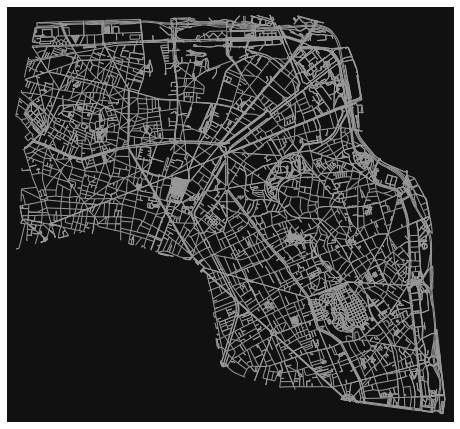

In [104]:
fig, ax = ox.plot_graph(newG)

In [105]:
newG

In [106]:
gdNotes,gdStreets = ox.utils_graph.graph_to_gdfs(newG)

In [107]:
gdStreets

osmid                 name  \
u     v     key                                                           
0     1     0                            315818975  Rue Henri Duvernois   
      2     0                             31093720    Rue Louis Lumière   
      3     0                             85735969    Rue Louis Lumière   
      4     0               [266463585, 611974677]      Rue Louis Ganne   
1     0     0                            315818975  Rue Henri Duvernois   
...                                            ...                  ...   
11780 11781 0                            940403525                  NaN   
11783 11781 0                            940403523                  NaN   
11798 11793 0    [948624025, 948624026, 948624022]                  NaN   
11801 11800 0                            949217360                  NaN   
11802 11800 0                            949217359                  NaN   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11780 11781 0             footway      NaN   False    3.772   
11783 11781 0             footway      NaN   False  103.066   
11798 11793 0    [steps, footway]      NaN   False   11.596   
11801 11800 0             service      NaN   False   12.733   
11802 11800 0             service      NaN   False   14.452   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11780 11781 0      LINESTRING (2.37582 48.86381, 2.37577 48.86379)   
11783 11781 0    LINESTRING (2.37654 48.86328, 2.37624 48.86316...   
11798 11793 0    LINESTRING (2.35467 48.87559, 2.35476 48.87559...   
11801 11800 0      LINESTRING (2.38817 48.86929, 2.38824 48.86919)   
11802 11800 0    LINESTRING (2.38810 48.86928, 2.38812 48.86925...   

                 u_original  v_original  trees  ...  greenspaces  freshplaces  \
u     v     key                                 ...                             
0     1     0        125730   268675130      6  ...            3            1   
      2     0        125730  2841627108     34  ...            3            0   
      3     0        125730   244455548     25  ...            4            2   
      4     0        125730  1089076050     12  ...            3            2   
1     0     0     268675130      125730      6  ...            3            1   
...                     ...         ...    ...  ...          ...          ...   
11780 11781 0    8709472145  8709472149     27  ...            0            0   
11783 11781 0    8709472155  8709472149     49  ...            1            0   
11798 11793 0    8780635282  8780635283     21  ...            0            0   
11801 11800 0    8787276190  8787276186      8  ...            3            2   
11802 11800 0    8787276188  8787276186     13  ...            3            2   

                 lanes  tunnel junction  ref width access        service  \
u     v     key                                                            
0     1     0      NaN     NaN      NaN  NaN   NaN    NaN            NaN   
      2     0        2     NaN      NaN  NaN   NaN    Na

In [108]:
s = gdStreets.apply(lambda x: pd.Series(x['highway']),axis=1).stack()
L = list(s.unique())
L

['residential',
 'cycleway',
 'living_street',
 'footway',
 'primary',
 'tertiary',
 'trunk_link',
 'trunk',
 'service',
 'pedestrian',
 'secondary',
 'unclassified',
 'steps',
 'path',
 'secondary_link',
 'tertiary_link',
 'primary_link',
 'motorway_link',
 'track']

In [109]:
for typeStreet in L:
    gdStreets[typeStreet] = False
    gdStreets.loc[gdStreets.highway.apply(lambda x: typeStreet in x), typeStreet] = True

In [110]:
gdStreets

osmid                 name  \
u     v     key                                                           
0     1     0                            315818975  Rue Henri Duvernois   
      2     0                             31093720    Rue Louis Lumière   
      3     0                             85735969    Rue Louis Lumière   
      4     0               [266463585, 611974677]      Rue Louis Ganne   
1     0     0                            315818975  Rue Henri Duvernois   
...                                            ...                  ...   
11780 11781 0                            940403525                  NaN   
11783 11781 0                            940403523                  NaN   
11798 11793 0    [948624025, 948624026, 948624022]                  NaN   
11801 11800 0                            949217360                  NaN   
11802 11800 0                            949217359                  NaN   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11780 11781 0             footway      NaN   False    3.772   
11783 11781 0             footway      NaN   False  103.066   
11798 11793 0    [steps, footway]      NaN   False   11.596   
11801 11800 0             service      NaN   False   12.733   
11802 11800 0             service      NaN   False   14.452   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11780 11781 0      LINESTRING (2.37582 48.86381, 2.37577 48.86379)   
11783 11781 0    LINESTRING (2.37654 48.86328, 2.37624 48.86316...   
11798 11793 0    LINESTRING (2.35467 48.87559, 2.35476 48.87559...   
11801 11800 0      LINESTRING (2.38817 48.86929, 2.38824 48.86919)   
11802 11800 0    LINESTRING (2.38810 48.86928, 2.38812 48.86925...   

                 u_original  v_original  trees  ...  pedestrian  secondary  \
u     v     key                                 ...                          
0     1     0        125730   268675130      6  ...       False      False   
      2     0        125730  2841627108     34  ...       False      False   
      3     0        125730   244455548     25  ...       False      False   
      4     0        125730  1089076050     12  ...       False      False   
1     0     0     268675130      125730      6  ...       False      False   
...                     ...         ...    ...  ...         ...        ...   
11780 11781 0    8709472145  8709472149     27  ...       False      False   
11783 11781 0    8709472155  8709472149     49  ...       False      False   
11798 11793 0    8780635282  8780635283     21  ...       False      False   
11801 11800 0    8787276190  8787276186      8  ...       False      False   
11802 11800 0    8787276188  8787276186     13  ...       False      False   

                 unclassified  steps   path secondary_link tertiary_link  \
u     v     key                                                            
0     1     0           False  False  False          False         False   
      2     0           False  False  False          False         False   
      3     0      

In [111]:
Feats = ["trees","lights","fountains","greenspaces","freshplaces"] 
for feat in Feats:
    gdStreets["p"+feat] = (10000*gdStreets[feat] / gdStreets["length"]).astype(int)

In [112]:
gdStreets

osmid                 name  \
u     v     key                                                           
0     1     0                            315818975  Rue Henri Duvernois   
      2     0                             31093720    Rue Louis Lumière   
      3     0                             85735969    Rue Louis Lumière   
      4     0               [266463585, 611974677]      Rue Louis Ganne   
1     0     0                            315818975  Rue Henri Duvernois   
...                                            ...                  ...   
11780 11781 0                            940403525                  NaN   
11783 11781 0                            940403523                  NaN   
11798 11793 0    [948624025, 948624026, 948624022]                  NaN   
11801 11800 0                            949217360                  NaN   
11802 11800 0                            949217359                  NaN   

                          highway maxspeed  oneway   length  \
u     v     key                                               
0     1     0         residential       30   False    8.707   
      2     0         residential       30   False  128.700   
      3     0         residential       30   False  105.925   
      4     0         residential       30   False  124.290   
1     0     0         residential       30   False    8.707   
...                           ...      ...     ...      ...   
11780 11781 0             footway      NaN   False    3.772   
11783 11781 0             footway      NaN   False  103.066   
11798 11793 0    [steps, footway]      NaN   False   11.596   
11801 11800 0             service      NaN   False   12.733   
11802 11800 0             service      NaN   False   14.452   

                                                          geometry  \
u     v     key                                                      
0     1     0      LINESTRING (2.41073 48.86352, 2.41083 48.86348)   
      2     0    LINESTRING (2.41073 48.86352, 2.41046 48.86425...   
      3     0    LINESTRING (2.41073 48.86352, 2.41077 48.86337...   
      4     0    LINESTRING (2.41073 48.86352, 2.41061 48.86351...   
1     0     0      LINESTRING (2.41083 48.86348, 2.41073 48.86352)   
...                                                            ...   
11780 11781 0      LINESTRING (2.37582 48.86381, 2.37577 48.86379)   
11783 11781 0    LINESTRING (2.37654 48.86328, 2.37624 48.86316...   
11798 11793 0    LINESTRING (2.35467 48.87559, 2.35476 48.87559...   
11801 11800 0      LINESTRING (2.38817 48.86929, 2.38824 48.86919)   
11802 11800 0    LINESTRING (2.38810 48.86928, 2.38812 48.86925...   

                 u_original  v_original  trees  ...  secondary_link  \
u     v     key                                 ...                   
0     1     0        125730   268675130      6  ...           False   
      2     0        125730  2841627108     34  ...           False   
      3     0        125730   244455548     25  ...           False   
      4     0        125730  1089076050     12  ...           False   
1     0     0     268675130      125730      6  ...           False   
...                     ...         ...    ...  ...             ...   
11780 11781 0    8709472145  8709472149     27  ...           False   
11783 11781 0    8709472155  8709472149     49  ...           False   
11798 11793 0    8780635282  8780635283     21  ...           False   
11801 11800 0    8787276190  8787276186      8  ...           False   
11802 11800 0    8787276188  8787276186     13  ...           False   

                 tertiary_link  primary_link  motorway_link  track ptrees  \
u     v     key                                                             
0     1     0            False         False          False  False   6891   
      2     0            False         False          False  False   2641   
      3     0            False         False          False  False   2360   
      4     0            Fals

In [113]:
newG = ox.utils_graph.graph_from_gdfs(gdNotes,gdStreets)
saveGraph(newG,"Gf")